- elab camp 用

In [1]:
import numpy as np
import pandas as pd
import json
import gensim
import collections
import matplotlib.pyplot as plt
import pprint
import itertools
import seaborn as sns
import networkx as nx
from IPython.display import display_svg
import tqdm
%matplotlib inline

In [2]:
with open("./lt.json", "r") as f:
    raw_lt = json.load(f)

In [3]:
lt_per_cat = {}
for ltid, value in raw_lt.items():
    if value['cat'] not in lt_per_cat:
        lt_per_cat[value['cat']] = [value['lt']]
    else:
        lt_per_cat[value['cat']].append(value['lt'])

In [4]:
def remove_symbols(value):
    return value.replace("'",'').replace('>','').replace('<','').replace('=','').replace('(', '').replace(')', '').replace('[', '').replace(']', '').replace('**', '').replace(':', '').replace(',', '').replace("_", " ")

def string_to_corpus(lt, max_len=None):
    words = [remove_symbols(t) for t in lt.split()]
    split_words = []
    for w in words:
        if len(w.split()) > 1: # さらに分割できる場合
            split_words.extend(w.split())
        else:
            split_words.append(w)
    split_words = [t.lower() for t in split_words if t != '']
    if max_len != None:
        split_words = split_words[:max_len] # 前方のみ残す

    return split_words

In [5]:
all_corpus = dict()
for cat, lts in lt_per_cat.items():
    corpus = []
    for lt in lts:
        words = [remove_symbols(t) for t in lt.split()]
        split_words = []
        for w in words:
            if len(w.split()) > 1: # さらに分割できる場合
                split_words.extend(w.split())
            else:
                split_words.append(w)
        split_words = [t.lower() for t in split_words if t != '']
        corpus.extend(split_words)
    all_corpus[cat] = corpus

In [6]:
all_words = list(set([word for cat, words in all_corpus.items() for word in words]))
word_dict = {w:i for i, w in enumerate(all_words)}
inv_word_dict = {v:k for k,v in word_dict.items()}

corpus = []
for cat, lts in lt_per_cat.items():
    for lt in lts:
        words = [remove_symbols(t) for t in lt.split()]
        split_words = []
        for w in words:
            if len(w.split()) > 1: # さらに分割できる場合
                split_words.extend(w.split())
            else:
                split_words.append(w)
        split_words = [t.lower() for t in split_words if t != '']
        
        split_words = split_words[:7] # 前方のみ残す
        
        lt_word_id_cnt = collections.Counter([word_dict[w] for w in split_words])
        
        corpus.append([(tid, cnt) for tid, cnt in lt_word_id_cnt.items()])

In [7]:
# 単語のカウント
word_cnt = {}
for wid, cnt in sorted(collections.Counter([c[0] for s in corpus for c in s]).items(), key= lambda x: x[1])[::-1]:
    print(inv_word_dict[wid], cnt)
    word_cnt[inv_word_dict[wid]] = cnt

ui 543
user 537
mgd 505
cfg 470
audit 466
rpd 374
set 324
other 257
event 198
index 174
broadcast 162
delete 136
up 110
multicast 104
/kernel 92
mpls 85
lsp 83
to 80
evt 62
from 61
init 60
updown 55
login 55
bgp 53
for 51
mtu 46
chassisd 42
alarm 41
task 41
file 41
pic 41
change 41
trap 40
error 40
address 40
read 39
received 39
mcsn 39
sent 38
port 38
is 38
add 36
snmp 36
notification 36
on 36
failed 34
xntpd 34
pointtopoint 32
cmd 31
class 30
pid 29
down 28
deactivate 28
status 28
bandwidth 27
- 27
message 27
neighbor 26
signal 26
state 26
link 25
cleared 25
junoscript 24
of 24
connection 24
info 24
alarmd 23
craftd 23
generated 23
luchip 23
peer 23
switch 22
reinitializing 22
used 22
slot 22
activate 21
pci 21
not 21
color 20
pfe 20
recv 19
master 19
terminate 19
bulkget 18
chas 18
pfeman 18
system 18
config 18
sshd 18
libjsnmp 17
as 17
no 17
time 17
re 16
secret 16
active 16
rsp 16
interface 16
realm 15
ospf 15
snmpd 15
lu 15
fpc 15
with 15
major 15
by 15
failure 15
rsvp 14
mac 14


In [ ]:
# LTレベルの共起
cor_df = pd.DataFrame(index=np.arange(len(word_dict)), columns=np.arange(len(word_dict)), dtype=int)
cor_df = cor_df.fillna(0)

for s in corpus:
    for a,b in itertools.combinations(s, 2):
        ida = int(a[0])
        idb = int(b[0])
        cor_df[ida][idb] += 1
        cor_df[idb][ida] += 1

cor_list = []
for a,b in itertools.combinations(np.arange(len(word_dict)), 2):
    if cor_df[a][b] != 0 :
        cor_list.append([(a, b) , cor_df[a][b]])
        
for i in tqdm.tqdm(sorted(cor_list, key=lambda x:x[1], reverse=True)):
    a,b = i[0]
    print(inv_word_dict[a], inv_word_dict[b], i[1])
    print("\t simpson:", i[1]/min(word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]]))
    print("\t jaccard:", i[1]/(word_cnt[inv_word_dict[a]] + word_cnt[inv_word_dict[b]] - i[1]))
    print()

In [ ]:
G = nx.DiGraph()
nx.set_node_attributes

for i in sorted(cor_list, key=lambda x:x[1], reverse=True):
    if i[1] > 9: # 共起が10回以上
        a,b = i[0]
        simpson = i[1]/min(word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]])
        jaccard = i[1]/(word_cnt[inv_word_dict[a]] + word_cnt[inv_word_dict[b]] - i[1])
        
        print(simpson)
        if simpson > 0.7:
            if a not in G.nodes:
                G.add_node(inv_word_dict[a])

            if b not in G.nodes:
                G.add_node(inv_word_dict[b])

            src = inv_word_dict[a] if np.argmin([word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]]]) == 0 else inv_word_dict[b]
            dst = inv_word_dict[a] if src == inv_word_dict[b] else inv_word_dict[b]
            G.add_edge(src, dst, weight=jaccard)

In [ ]:
json_data = nx.node_link_data(G)
f = open("nx.json", "w")
json.dump(json_data, f, ensure_ascii=False, indent=4, sort_keys=True, separators=(',', ': '))
f.close()

In [ ]:
plt.figure(figsize=(13, 13))
nx.draw_networkx(G, pos=nx.shell_layout(G))
plt.show()

## LDA

- __getItem__での結果は，inference(collect_stats=True)の結果をノーマライズしたものっぽい

In [8]:
for cat, lts in lt_per_cat.items():
    print(cat)

system(cron)
network(lacp)
service(ntp)
monitor(syslog)
network(mtu)
mgmt(login)
system(ui)
mgmt(command)
mgmt(ssh)
network(l2)
system(unix)
network(storm)
system(pic)
network(pfe)
system(ppe)
mgmt(pam)
mgmt(su)
egp(bgp)
network(mld)
system(fpc)
network(arp)
interface(port)
mgmt(config)
interface(agg)
monitor(snmp)
interface(if_event)
interface(vlan)
mgmt(enable)
vpn(mpls)
network(stp)
igp(ospf)
network(rsvp)
vpn(l2vc)
vpn(vpls)
network(tcp)
system(fan)
mgmt(ftp)
network(sfp)
system(power)
system(system_conf)
network(socket)
system(tnp)
system(alarm)
system(gres)
network(pim)
egp(msdp)
interface(interface)
system(others)
system(config_apply)
mgmt(config_process)
network(routing)
mgmt(ui_error)
system(None)
system(cos)
system(ppm)
monitor(bfd)
system(lisence)
network(icmp)
system(csu)
system(boot)
system(pci)
interface(inet6)
network(lldp)
network(mcsnoop)


In [167]:
tmp = []
eval_corpus = []
eval_corpus_ltids = []
for ltid, i in enumerate(corpus):
    if word_dict['ui'] not in [j[0] for j in i]: # uiを弾く(550番)
        tmp.append(tuple(sorted(i)))
        eval_corpus.append(i)
        eval_corpus_ltids.append(ltid)
    
print(len(tmp))
set_corpus = list(set(tmp))

1246


In [312]:
lda = gensim.models.ldamodel.LdaModel(
                                      #corpus=corpus, 
                                      corpus=set_corpus,
                                      chunksize=2,
                                      num_topics=40, 
                                      id2word=inv_word_dict, 
                                      minimum_probability=1e-8, 
                                      #gamma_threshold=1e-5,
#                                       eval_every=1,
                                      iterations=400,
#                                       alpha='auto', 
#                                       eta='auto', 
                                      decay=1.0,
                                      passes=1,
#                                      update_every=0,
#                                       random_state=10,
                                      per_word_topics=True)

In [412]:
inf_topic_words = {}
for topic in range(lda.num_topics):
    print(topic, [inv_word_dict[i[0]] for i in lda.get_topic_terms(topic)])
    inf_topic_words[topic] = [inv_word_dict[i[0]] for i in lda.get_topic_terms(topic)]

0 ['error', 'status', 'pci', 'xntpd', 'changed', 'time', 'vlan', 'inetd', 'kernel', 'exited']
1 ['pfe', 'cmtfpc', 'dropped', 'due', 'bypass', 'asic', 'rt', 'idpd', 'check', 'normal']
2 ['snmpd', 'trap', 'send', 'failure', 'sa', 'mib2d', 'snmp', 'queue', 'partial', 'vccpd']
3 ['task', 'reinitializing', 'reinit', 'done', 'reconfigure', '+', 'l2cp', 'lldpd', 'lldp', 'cfmd']
4 ['set', 'rsp', 'interface', 'the', 'duplicate', 'exceeded', 'cant', 'mode', 'because', 'enable']
5 ['pio', 'create', 'trinity', 'errors', 'jspec', 'last', 'cannot', 'v', 'max', 'occurred']
6 ['msg', 'storm', 'ifd', 'setting', 'bd', 'calling', 'handle', 'mvlan', 'snooping', 'console']
7 ['login', 'access', 'host', 'user', 'configuration', 'incorrect', 'show', 'number', 'attempt', 'proto']
8 ['/usr/sbin/cron', 'cmd', 'root', 'license-check', 'newsyslog', 'libjnx', 'rcp', 'copy', '-l', '-a']
9 ['plane', 'ksyncd', 'control', 'rhost', 'select', 'replicated', '4way', 'pools', 'mem', 'jnh']
10 ['-x', 'mgd', '/usr/libexec/ui

In [314]:
t = []
for lt in lt_per_cat["service(ntp)"]:                
    c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
    topic_dist, word_topic, word_topic_dist = lda[c]
    inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
    t.append(inf_topic)
    
for k,v in collections.Counter(t).items():
    print(k,"\t",v)
    
print("alarm")
t = []
for lt in lt_per_cat["system(alarm)"]:
    c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
    topic_dist, word_topic, word_topic_dist = lda[c]
    inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
    t.append(inf_topic)
    
for k,v in collections.Counter(t).items():
    print(k,"\t",v)

0 	 26
29 	 4
4 	 2
26 	 2
15 	 1
alarm
34 	 45


In [126]:
results = []
for cs in range(1, 20):
    for i in range(10):
        lda = gensim.models.ldamodel.LdaModel(
                                              corpus=set_corpus,
                                              chunksize=cs,
                                              num_topics=50, 
                                              id2word=inv_word_dict, 
                                              minimum_probability=1e-8, 
                                              iterations=800,
                                              decay=1.0,
                                              passes=1,
                                              per_word_topics=True)

        res = []
        for lt in lt_per_cat["service(ntp)"]:                
            c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
            topic_dist, word_topic, word_topic_dist = lda[c]
            inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
            res.append(inf_topic)
        results.append((cs, i, res))

/home/otomo/.pyenv/versions/3.6.1/lib/python3.6/site-packages/gensim/models/ldamodel.py:579: RuntimeWarning:

divide by zero encountered in double_scalars



In [134]:
for cs,i,r in results:
    e = entropy(list(collections.Counter(r).values()))
    if e < 0.8:
        print("ChunkSize=", cs, "\t", i)
        print("\t", collections.Counter(r))
        print("\t entropy:", entropy(list(collections.Counter(r).values())))
        print()

ChunkSize= 1 	 2
	 Counter({49: 31, 42: 2, 24: 2})
	 entropy: 0.4345997168814333

ChunkSize= 1 	 5
	 Counter({41: 30, 8: 2, 38: 2, 10: 1})
	 entropy: 0.5608191994292867

ChunkSize= 1 	 6
	 Counter({19: 30, 18: 2, 47: 2, 49: 1})
	 entropy: 0.5608191994292867

ChunkSize= 1 	 9
	 Counter({4: 27, 46: 4, 11: 2, 39: 2})
	 entropy: 0.7751948743798072

ChunkSize= 2 	 4
	 Counter({9: 30, 19: 2, 5: 2, 33: 1})
	 entropy: 0.5608191994292867

ChunkSize= 2 	 6
	 Counter({18: 27, 27: 4, 24: 2, 11: 2})
	 entropy: 0.7751948743798072

ChunkSize= 2 	 9
	 Counter({5: 27, 37: 4, 45: 2, 14: 2})
	 entropy: 0.7751948743798072

ChunkSize= 3 	 1
	 Counter({43: 27, 1: 4, 24: 2, 36: 2})
	 entropy: 0.7751948743798072

ChunkSize= 17 	 4
	 Counter({43: 23, 16: 12})
	 entropy: 0.6429124396658009

ChunkSize= 17 	 8
	 Counter({18: 23, 11: 12})
	 entropy: 0.6429124396658009



In [ ]:
results =  [np.argmax(l) for l in lda.inference(eval_corpus)[0]]

inference_results = {}
for a,b in zip(eval_corpus, results):
    if b in inference_results:
        inference_results[b].append([inv_word_dict[c[0]] for c in a])
    else:
        inference_results[b] = [[inv_word_dict[c[0]] for c in a]]

### eval

- 外れたやつについて，調査

In [48]:
for a,b in lt_per_cat.items():
    print(a, len(b))

system(cron) 8
network(lacp) 6
service(ntp) 35
monitor(syslog) 4
network(mtu) 26
mgmt(login) 38
system(ui) 41
mgmt(command) 24
mgmt(ssh) 18
network(l2) 15
system(unix) 35
network(storm) 6
system(pic) 35
network(pfe) 47
system(ppe) 6
mgmt(pam) 3
mgmt(su) 4
egp(bgp) 56
network(mld) 1
system(fpc) 76
network(arp) 6
interface(port) 10
mgmt(config) 491
interface(agg) 36
monitor(snmp) 80
interface(if_event) 133
interface(vlan) 6
mgmt(enable) 2
vpn(mpls) 85
network(stp) 12
igp(ospf) 15
network(rsvp) 14
vpn(l2vc) 2
vpn(vpls) 2
network(tcp) 4
system(fan) 2
mgmt(ftp) 4
network(sfp) 9
system(power) 8
system(system_conf) 1
network(socket) 6
system(tnp) 6
system(alarm) 45
system(gres) 7
network(pim) 4
egp(msdp) 10
interface(interface) 5
system(others) 6
system(config_apply) 2
mgmt(config_process) 1
network(routing) 4
mgmt(ui_error) 5
system(None) 228
system(cos) 10
system(ppm) 3
monitor(bfd) 3
system(lisence) 4
network(icmp) 2
system(csu) 6
system(boot) 4
system(pci) 17
interface(inet6) 1
network(ll

In [ ]:
for i in range(len(word_dict)):
    print(inv_word_dict[i], lda.get_term_topics(i))

In [650]:
word_dict['unreachable']

303

In [315]:
# inf_per_cat = {}
for cat,lts in lt_per_cat.items():
    
    if cat == "service(ntp)" or cat == "system(alarm)" or cat == "egp(bgp)" or cat == "network(mtu)":
        print(cat)
#     inf_per_cat[cat] = []
        for lt in lts:
            c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
            topic_dist, word_topic, word_topic_dist = lda[c]
            inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
#             inf_per_cat[cat].append(inf_topic)
            print("\t", inf_topic, ",", lt)
    #         print()

service(ntp)
	 0 , xntpd[**]: NTP Server Unreachable
	 0 , xntpd[**]: kernel time sync enabled **
	 29 , xntpd[**]: synchronized to **, stratum=**
	 0 , xntpd[**]: ntpd exiting on signal **
	 0 , xntpd[**]: ntpd ** ** ** ** ** ** ** (**)
	 0 , xntpd[**]: precision = ** usec
	 4 , xntpd[**]: Listening on interface **, **#**
	 0 , xntpd[**]: kernel time sync status **
	 26 , xntpd[**]: frequency initialized ** PPM from **
	 0 , xntpd[**]: kernel time sync disabled **
	 0 , xntpd[**]: time reset +** s
	 0 , xntpd[**]: no servers reachable
	 0 , ** xntpd[**]: NTP Server Unreachable
	 29 , ** xntpd[**]: synchronized to **, stratum=**
	 0 , ** xntpd: NTPD_CHANGED_TIME: time reset +** s
	 0 , ** xntpd[**]: time reset +** s
	 0 , ** xntpd: kernel time sync disabled **
	 29 , ** xntpd: synchronized to **, stratum=**
	 0 , ** xntpd: kernel time sync enabled **
	 0 , ** xntpd: NTP Server Unreachable
	 15 , xntpd[**]: mlockall(): Resource temporarily unavailable
	 0 , ** xntpd[**]: ntpd exiting on

In [316]:
lt_vecs = {}
for cat,lts in lt_per_cat.items():
    for lt in lts:
        c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
        topic_dist, word_topic, word_topic_dist = lda[c]
        topic_vec = np.array([t[1] for t in  topic_dist])
        lt_vecs[lt] = topic_vec

In [74]:
from sklearn.manifold import TSNE

x = np.array(list(lt_vecs.values()))
tsne = TSNE(
    n_components=3, #ここが削減後の次元数です．
    init='random',
    random_state=101,
    method='barnes_hut',
    n_iter=800,
    verbose=2
).fit_transform(x)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1789 samples in 0.003s...
[t-SNE] Computed neighbors for 1789 samples in 0.268s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1789
[t-SNE] Computed conditional probabilities for sample 1789 / 1789
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.207s
[t-SNE] Iteration 50: error = 70.2509003, gradient norm = 0.0742192 (50 iterations in 6.697s)
[t-SNE] Iteration 100: error = 59.7897873, gradient norm = 0.0121296 (50 iterations in 3.490s)
[t-SNE] Iteration 150: error = 58.0704460, gradient norm = 0.0075250 (50 iterations in 3.195s)
[t-SNE] Iteration 200: error = 57.4071083, gradient norm = 0.0048800 (50 iterations in 3.141s)
[t-SNE] Iteration 250: error = 57.0802116, gradient norm = 0.0061058 (50 iterations in 3.169s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.080212
[t-SNE] Iteration 300: error = 0.4731968, gradient norm = 0.0004404 (50 iterations in 3.195s)

In [75]:
lt_cat = {vv:k.split('(')[0]  for k,v in  lt_per_cat.items() for vv in v}
cats = [lt_cat[k] for k in list(lt_vecs.keys())]

In [76]:
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()

from sklearn import preprocessing

le = preprocessing.LabelEncoder()
colors = le.fit_transform(cats)

# 3Dの散布図が作れるScatter3dを使います．
trace1 = go.Scatter3d(
    x=tsne[:,0], # それぞれの次元をx, y, zにセットするだけです．
    y=tsne[:,1],
    z=tsne[:,2],
    mode='markers',
    text=list(lt_vecs.keys()),
    marker=dict(
        sizemode='diameter',
        color = colors,
        colorscale = 'Portland',
        colorbar=dict(
            title='Colorbar',
            tickvals = np.arange(len(le.classes_)),
            ticktext = le.classes_
        ),
        line=dict(color='rgb(255, 255, 255)'),
        opacity=0.9,
        size=2 # ごちゃごちゃしないように小さめに設定するのがオススメです．
    )
)

data=[trace1]
layout=dict(height=1000, width=900, title='Log Template Vectors')
fig=dict(data=data, layout=layout)
offline.iplot(fig, filename='tsne_example')

In [452]:
from sklearn.manifold import TSNE

x = np.array(list(lt_vecs.values()))
tsne2d = TSNE(
    n_components=2, #ここが削減後の次元数です．
    init='random',
    random_state=101,
    method='barnes_hut',
    n_iter=1000,
    verbose=2
).fit_transform(x)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1789 samples in 0.003s...
[t-SNE] Computed neighbors for 1789 samples in 0.248s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1789
[t-SNE] Computed conditional probabilities for sample 1789 / 1789
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.205s
[t-SNE] Iteration 50: error = 71.2747269, gradient norm = 0.1151922 (50 iterations in 1.838s)
[t-SNE] Iteration 100: error = 62.0818443, gradient norm = 0.0323737 (50 iterations in 1.334s)
[t-SNE] Iteration 150: error = 59.7803116, gradient norm = 0.0304466 (50 iterations in 1.294s)
[t-SNE] Iteration 200: error = 58.7637596, gradient norm = 0.0184625 (50 iterations in 1.270s)
[t-SNE] Iteration 250: error = 58.2063141, gradient norm = 0.0146449 (50 iterations in 1.263s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.206314
[t-SNE] Iteration 300: error = 0.5743129, gradient norm = 0.0008224 (50 iterations in 1.285s)

In [454]:
lt_cat = {vv:k.split('(')[0]  for k,v in  lt_per_cat.items() for vv in v}
cats = [lt_cat[k] for k in list(lt_vecs.keys())]

In [455]:
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()

le = preprocessing.LabelEncoder()
colors = le.fit_transform(cats)

trace2 = go.Scatter(
    x=tsne2d[:,0],
    y=tsne2d[:,1],
    mode='markers',
    text=list(lt_vecs.keys()),
    marker=dict(
        sizemode='diameter',
        color = colors,
        colorscale = 'Portland',
        colorbar=dict(
            title='Colorbar',
            tickvals = np.arange(len(le.classes_)),
            ticktext = le.classes_
        ),
        line=dict(color='rgb(255, 255, 255)'),
        opacity=0.9,
        size=5
    )
)

data=[trace2]
layout=dict(height=800, width=800, title='Log Template Vectors')
fig=dict(data=data, layout=layout)
offline.iplot(fig, filename='tsne_example')

In [317]:
vecs_df = pd.DataFrame(columns=["lt","v"], index=np.arange(len(lt_vecs)))

In [318]:
i = 0
for k,v in lt_vecs.items():
    vecs_df['lt'][i] = k
    vecs_df['v'][i] = list(v)
    i+=1

In [319]:
for cat,lts in lt_per_cat.items():
    
    for lt in lts:
        c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
        topic_dist, word_topic, word_topic_dist = lda[c]
        inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
        
        vecs_df.loc[vecs_df['lt']==lt, 'gt'] = cat
        vecs_df.loc[vecs_df['lt']==lt, 'tm'] = inf_topic


**:rpd[**]: RPD_MPLS_PATH_DOWN: MPLS path ** down on LSP **
(array([11, 22]),)


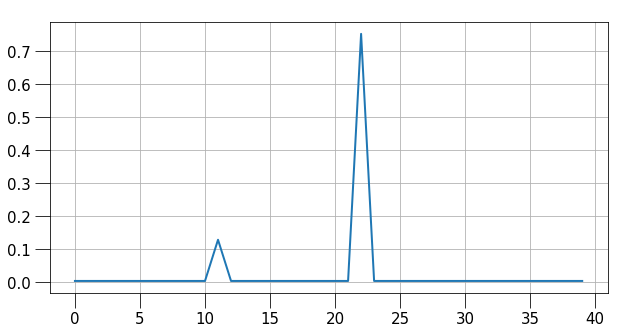

**:rpd[**]: RPD_MPLS_LSP_DOWN: MPLS LSP ** down on primary(**)
(array([11, 22]),)


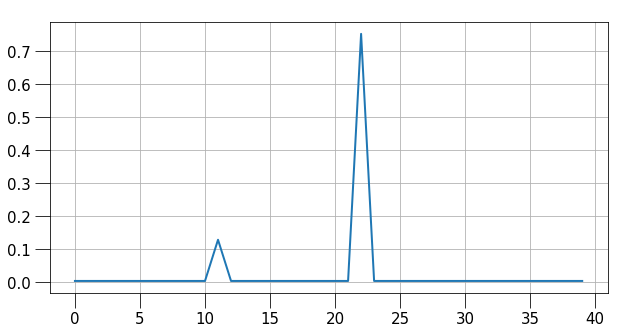

**:rpd[**]: RPD_MPLS_PATH_UP: MPLS path ** up on LSP ** path bandwidth ** bps
(array([22, 23]),)


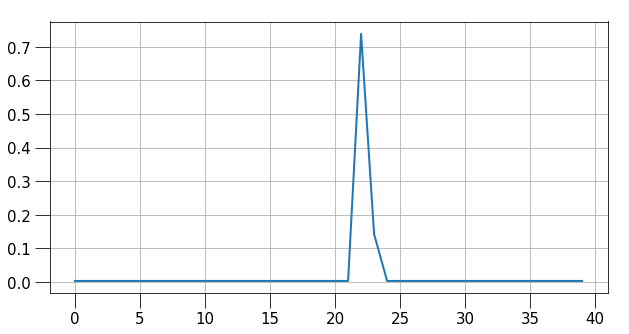

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


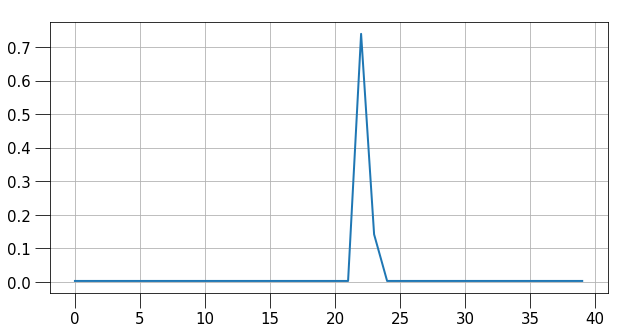

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


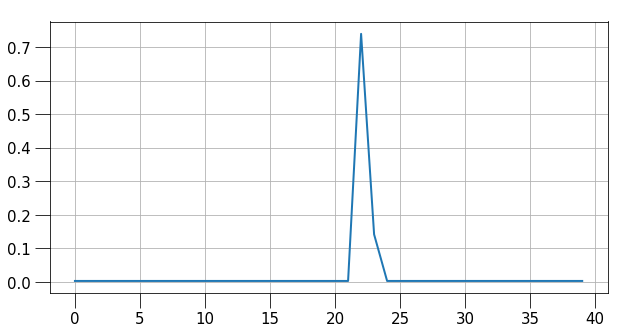

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


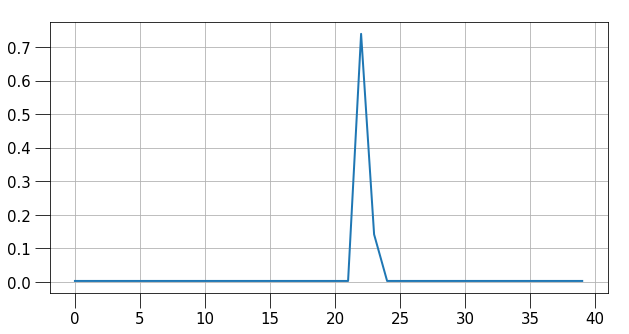

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


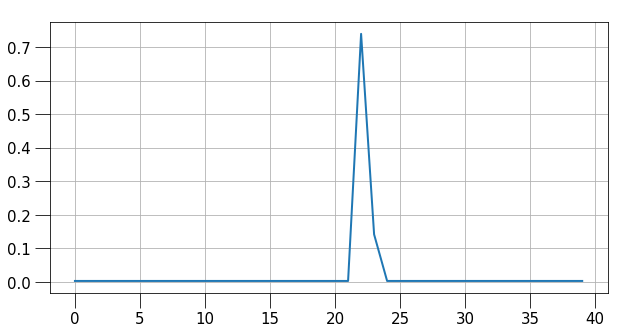

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


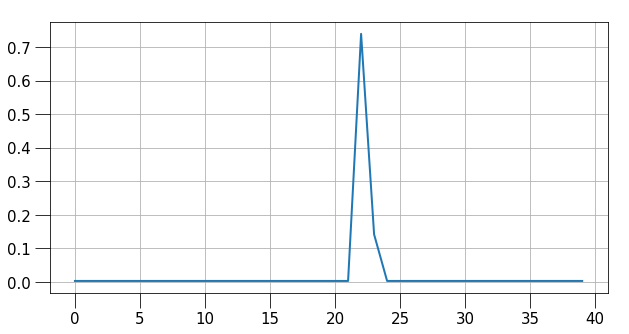

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


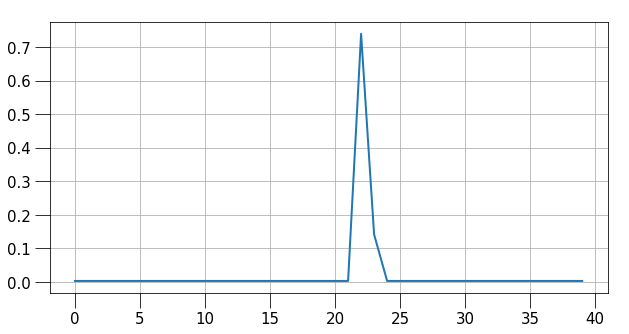

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


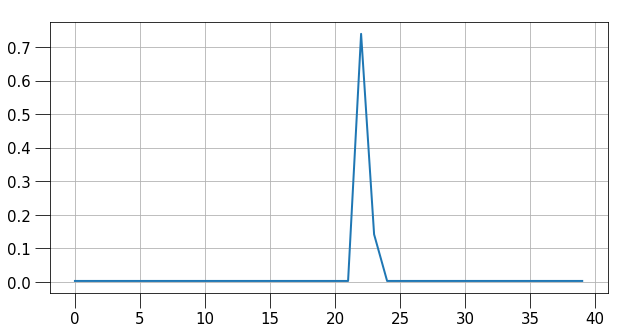

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


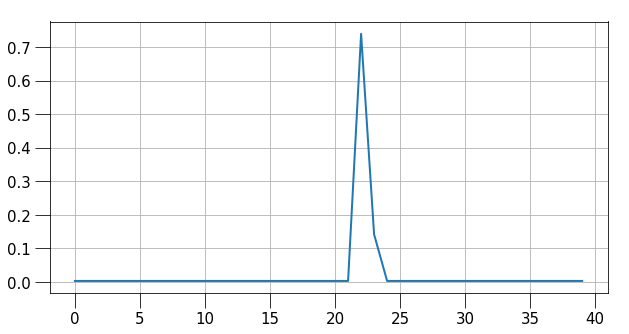

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


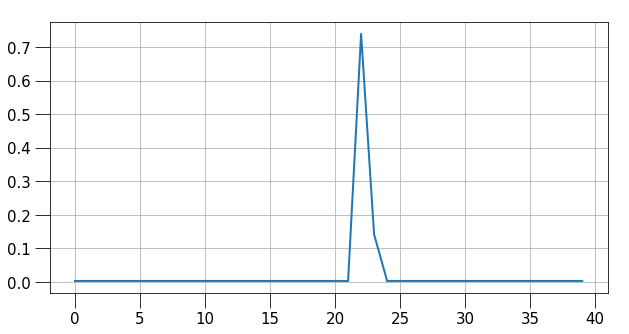

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


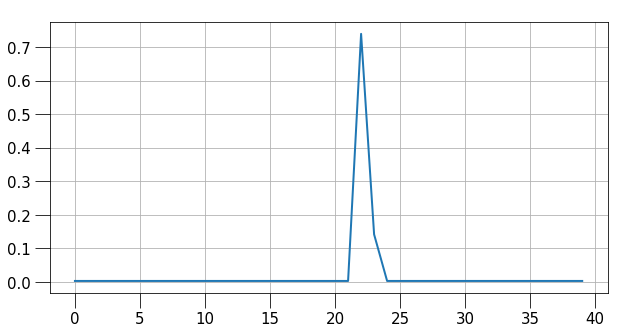

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


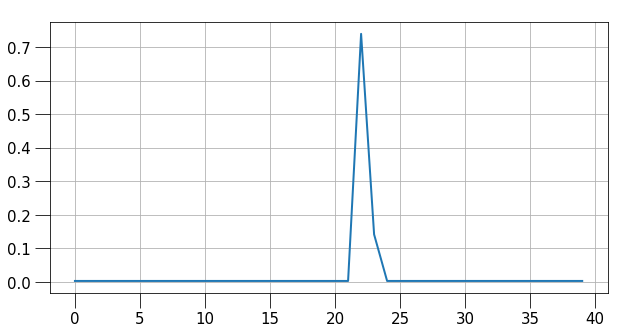

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


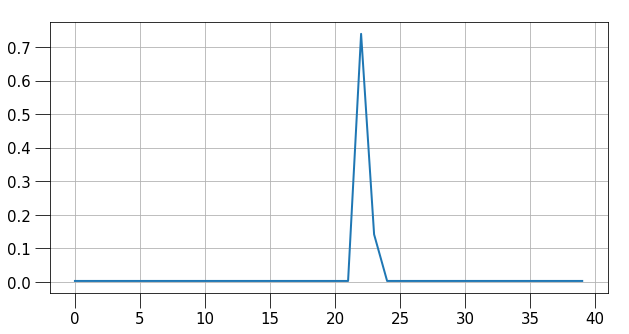

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


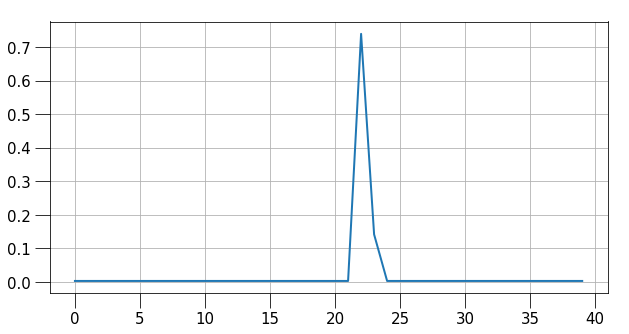

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


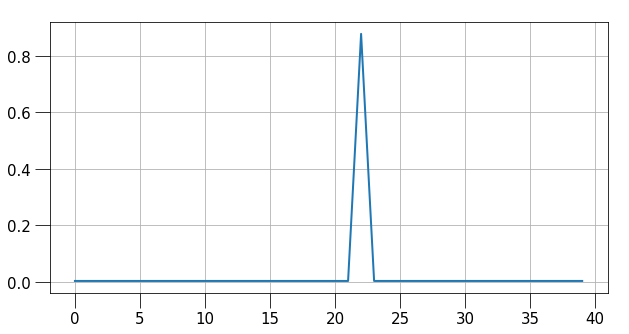

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


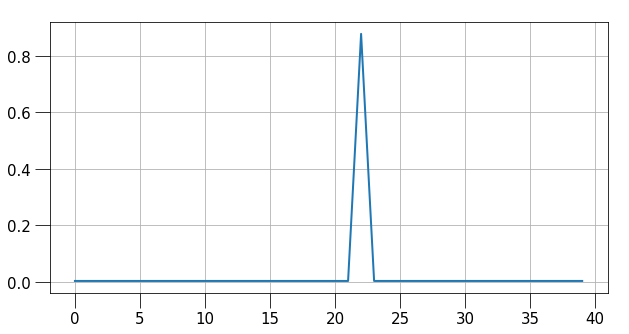

**:rpd[**]: RPD_MPLS_LSP_DOWN: MPLS LSP ** down on secondary(**)
(array([11, 22]),)


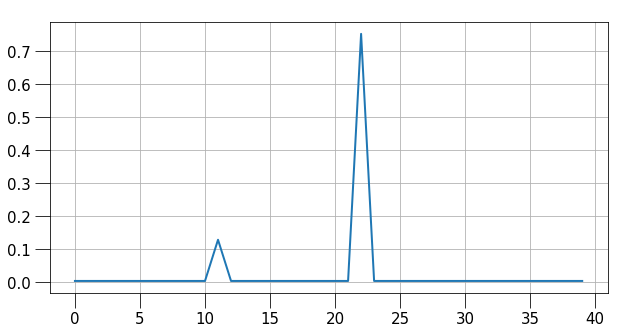

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


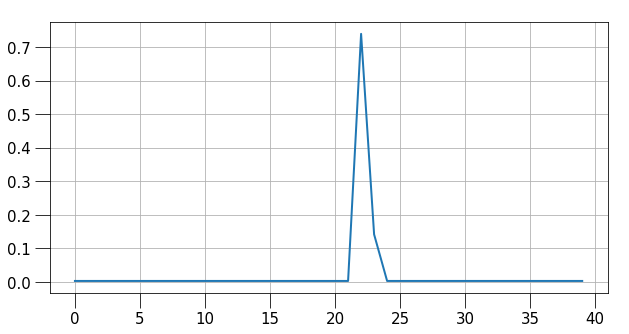

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


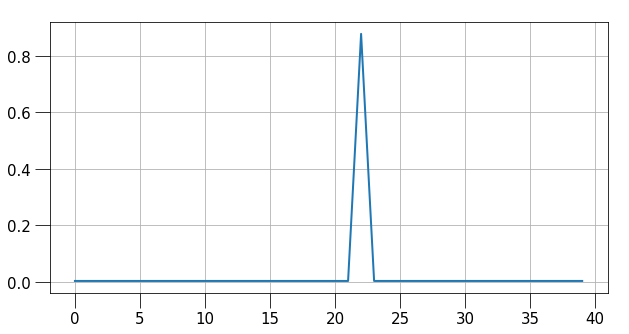

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


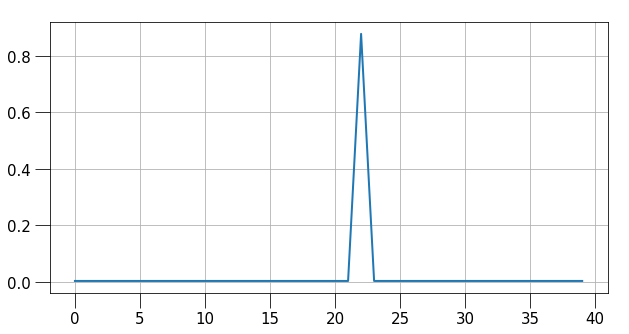

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


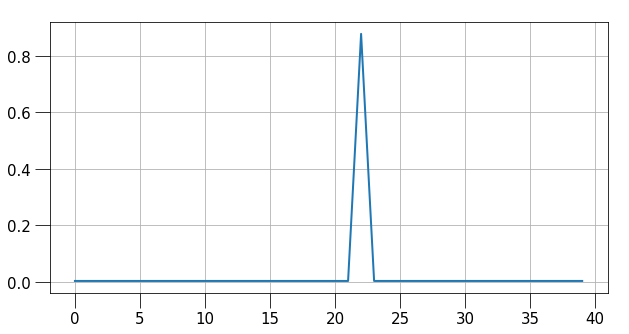

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


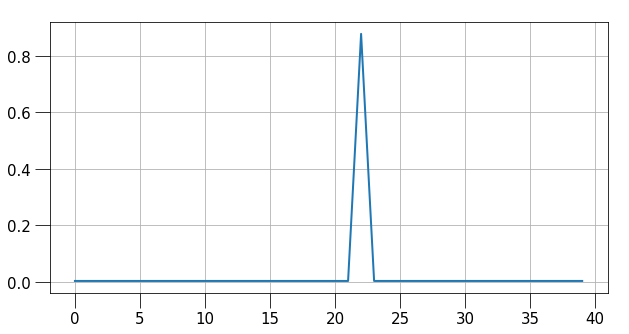

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


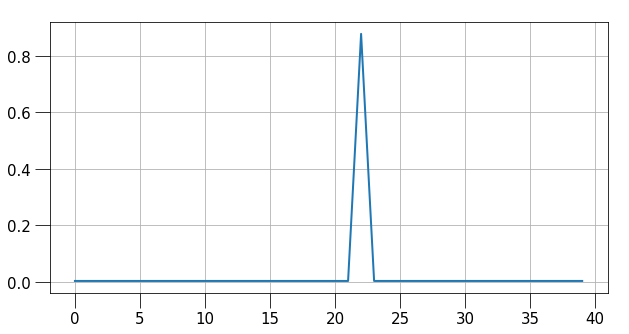

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


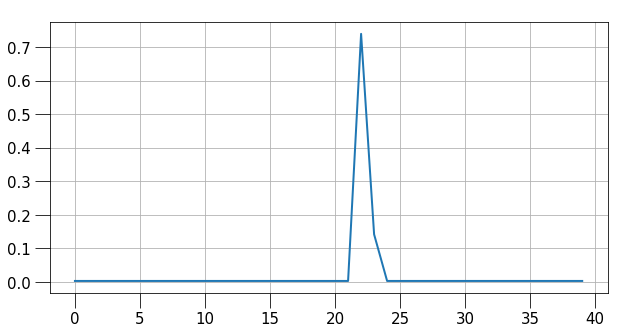

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


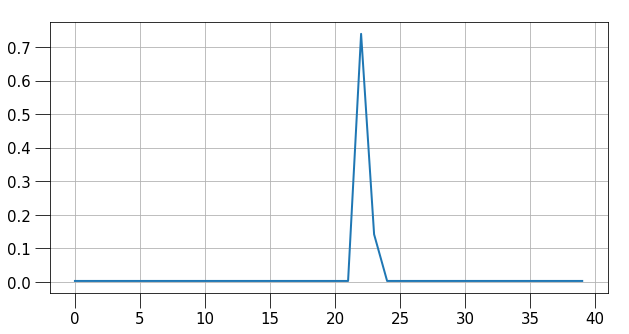

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


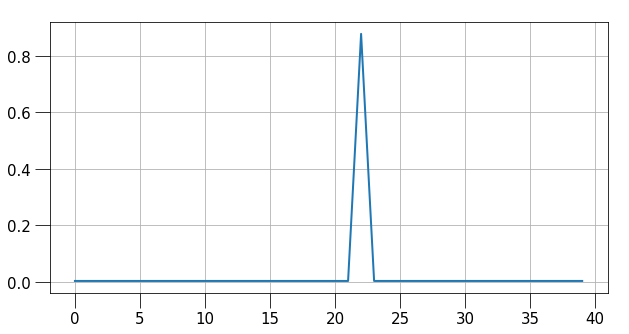

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


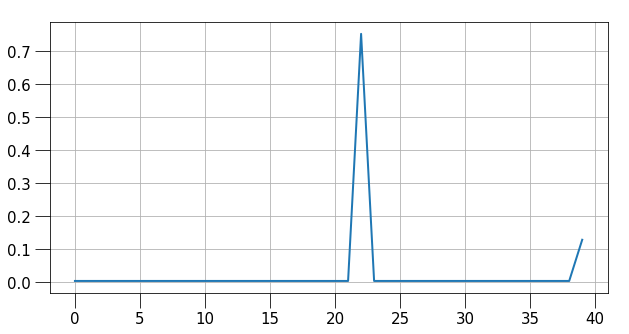

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) ** **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


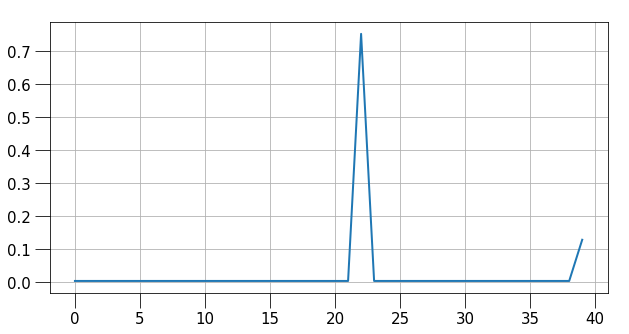

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route ** **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


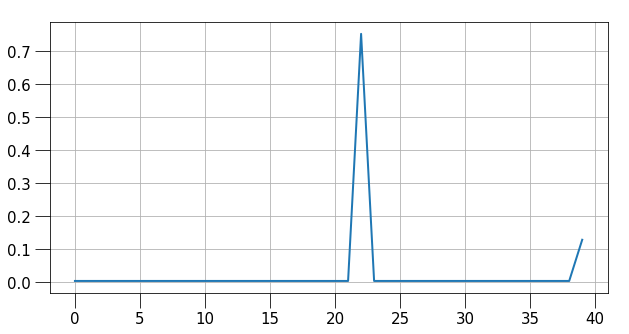

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route ** **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


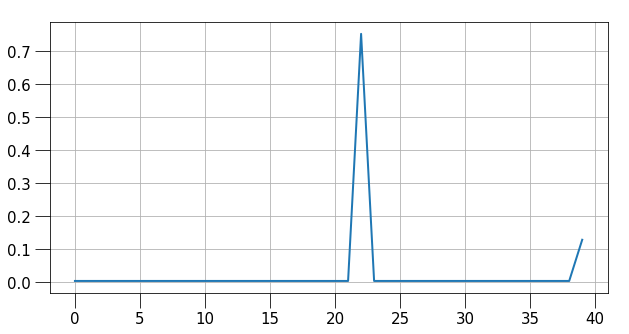

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route ** **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


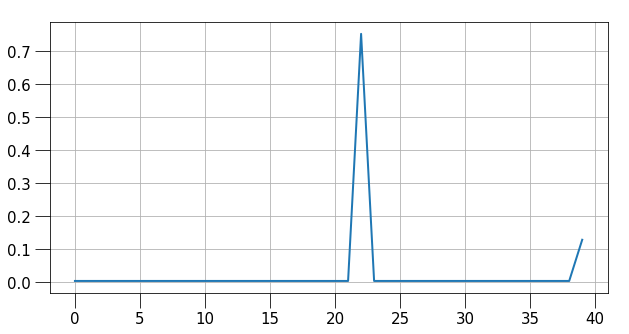

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


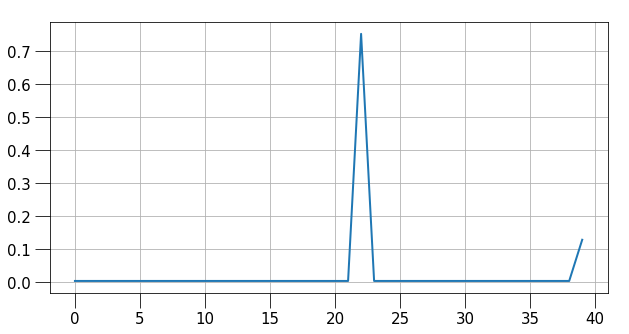

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


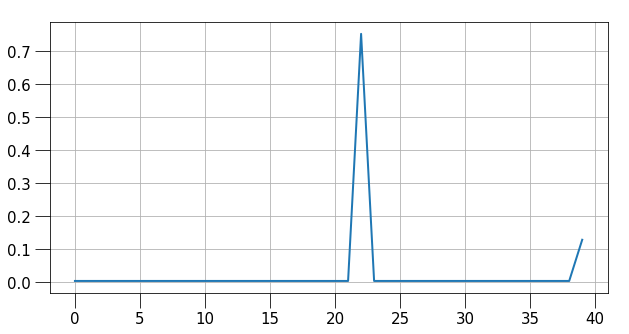

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


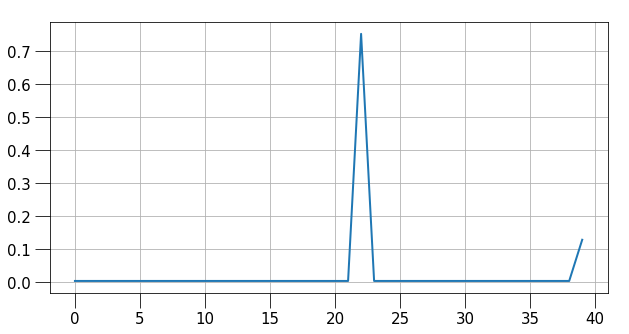

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


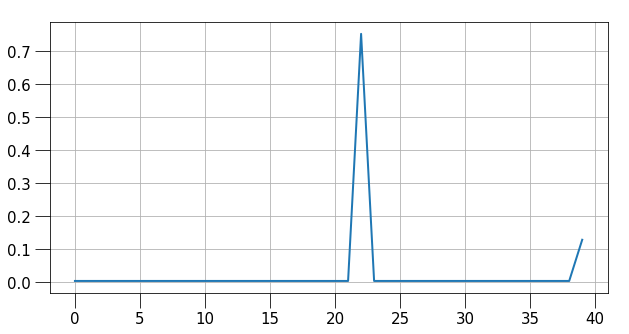

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


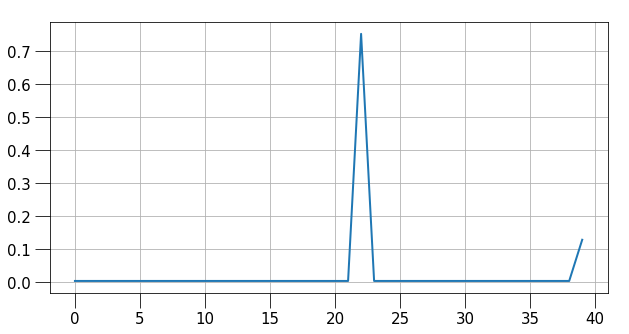

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


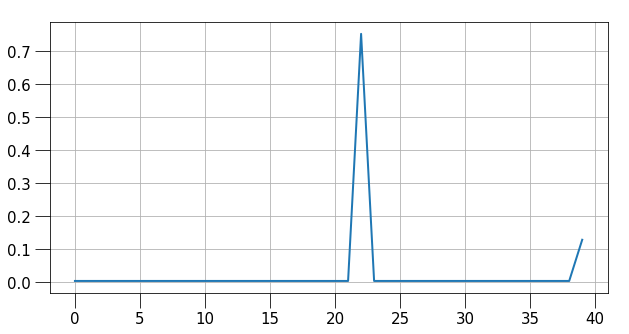

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


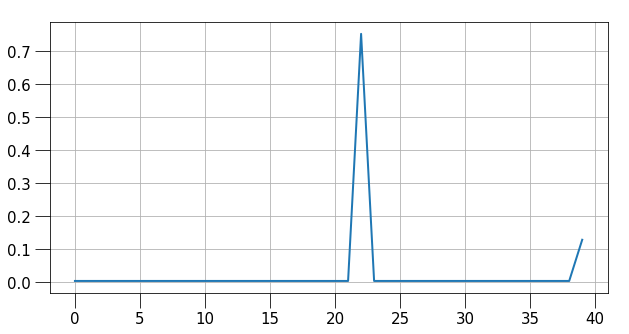

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


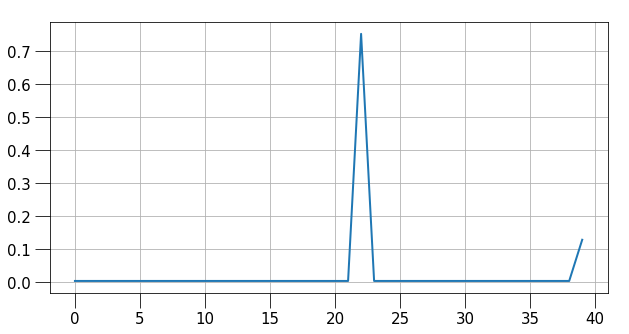

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


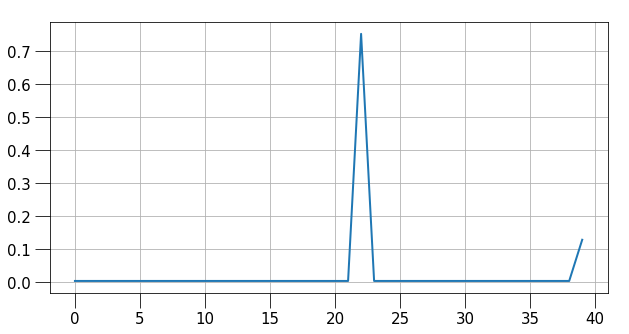

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


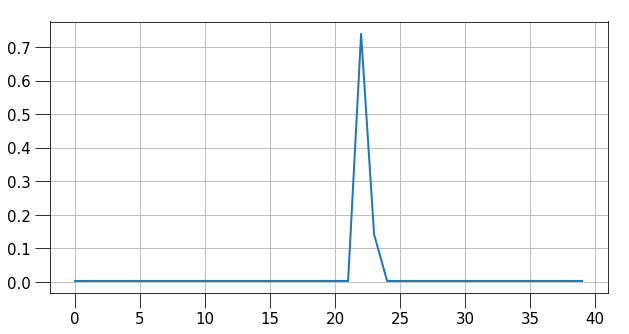

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


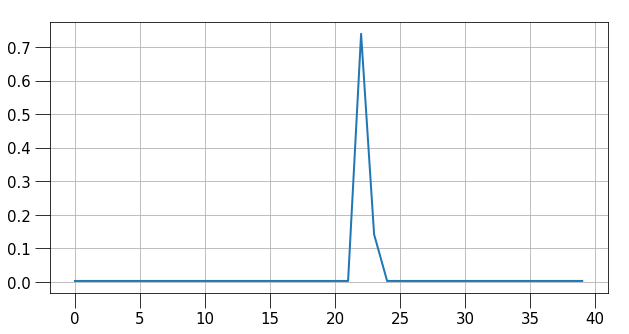

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


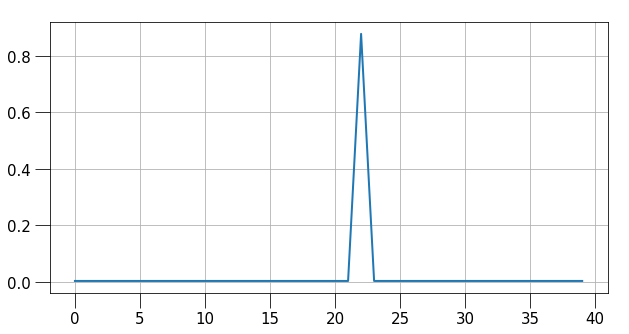

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


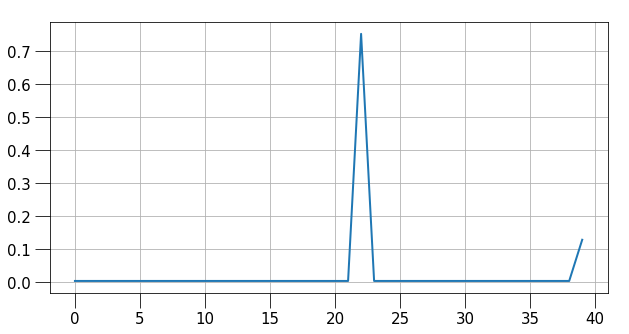

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


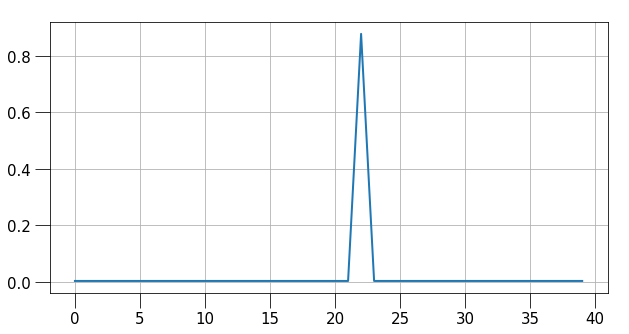

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** lsp bandwidth ** bps
(array([22, 39]),)


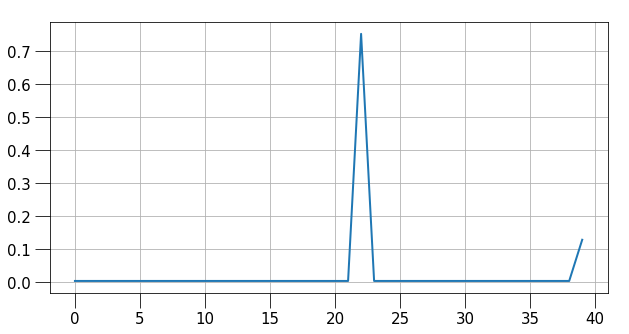

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


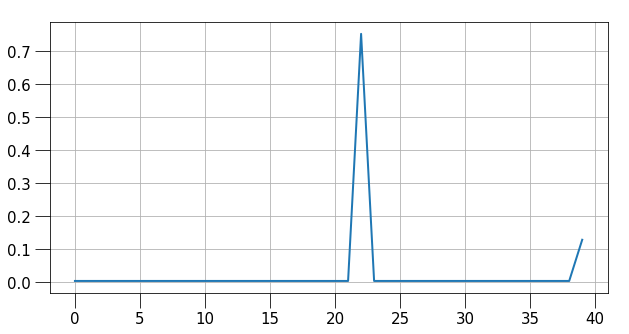

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


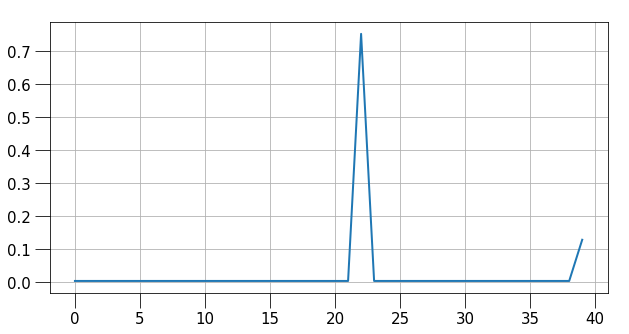

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


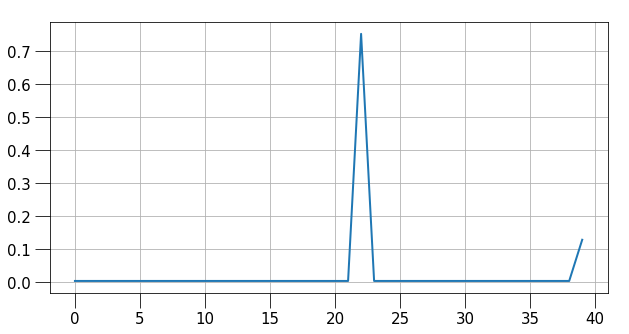

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


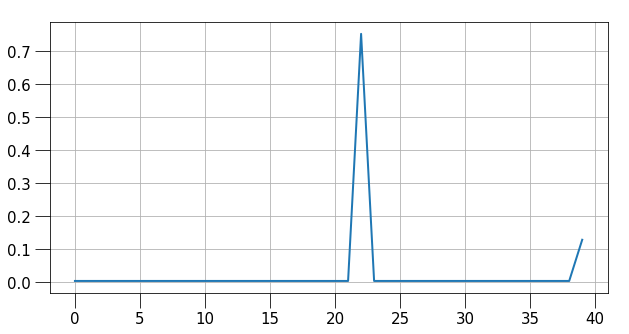

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


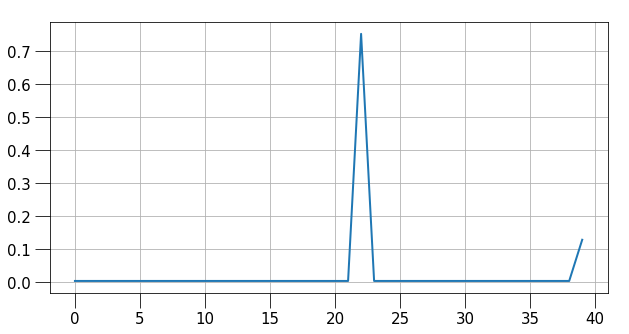

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) ** lsp bandwidth ** bps
(array([22, 39]),)


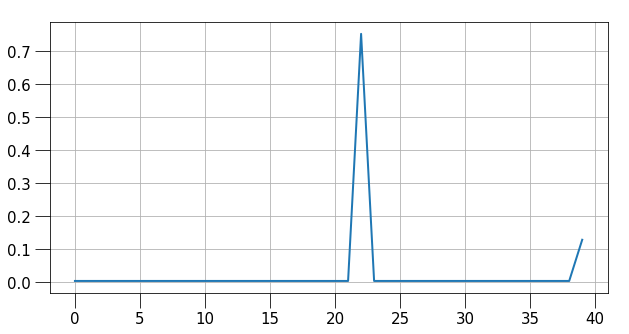

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


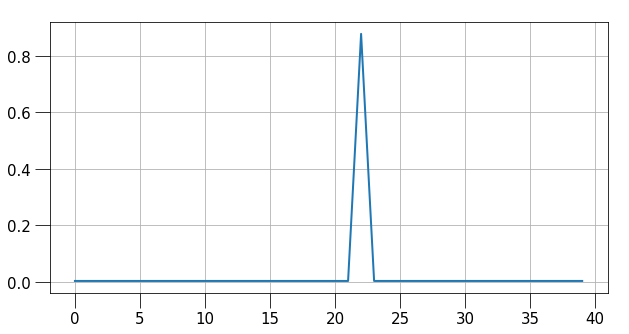

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


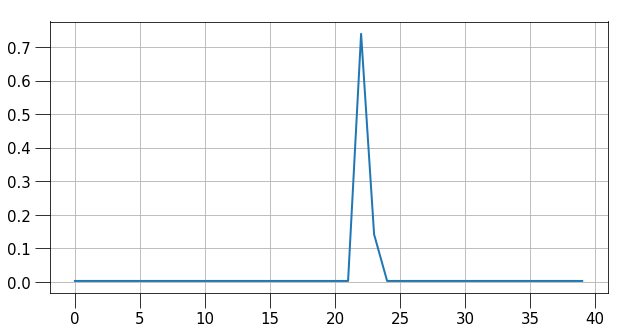

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


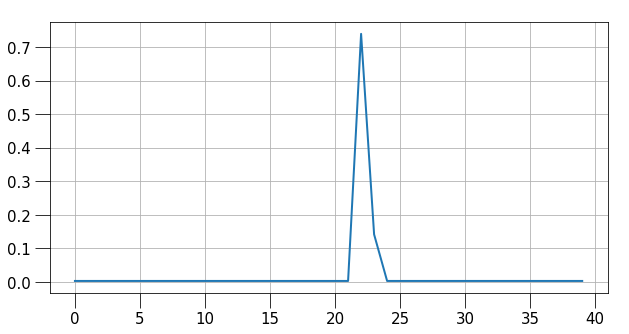

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


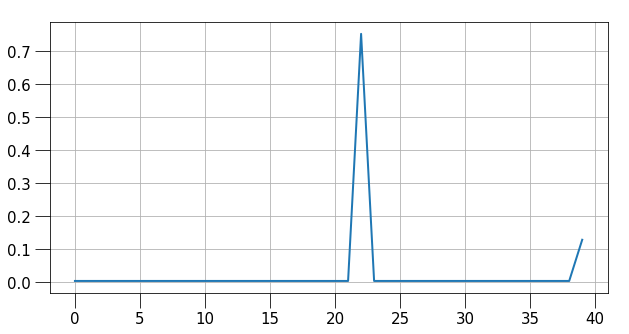

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


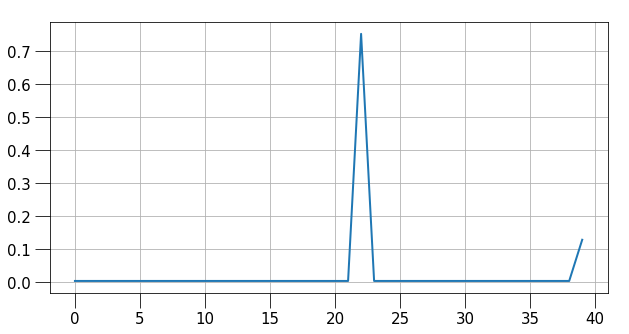

**: rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


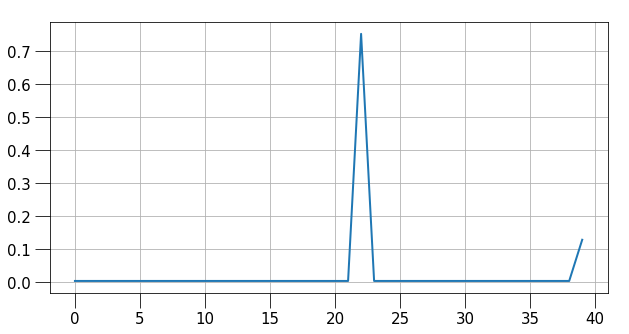

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


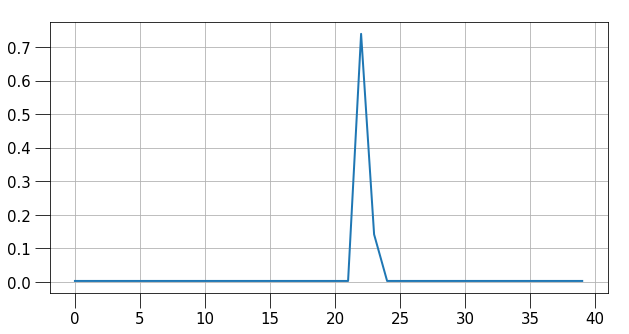

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** ** on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


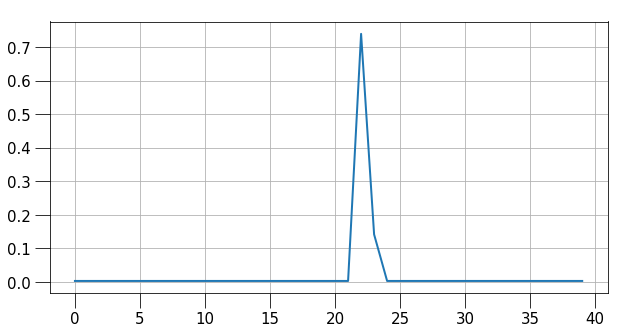

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


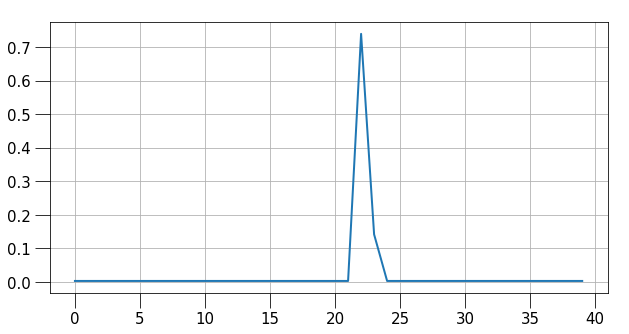

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


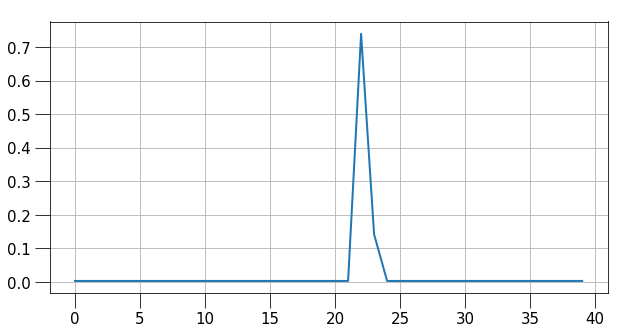

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


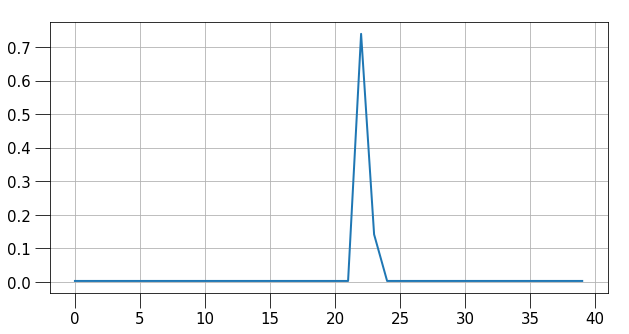

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


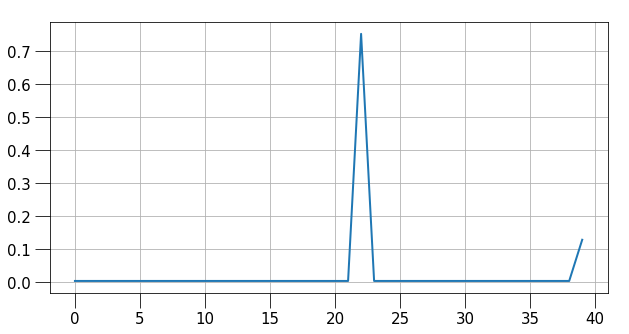

**: rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


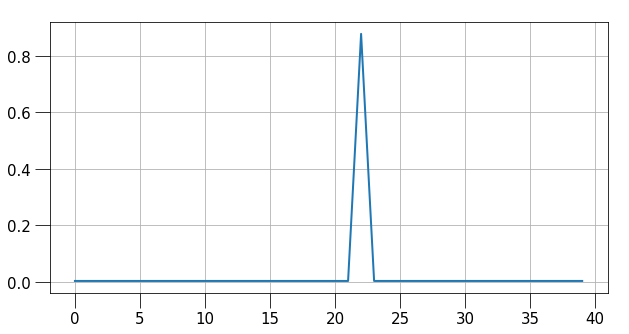

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route ** **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


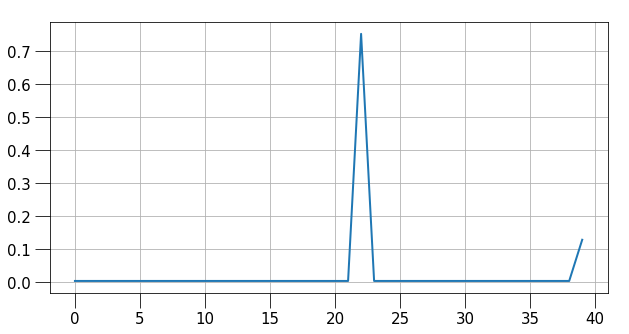

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) ** **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


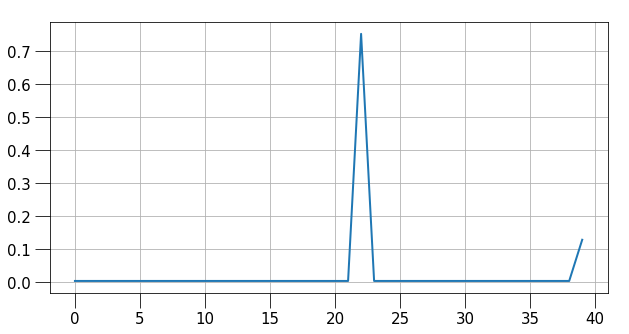

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) ** **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


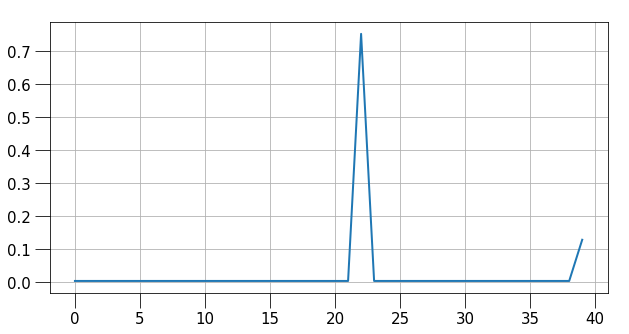

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** change on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


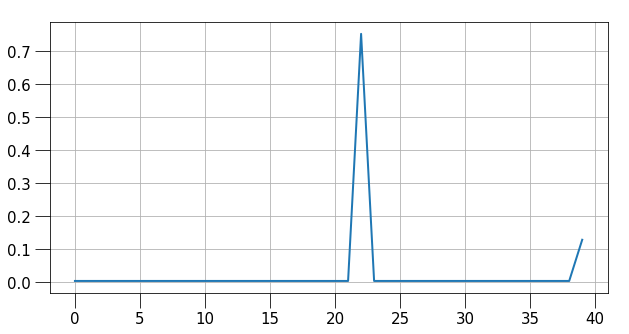

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** ** on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


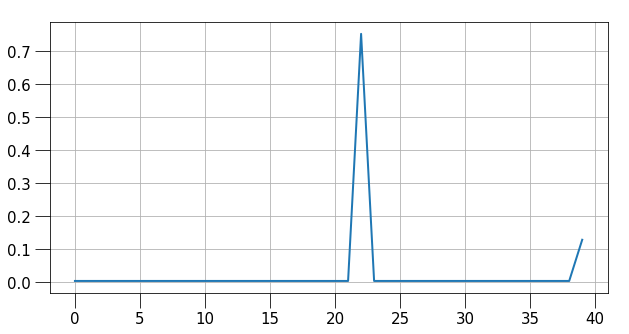

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** ** on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


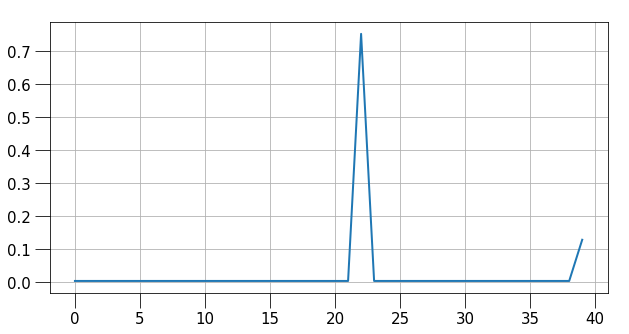

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


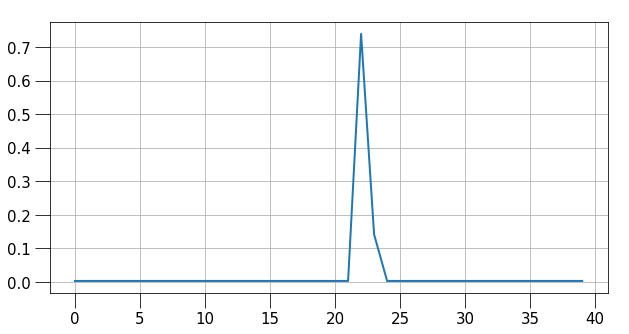

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


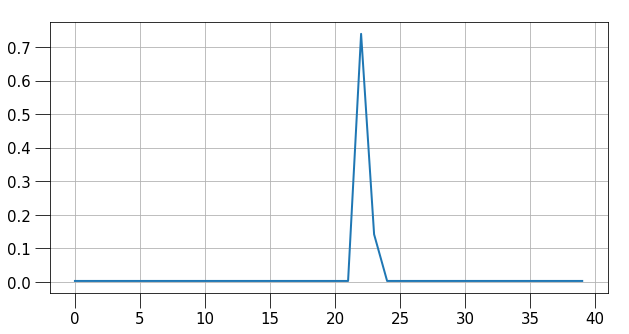

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


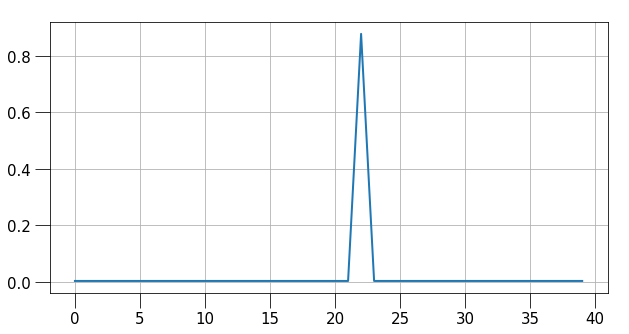

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


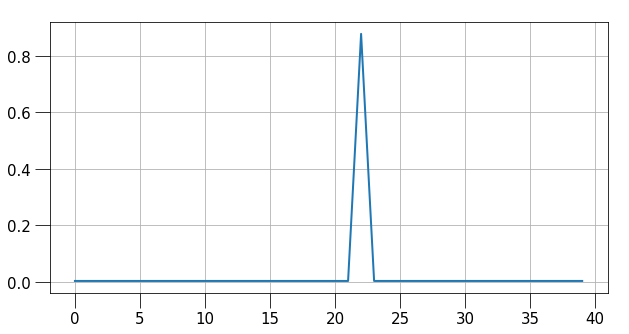

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


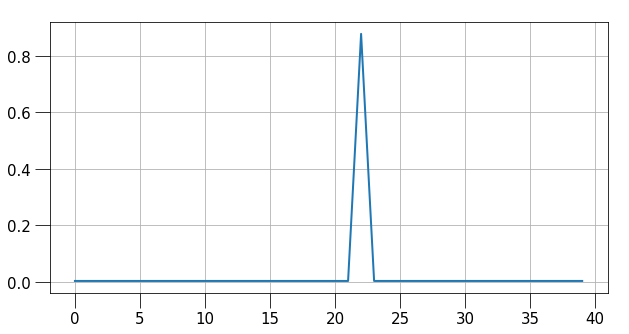

**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** ** on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 23]),)


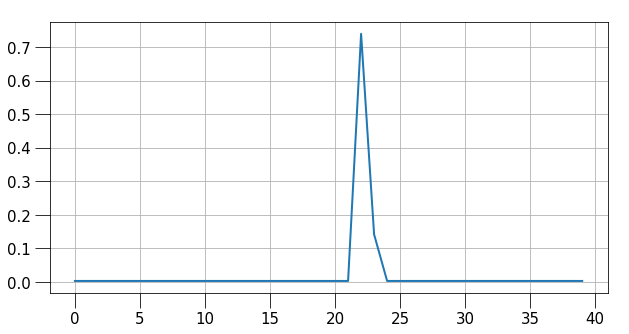

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


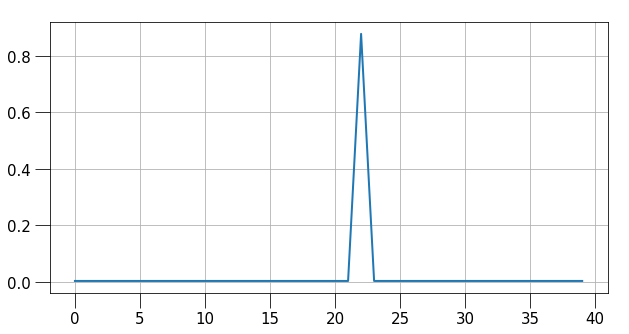

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


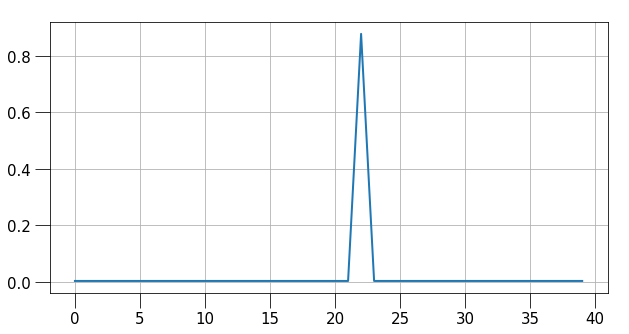

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


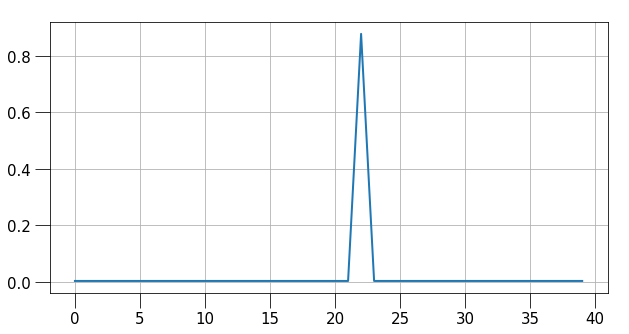

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


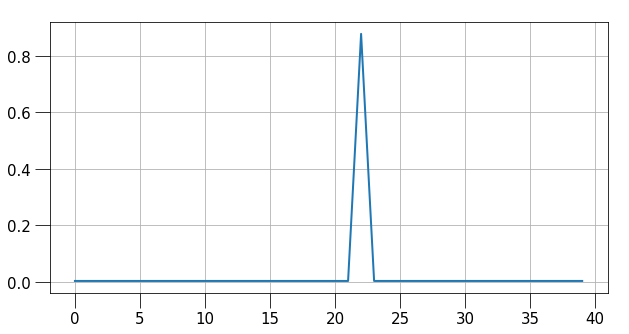

**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from primary(**) to secondary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps
(array([22]),)


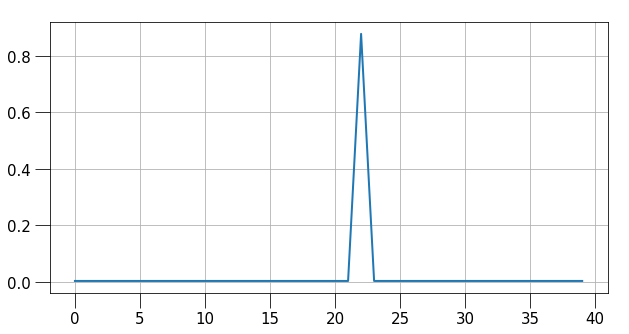

**:rpd[**]: RPD_MPLS_LSP_CHANGE: MPLS LSP ** ** on primary(**) Route ** **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps
(array([22, 39]),)


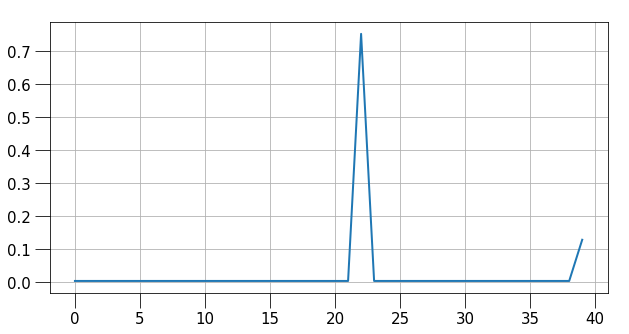

In [911]:
tmp = vecs_df[vecs_df["gt"]=="vpn(mpls)"]

for i in tmp.iterrows():
    print(i[1]['lt'])
    print(np.where(np.array(i[1]['v'])>0.08))

    plt.figure(figsize=(10, 5))
    plt.plot(i[1]['v'])
    plt.grid()
    plt.show()

In [322]:
from sklearn.metrics.pairwise import cosine_similarity

In [323]:
cos_mat = cosine_similarity(np.array(list(vecs_df["v"].values)), np.array(list(vecs_df["v"].values)))

In [324]:
for i in range(len(cos_mat)):
    print(vecs_df['lt'][i])
    print("top 10:")
    for j in zip(vecs_df['lt'][np.argsort(cos_mat[i])[::-1]][:10], np.sort(cos_mat[i])[::-1][:10]):
        print("\t", j)
    print()

/usr/sbin/cron[**]: (root) CMD (newsyslog)
top 10:
	 ('/usr/sbin/cron[**]: (root) CMD (newsyslog)', 0.9999997)
	 ('/usr/sbin/cron[**]: (**) CMD (adjkerntz -a)', 0.9999997)
	 ('/usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-support -l)', 0.9999997)
	 ('** /usr/sbin/cron[**]: (**) CMD (adjkerntz -a)', 0.9999997)
	 ('** /usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-support -l)', 0.9999997)
	 ('/usr/sbin/cron[**]: (root) CMD ( /usr/libexec/atrun)', 0.9999997)
	 ('/usr/sbin/cron[**]: (*system*) RELOAD (/etc/crontab)', 0.9999997)
	 ('** /usr/sbin/cron[**]: (**) CMD (newsyslog)', 0.99991757)
	 ('license-check[**]: LIBJNX_REPLICATE_RCP_ERROR: rcp -r -T **:/config/.license_priv/ ** : rcp: /config/.license_priv/: No such file or directory', 0.9867871)
	 ('license-check[**]: copy from member ** failed', 0.9056695)

/usr/sbin/cron[**]: (**) CMD (adjkerntz -a)
top 10:
	 ('/usr/sbin/cron[**]: (root) CMD (newsyslog)', 0.9999997)
	 ('/usr/sbin/cron[**]: (**) CMD (adjkerntz -a)', 0.9999997)
	 ('/usr/sbi

	 ('login: LOGIN_INFORMATION: User ** logged in from host ** on device **', 0.99999887)
	 ('** login[**]: LOGIN_INFORMATION: User ** logged in from host ** on device **', 0.99999887)
	 ('login[**]: LOGIN_INFORMATION: User ** logged in from host ** on device **', 0.99999887)
	 ('login: login LOGIN_INFORMATION: User ** logged in from host ** on device **', 0.9804184)
	 ('login[**]: Login attempt for user ** from host **', 0.96324086)
	 ('** login: Login attempt for user ** from host **', 0.96324086)
	 ('login: Login attempt for user ** from host **', 0.96324086)
	 ('login[**]: LOGIN_ABORTED: Client aborted login', 0.95950556)
	 ('login: LOGIN_ABORTED: Client aborted login', 0.95950556)
	 ('login: LOGIN_TIMED_OUT: Login attempt timed out after ** seconds', 0.9592467)

[**]: EVT ** ** ** ACCESS ** **:** Login ** from ** (**)**
top 10:
	 ('[**]: EVT ** ** ** ACCESS ** **:** Login ** from ** (**)**', 0.99999905)
	 ('[**]: EVT ** ** ** ACCESS ** **:** Login refused for too many users logged i

	 ('file[**]: UI_JUNOSCRIPT_CMD: User \'**\' used JUNOScript client to run command \'load-configuration rollback="**" \'', 0.9999995)
	 ("file[**]: UI_JUNOSCRIPT_CMD: User '**' used JUNOScript client to run command '**'", 0.9999995)
	 ('file[**]: UI_JUNOSCRIPT_CMD: User \'**\' used JUNOScript client to run command \'get-configuration format="**" \'', 0.9999994)
	 ('file[**]: UI_JUNOSCRIPT_CMD: User \'**\' used JUNOScript client to run command \'load-configuration format="xml" action="**" \'', 0.9999994)
	 ('** /usr/sbin/cron[**]: (**) CMD (newsyslog)', 0.8405445)
	 ('/usr/sbin/cron[**]: (root) CMD ( /usr/libexec/atrun)', 0.8395219)
	 ('/usr/sbin/cron[**]: (*system*) RELOAD (/etc/crontab)', 0.8395219)
	 ('/usr/sbin/cron[**]: (root) CMD (newsyslog)', 0.8395219)
	 ('** /usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-support -l)', 0.8395219)
	 ('/usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-support -l)', 0.8395219)

file[**]: UI_JUNOSCRIPT_CMD: User '**' used JUNOScript client to run command

	 ('Slot **, PIC Slot **) pic_system_init: will call pic_periodic_init', 0.99999946)
	 ('Slot **, PIC Slot **) pic_system_init: pic sys ready', 0.99906856)
	 ('Slot **, PIC Slot **) pic_system_init: total slot **', 0.9648172)
	 ('Slot **, PIC Slot **) PFEMAN: sent resync request to master', 0.96358645)
	 ('pic_system_init: total slot **', 0.91878974)
	 ('** pic_system_init: total slot **', 0.91878873)
	 ('Slot **, PIC Slot **) Version ** by builder on ** ** UTC', 0.88293463)
	 ('CMS: PIC offline fpc_slot ** pic_slot **, reason **', 0.88270295)
	 ('Slot **, PIC Slot **) idx ** af **', 0.8570355)
	 ('pic_system_init: pic sys ready', 0.8432917)

Slot **, PIC Slot **) pic_system_init: pic sys ready
top 10:
	 ('Slot **, PIC Slot **) pic_system_init: pic sys ready', 0.9999996)
	 ('Slot **, PIC Slot **) pic_system_init: will call pic_periodic_init', 0.99906856)
	 ('Slot **, PIC Slot **) pic_system_init: total slot **', 0.95257246)
	 ('Slot **, PIC Slot **) PFEMAN: sent resync request to maste

	 ('rpd[**]: bgp_read_v4_message:**: NOTIFICATION received from ** (** AS **): code ** (Open Message Error)', 1.0000004)
	 ('**: rpd[**]: bgp_read_v4_message:**: NOTIFICATION received from ** (** AS **): code ** (Hold Timer Expired Error), socket buffer sndcc: ** rcvcc: ** TCP state: **, snd_una: ** snd_nxt: ** snd_wnd: ** rcv_nxt: ** rcv_adv: **, hold timer **:**', 1.0000004)
	 ('rpd[**]: bgp_read_v4_message:**: NOTIFICATION received from ** (** AS **): code ** (Cease)', 1.0000004)
	 ('rpd[**]: bgp_read_v4_message:**: NOTIFICATION received from ** (** AS **): code ** (Hold Timer Expired Error), socket buffer sndcc: ** rcvcc: ** TCP state: **, snd_una: ** snd_nxt: ** snd_wnd: ** rcv_nxt: ** rcv_adv: **, hold timer **', 1.0000004)
	 ('rpd[**]: bgp_read_v4_message:**: NOTIFICATION received from ** (** AS **): code ** (Cease) subcode ** (invalid)', 1.0000004)
	 ('**: rpd[**]: bgp_pp_recv: dropping ** (** AS **), connection collision prefers **+** (proto)', 1.0000004)

rpd[**]: bgp_read_v4

	 ('Register LU-CHIP tcam bist', 0.99999976)
	 ('** Register MQ-CHIP dmc bist', 0.99999976)
	 ('** Register LU-CHIP ddr bist', 0.99999976)
	 ('Register MQ-CHIP dmc bist', 0.99999976)
	 ('Register MQ-CHIP rldram bist', 0.99999976)
	 ('Register LU-CHIP ddr bist', 0.99999976)
	 ('Register LU-CHIP rldram bist', 0.99999976)
	 ('** Register ** rldram bist', 0.99991786)
	 ('Tcam BIST:tcam_nl9k_register_request: LU-CHIP[**] TCAM[**] - Add new client<LU-CHIP[**] TCAM[**] >', 0.98678684)
	 ('clksyncd[**]: System has older ACBC FPGA image. Clocking is not supported on it!', 0.98678565)

** Register LU-CHIP HOSTIF
top 10:
	 ('** Register LU-CHIP HOSTIF', 0.99999976)
	 ('Register LU-CHIP HOSTIF', 0.99999976)
	 ('** Register ** rldram bist', 0.8961462)
	 ('Register MQ-CHIP dmc bist', 0.89488286)
	 ('** Register LU-CHIP ddr bist', 0.89488286)
	 ('Register LU-CHIP rldram bist', 0.89488286)
	 ('** Register MQ-CHIP dmc bist', 0.89488286)
	 ('Register LU-CHIP ddr bist', 0.89488286)
	 ('Register LU-CHIP t

	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [interfaces ** encapsulation] <unconfigured> -> "**"', 0.99999964)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [routing-options static route ** bfd-liveness-detection minimum-interval] <unconfigured> -> "**"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [firewall family ** filter ** term ** then count] <unconfigured> -> "**"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [interfaces ** aggregated-ether-options lacp periodic] <unconfigured> -> "**"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [policy-options policy-statement ** term ** then next] <unconfigured> -> "**"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [protocols ospf area ** interface **] <unconfigured> -> "disable"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [protocols bgp group ** neighbor ** family ** unicast accepted-prefix-limit teardown] "** -> "**"', 0.9999993)
	 ('mgd[**]: UI_CFG_AUDIT_SET

	 ("mgd[**]: UI_COMMIT: User '**' requested 'commit synchronize' operation (comment: none)", 0.9487206)
	 ("file[**]: UI_COMMIT: User '**' requested 'commit' operation (comment: none)", 0.89837074)
	 ('idpd[**]: IDP_COMMIT_COMPLETED: IDP policy commit is complete.', 0.8468043)
	 ("mgd[**]: UI_COMMIT_EMPTY_CONTAINER: Skipped empty object '**'", 0.84429824)
	 ('jl2tpd: jl2tpd: main: *** jl2tpd not running in active mode***', 0.81219244)
	 ('** rpd[**]: Synchronized commit processing phase ** **', 0.80101806)
	 ('rpd[**]: Synchronized commit processing phase ** **', 0.80101806)
	 ('** rpd[**]: Synchronized commit processing complete', 0.7497731)

mgd[**]: UI_CFG_AUDIT_OTHER: User '**' delete: [protocols bgp group **]
top 10:
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' delete: [class-of-service interfaces **]", 1.0000005)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' delete: [routing-instances **]", 1.0000005)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' delete: [logical-systems ** routing-insta

	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [chassis redundancy **]", 0.99999994)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' activate: [chassis redundancy **]", 0.99999994)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [logical-systems ** interfaces ** unit **]", 0.99999994)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [firewall family ** filter ** term ** from **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [policy-options as-path-group ** as-path **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [interfaces ** unit ** family **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' activate: [interfaces ** unit ** family **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' deactivate: [firewall family ** filter ** term ** from interface **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' activate: [firewall family ** filter ** term ** from interface **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_

	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [routing-options static route ** next-hop **]", 0.9999999)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [class-of-service interfaces ** unit ** rewrite-rules dscp **]", 0.99999964)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [snmp trap-group ** targets **]", 0.99999964)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [policy-options policy-statement ** term ** from community **]", 0.99999964)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [logical-systems ** routing-instances ** protocols vpls site ** interface ** **]", 0.9999996)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [routing-instances ** routing-options rib ** static route ** next-hop **]", 0.9999996)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [routing-options rib ** static route ** next-hop **]", 0.9999996)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [protocols ospf3 export **]", 0.9999996)
	 ("mgd[**]: UI_CFG_AUDIT_OTHER: User '**' set: [logical-systems ** p

	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [interfaces ** encapsulation] <unconfigured> -> "**"', 0.9999996)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [logical-systems ** routing-instances ** protocols vpls site ** interface ** interface-mac-limit] <unconfigured> -> "**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [policy-options as-path-group ** as-path **] <unconfigured> -> "**+**+**+**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [protocols bgp group ** type] <**> -> "**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [interfaces ** unit ** family ** filter input] <unconfigured> -> "**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [forwarding-options sampling instance ** family ** output flow-server ** port] <**> -> "**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [system login user ** class] <unconfigured> -> "**"', 0.9999992)
	 ('mgd[**]: UI_CFG_AUDIT_SET: User \'**\' set: [protocols bgp gr

	 ('CLKSYNC: master RE connection made', 1.0)
	 ('[**]: EVT ** ** ** PORT ** ** **:** Port enabled administratively.', 1.0)
	 ('** L2ALM master RE connection made', 1.0)
	 ('** CLKSYNC: master RE connection made', 1.0)
	 ('L2ALM master RE connection made', 1.0)
	 ('[**]: EVT ** ** ** PORT ** ** **:** Auto negotiation failed.', 1.0)
	 ('** [**]: EVT ** ** ** PORT ** ** **:** Port enabled administratively.', 1.0)
	 ('[**]: EVT ** ** ** PORT MGMT ** ** **:** Port up.', 1.0)
	 ('PPMAN disconnected; Remote side closed', 1.0)
	 ('BULKGET master RE reconnection made', 1.0)

bulkget_start_pfeman_transaction
top 10:
	 ('** bulkget manager thread creating...', 1.0000005)
	 ('** bulkget_start_pfeman_transaction', 1.0000005)
	 ('bulkget_start_pfeman_transaction', 1.0000005)
	 ('bulkget manager thread creating...', 1.0000005)
	 ('bulkget_stop_pfeman_transaction', 1.0000004)
	 ('** PFEMAN: pfeman_start_service_bulkget', 0.99695385)
	 ('PFEMAN: pfeman_start_service_bulkget', 0.99695385)
	 ('** PFEMAN

	 ('mcsn[**]: EVENT <UpDown> index ** <Up Broadcast Multicast>', 0.99999976)
	 ('**: rpd[**]: EVENT <UpDown> index ** <Up Broadcast Multicast>', 0.99999976)
	 ('**: rpd[**]: EVENT <Flags> ** index ** <Up Broadcast PointToPoint Multicast>', 0.99999964)
	 ('**: rpd[**]: EVENT Add ** index ** <Up Broadcast Multicast Localup>', 0.99999964)
	 ('**: rpd[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **', 0.99999964)
	 ('mcsn[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **', 0.99999964)
	 ('rpd[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **', 0.99999964)
	 ('rpd[**]: EVENT <Address> ** index ** <Broadcast Multicast> address #** **', 0.99999964)
	 ('**: rpd[**]: EVENT <Add> ** index ** <Up Broadcast Multicast> address #** **', 0.99999964)
	 ('**: rpd[**]: EVENT <Instance> ** index ** <Up Broadcast Multicast> address #** **', 0.99999964)

**: rpd[**]: EVENT <Instance> ** index ** <Broadcast Multica


rpd[**]: EVENT Add ** index ** ** -> ** <Broadcast PointToPoint Multicast>
top 10:
	 ('rpd[**]: EVENT UpDown ** index ** ** -> ** <Broadcast Multicast Localup>', 1.0000004)
	 ('rpd[**]: EVENT UpDown ** index ** ** -> ** <Up Broadcast Multicast>', 1.0000004)
	 ('rpd[**]: EVENT Delete UpDown ** index ** ** -> ** <Broadcast Multicast Localup>', 1.0000004)
	 ('rpd[**]: EVENT Flags ** index ** ** -> (**) <Up Broadcast Multicast Localup>', 1.0000004)
	 ('rpd[**]: EVENT Delete UpDown ** index ** ** -> ** <Broadcast PointToPoint Multicast Localup>', 1.0000004)
	 ('**: rpd[**]: EVENT Delete UpDown ** index ** ** -> ** <Broadcast Multicast Localup>', 1.0000004)
	 ('**: rpd[**]: EVENT Flags ** index ** ** -> ** <Up Broadcast Multicast Localup>', 1.0000004)
	 ('rpd[**]: EVENT Flags ** index ** ** -> (**) <Broadcast Multicast>', 1.0000004)
	 ('rpd[**]: EVENT Add ** index ** ** -> ** <Up Broadcast PointToPoint Multicast Localup>', 1.0000004)
	 ('rpd[**]: EVENT Add ** index ** ** -> ** <Up Broadcast

	 ('**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps', 1.0000001)
	 ('rpd[**]: RPD_MSDP_PEER_UP: MSDP peer ** peer-group ** into ** state', 1.0000001)
	 ('**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps', 1.0000001)
	 ('**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on secondary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp bandwidth ** bps', 1.0000001)
	 ('**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on primary(**) Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**) lsp b

	 ('craftd[**]: Major alarm cleared, Host ** ECC ** parity error', 1.0000001)
	 ('craftd[**]: Minor alarm cleared, PEM ** Absent', 0.9808926)
	 ('craftd[**]: Major alarm cleared, PEM ** Dipswitch ** Feed Connection **', 0.9801341)
	 ('alarmd[**]: Alarm cleared: Pwr supply color=**, class=**, reason=PEM ** Dipswitch ** Feed Connection **', 0.98013)
	 ('alarmd[**]: Alarm cleared: Pwr supply color=**, class=**, reason=PEM ** Input Failure', 0.9801299)
	 ('alarmd[**]: Alarm cleared: Pwr supply color=**, class=**, reason=PEM ** Not OK', 0.9801299)
	 ('alarmd[**]: Alarm cleared: Pwr supply color=**, class=**, reason=PEM ** Absent', 0.9801299)
	 ('alarmd[**]: Alarm cleared: Pwr supply color=**, class=**, reason=PEM ** Fan Failed', 0.9801299)
	 ('craftd[**]: Minor alarm cleared, Loss of communication with Backup RE', 0.98012453)
	 ('alarmd[**]: Alarm cleared: RE color=**, class=**, reason=Host ** ECC ** parity error', 0.9628132)

alarmd[**]: Alarm cleared: RE color=**, class=**, reason=Backup 

	 ('**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps', 0.9999996)
	 ('**:rpd[**]: RPD_MPLS_LSP_SWITCH: MPLS LSP ** switch from secondary(**) to primary(**), Route **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(flag=** Label=**) **(flag=**) **(Label=**) **(flag=**) **(Label=**): lsp bandwidth ** bps', 0.9999996)

**: rpd[**]: l2vpn_dyn_config_repo_flush:Session DB still recoverying - postpone flush op
top 10:
	 ('**: rpd[**]: l2vpn_dyn_config_repo_flush:Session DB still recoverying - postpone flush op', 1.0000005)
	 ('PFE[**]Aliveness Turning Destination ** off', 0.986787)
	 ('** PFE[**]Aliveness Turning Destination ** off', 0.986787)
	 ('fpc1 PFE[**]Aliveness Turning Destination ** off', 0.9866532)
	 ('fpc1 Ignoring unsupported run-length config for sample class Sampler', 0

	 ('LUCHIP(**) GUMEM[**].ucode.instr[**] read error.', 1.0000007)
	 ('LUCHIP(**) IDMEM[**] read error.', 1.0000007)
	 ('PLX port ** RXE Count: **', 1.0000007)
	 ('** LUCHIP(**) GUMEM[**].ucode.instr[**] read error.', 1.0000007)
	 ('LUCHIP(**) RD_NACK ** AP[**] TOE Read **', 0.96979696)
	 ('PLX port ** Soft Error2 Count: **', 0.9545577)
	 ('** luchip_program_ucode_img **', 0.9491281)
	 ('luchip_program_ucode_img Success!!!', 0.9486204)
	 ('PPE PPE HW Fault Trap: Count **, PC **, **: call_table_launch_nh', 0.9361134)
	 ('PPE PPE HW Fault Trap: Count **, PC **, 0x0056: ipv4_input_set_proto_and_ports', 0.9361134)

[**]: RSP ** ** **(**):ipv6 : Can not delete it because data is not corresponding.[**]
top 10:
	 ('[**]: RSP ** ** **(**):ipv6 : Can not delete it because data is not corresponding.[**]', 1.0000006)
	 ('[**]: RSP ** ** **(**):interface : Can not delete interface of channel-group because specified port status is up.[**]', 0.9621518)
	 ('[**]: RSP ** ** **(**):username : Can not de

	 ('chas[**]: XCVR: Freeing itable entry for xcvr index: ** port: **', 1.0000001)
	 ('chas[**]: XCVR: Inserted itable entry at xcvr index: ** port: **', 0.97273964)
	 ('chas[**]: xcvr_cache_eeprom XCVR link ** pic_slot ** unplugged', 0.9028854)
	 ('MQ ** DDR3 DDRIO ** VERIFY_PASSED at retry **', 0.8733227)
	 ('** MQ ** DDR3 DDRIO ** VERIFY_PASSED at retry **', 0.8733227)
	 ('/kernel: SGLink(RD): SGLS error [**] at device **, illegal command error', 0.8595526)
	 ('** LUCHIP(**) DDR3 VERIFY_PASSED at retry **', 0.8577742)
	 ('LUCHIP(**) DDR3 VERIFY_PASSED at retry **', 0.85777414)
	 ('appidd[**]: ai_cache_corruption_check_and_recovery: ai_cache corruption, try recovery...', 0.8421642)
	 ('/kernel: SGLink(RD): GBUS error [**] at device **, address **, slave reply CRC error, slave error reply', 0.7928514)

chas[**]: ifcm_ifd_remove_vector: ifd ** is_vcp ** peer **
top 10:
	 ('chas[**]: ifcm_ifd_remove_vector: ifd ** is_vcp ** peer **', 0.99999946)
	 ('Calling **', 0.8496621)
	 ('** Calling

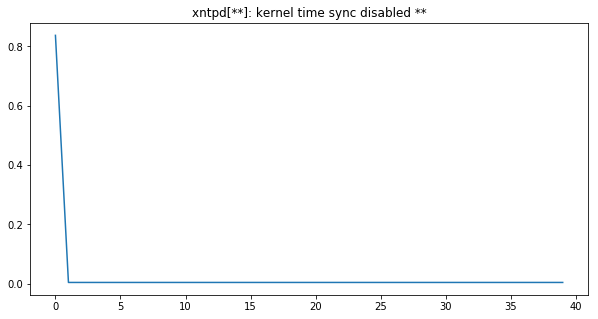

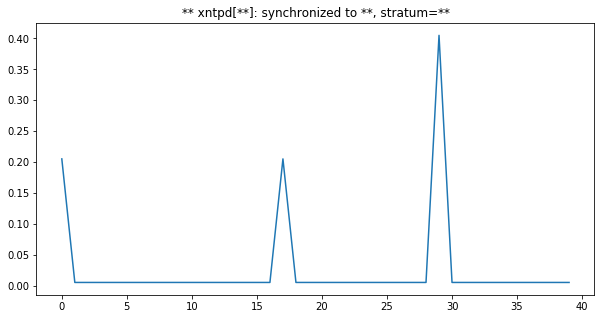

In [325]:
for k,v in lt_vecs.items():
    if k == "** xntpd[**]: synchronized to **, stratum=**" or k =="xntpd[**]: kernel time sync disabled **":
        plt.figure(figsize=(10, 5))
        plt.title(k)
        plt.plot(v)
        plt.show()

### 単純な手法と比較してみる
- BoW をk-means

In [326]:
len(corpus)

1789

In [327]:
vec_len = len(word_dict)

bow_vecs = []
for v in corpus:
    vec = np.zeros(vec_len)
    for vv in v:
        vec[vv[0]] = vv[1]
    bow_vecs.append(vec)
bow_vecs = np.array(bow_vecs)

In [328]:
bow_vecs.shape

(1789, 1701)

In [329]:
from sklearn.cluster import KMeans

In [330]:
km = KMeans(n_clusters=40,random_state=9)
km.fit(bow_vecs)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=40, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=9, tol=0.0001, verbose=0)

In [331]:
vecs_df['km'] = 0 
for class_label in range(40):
#     print(class_label)
    idx = (km.labels_==class_label)
    vecs_df['km'][idx] = class_label

/home/otomo/.pyenv/versions/3.6.1/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [332]:
from scipy.stats import entropy

- entropyは小さいほうがいい．

In [333]:
vecs_df

,lt,v,gt,tm,km
0,/usr/sbin/cron[**]: (root) CMD (newsyslog),"[0.0050000004, 0.0050000004, 0.0050000004, 0.0...",system(cron),8.0,30
1,/usr/sbin/cron[**]: (**) CMD (adjkerntz -a),"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
2,/usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-...,"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
3,** /usr/sbin/cron[**]: (**) CMD (newsyslog),"[0.00625, 0.00625, 0.00625, 0.00625, 0.00625, ...",system(cron),8.0,30
4,** /usr/sbin/cron[**]: (**) CMD (adjkerntz -a),"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
5,** /usr/sbin/cron[**]: (**) CMD (/usr/sbin/che...,"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
6,/usr/sbin/cron[**]: (root) CMD ( /usr/libexec/...,"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
7,/usr/sbin/cron[**]: (*system*) RELOAD (/etc/cr...,"[0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.0...",system(cron),8.0,30
8,mib2d[**]: lacp info not found for ifl:**,"[0.003125, 0.003125, 0.12812349, 0.003125, 0.0...",network(lacp),17.0,30
9,mib2d[**]: cleared lacp info not found for ifl:**,"[0.003125, 0.003125, 0.1281235, 0.003125, 0.00...",network(lacp),17.0,30


In [424]:
tmp = dict()
for row in vecs_df[vecs_df["gt"]=="interface(agg)"][["lt", "tm"]].iterrows():
    if row[1]["tm"] in tmp:
        tmp[row[1]["tm"]].append(row[1]["lt"])
    else:
        tmp[row[1]["tm"]] =[row[1]["lt"]]

In [425]:
for k,v in tmp.items():
    print(k, v)

35.0 ['dcd[**]: ** : Warning: aggregated-ether-options link-speed no kernel value! default to **', 'dcd[**]: ** : aggregated-ether-options link-speed set to kernel value of **', '** dcd[**]: ** : Warning: aggregated-ether-options link-speed no kernel value! default to **', '** dcd[**]: ** : aggregated-ether-options link-speed set to kernel value of **']
11.0 ['/kernel: ae_link_op: link ** (lidx=**) detached from bundle **', '**: rpd[**]: Received MC_AE_OPTIONS TLV for intf device **; mc_ae_id **, status **', 'mcsn[**]: Received MC_AE_OPTIONS TLV for intf device **; mc_ae_id **, status **', '/kernel: ae_link_op: link ** (lidx=**) attached to bundle **', 'rpd[**]: Received MC_AE_OPTIONS TLV for intf device **; mc_ae_id **, status **', '** /kernel: ae_link_op: link ** (lidx=**) detached from bundle **', '** /kernel: ae_link_op: link ** (lidx=**) attached to bundle **']
17.0 ['/kernel: ** leaves **', '/kernel: ** joins **', '[**]: EVT ** ** ** MAC ** **:** Channel Group(**) is Down - All p

In [338]:
# import pickle

# with open("vecs_df_20180805", "wb") as f:
#     pickle.dump(vecs_df, f)

system(cron)
#class(tm)	 1
	 Counter({8.0: 8})
	Entropy:	 0.0
#class(km)	 1
	 Counter({30: 8})
	Entropy:	 0.0


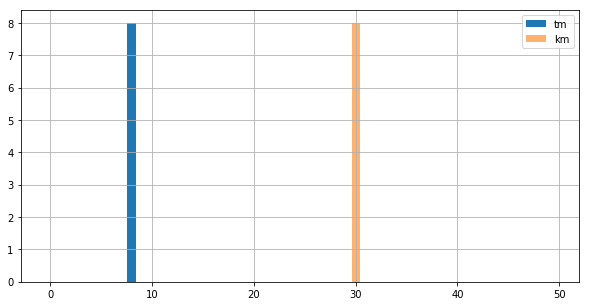


network(lacp)
#class(tm)	 2
	 Counter({33.0: 4, 17.0: 2})
	Entropy:	 0.6365141682948128
#class(km)	 1
	 Counter({30: 6})
	Entropy:	 0.0


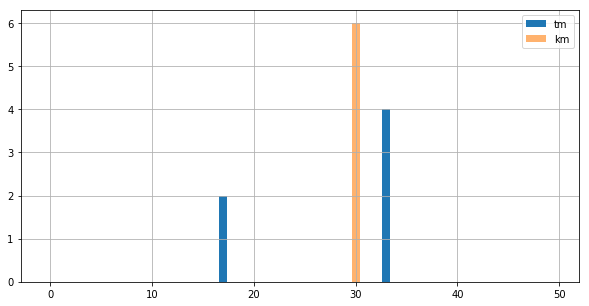


service(ntp)
#class(tm)	 5
	 Counter({0.0: 26, 29.0: 4, 4.0: 2, 26.0: 2, 15.0: 1})
	Entropy:	 0.8973973141957601
#class(km)	 3
	 Counter({30: 16, 21: 14, 7: 5})
	Entropy:	 1.002336297700253


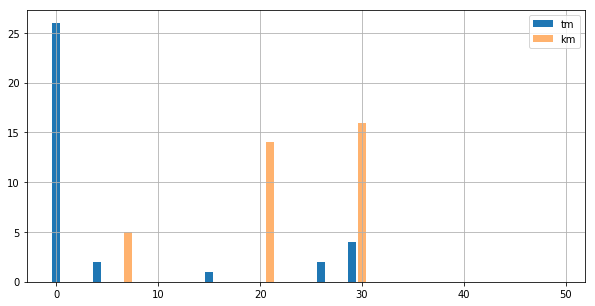


monitor(syslog)
#class(tm)	 2
	 Counter({22.0: 2, 20.0: 2})
	Entropy:	 0.6931471805599453
#class(km)	 2
	 Counter({30: 3, 23: 1})
	Entropy:	 0.5623351446188083


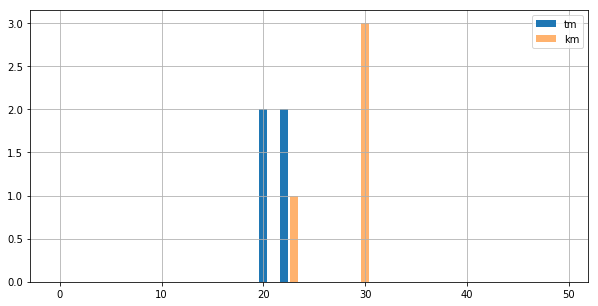


network(mtu)
#class(tm)	 2
	 Counter({23.0: 24, 17.0: 2})
	Entropy:	 0.2711893730418441
#class(km)	 5
	 Counter({38: 9, 11: 6, 36: 5, 4: 4, 7: 2})
	Entropy:	 1.507933484976703


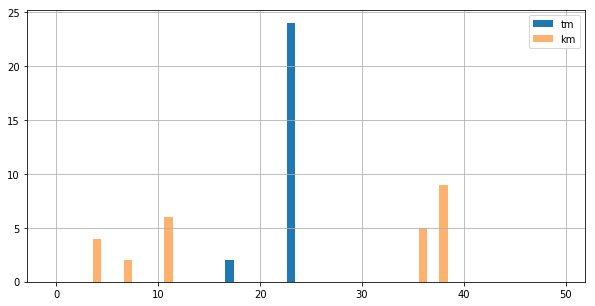


mgmt(login)
#class(tm)	 2
	 Counter({7.0: 37, 36.0: 1})
	Entropy:	 0.12169240267806193
#class(km)	 3
	 Counter({27: 26, 16: 10, 32: 2})
	Entropy:	 0.7659373365785205


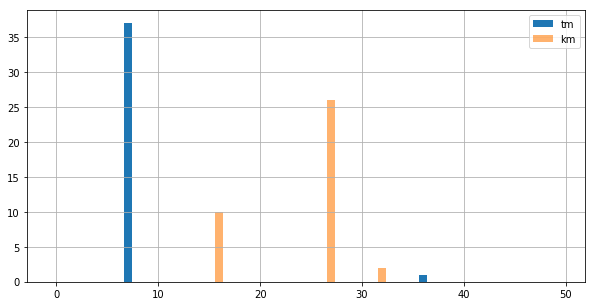


system(ui)
#class(tm)	 6
	 Counter({10.0: 16, 7.0: 13, 27.0: 8, 36.0: 2, 4.0: 1, 38.0: 1})
	Entropy:	 1.3787528496946724
#class(km)	 4
	 Counter({31: 21, 25: 10, 35: 9, 30: 1})
	Entropy:	 1.11025881504191


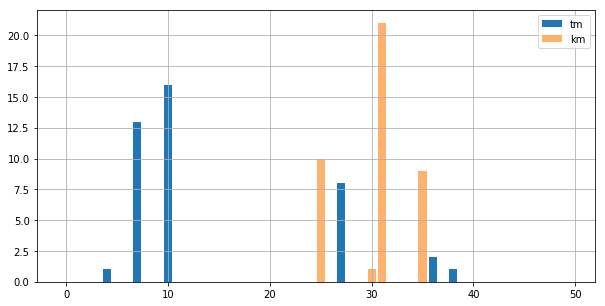


mgmt(command)
#class(tm)	 2
	 Counter({10.0: 20, 8.0: 4})
	Entropy:	 0.45056120886630463
#class(km)	 1
	 Counter({5: 24})
	Entropy:	 0.0


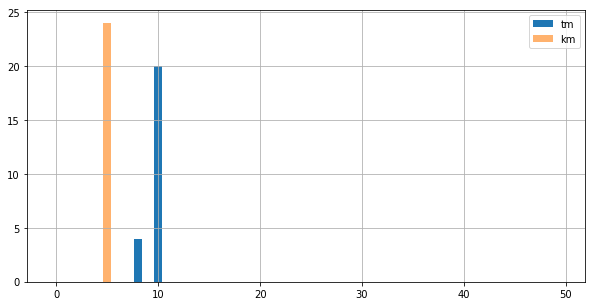


mgmt(ssh)
#class(tm)	 4
	 Counter({36.0: 11, 17.0: 5, 35.0: 1, 32.0: 1})
	Entropy:	 0.9779252266210214
#class(km)	 2
	 Counter({3: 17, 30: 1})
	Entropy:	 0.2145591551764051


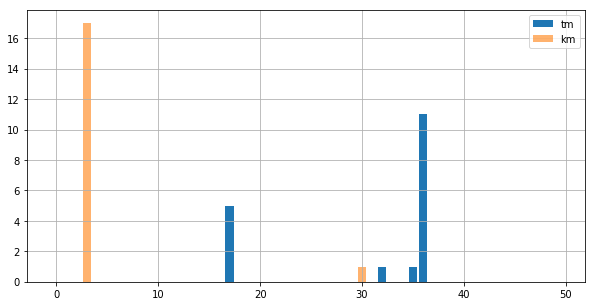


network(l2)
#class(tm)	 6
	 Counter({26.0: 6, 14.0: 2, 3.0: 2, 22.0: 2, 36.0: 2, 29.0: 1})
	Entropy:	 1.6216679171123507
#class(km)	 4
	 Counter({30: 9, 12: 2, 17: 2, 20: 2})
	Entropy:	 1.1124565824765005


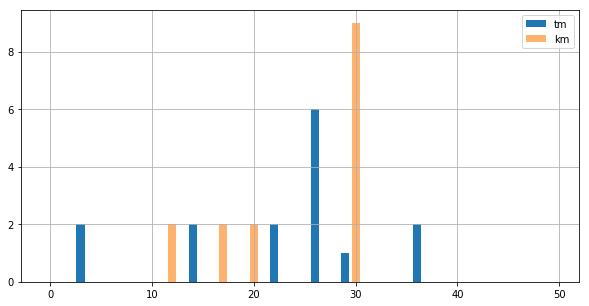


system(unix)
#class(tm)	 6
	 Counter({13.0: 23, 0.0: 5, 28.0: 3, 30.0: 2, 24.0: 1, 2.0: 1})
	Entropy:	 1.1311855541846947
#class(km)	 2
	 Counter({14: 25, 30: 10})
	Entropy:	 0.5982695885852573


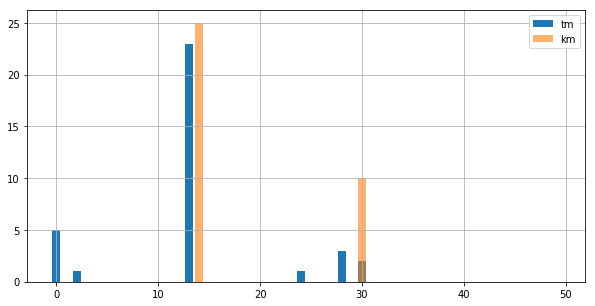


network(storm)
#class(tm)	 1
	 Counter({36.0: 6})
	Entropy:	 0.0
#class(km)	 1
	 Counter({20: 6})
	Entropy:	 0.0


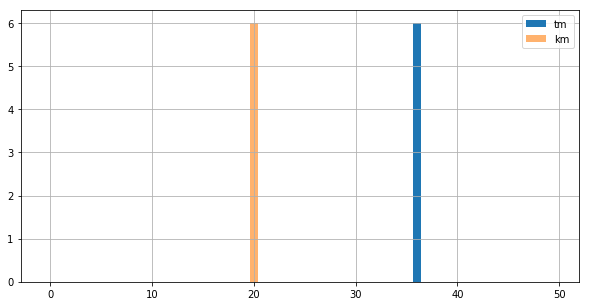


system(pic)
#class(tm)	 8
	 Counter({32.0: 14, 20.0: 12, 22.0: 3, 13.0: 2, 36.0: 1, 1.0: 1, 34.0: 1, 30.0: 1})
	Entropy:	 1.5139819575124467
#class(km)	 3
	 Counter({23: 28, 30: 6, 7: 1})
	Entropy:	 0.5824256871958696


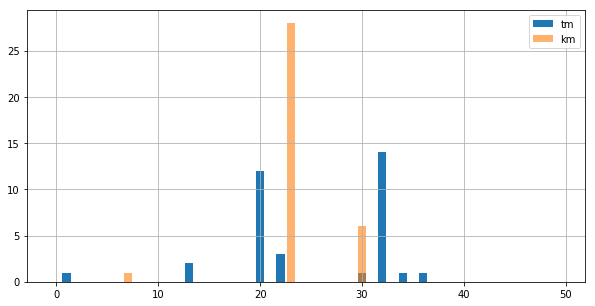


network(pfe)
#class(tm)	 10
	 Counter({1.0: 13, 20.0: 9, 14.0: 8, 35.0: 7, 27.0: 3, 39.0: 2, 24.0: 2, 22.0: 1, 16.0: 1, 15.0: 1})
	Entropy:	 1.947069052601634
#class(km)	 5
	 Counter({30: 38, 7: 6, 24: 1, 28: 1, 2: 1})
	Entropy:	 0.6803852424553567


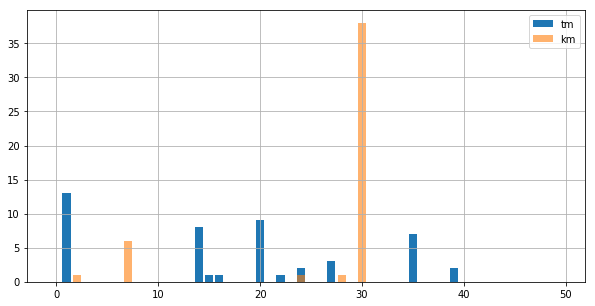


system(ppe)
#class(tm)	 4
	 Counter({12.0: 3, 36.0: 1, 24.0: 1, 5.0: 1})
	Entropy:	 1.2424533248940002
#class(km)	 2
	 Counter({30: 4, 24: 2})
	Entropy:	 0.6365141682948128


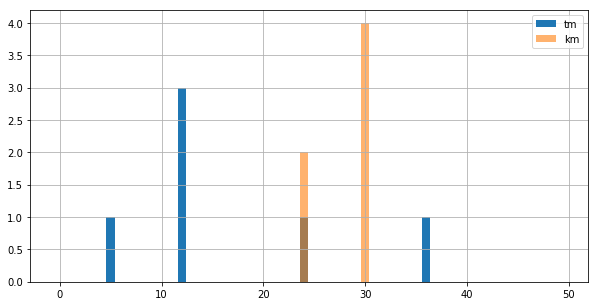


mgmt(pam)
#class(tm)	 1
	 Counter({7.0: 3})
	Entropy:	 0.0
#class(km)	 1
	 Counter({32: 3})
	Entropy:	 0.0


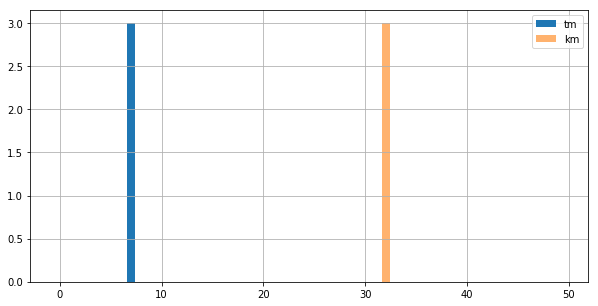


mgmt(su)
#class(tm)	 1
	 Counter({32.0: 4})
	Entropy:	 0.0
#class(km)	 1
	 Counter({7: 4})
	Entropy:	 0.0


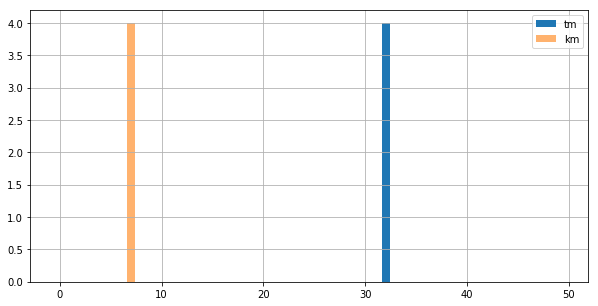


egp(bgp)
#class(tm)	 5
	 Counter({22.0: 49, 21.0: 3, 20.0: 2, 3.0: 1, 1.0: 1})
	Entropy:	 0.5363994436897042
#class(km)	 3
	 Counter({10: 48, 17: 7, 12: 1})
	Entropy:	 0.46394062703932853


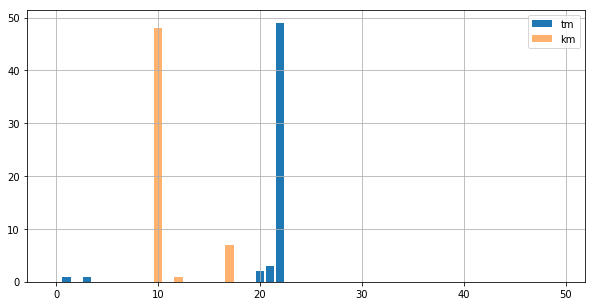


network(mld)
#class(tm)	 1
	 Counter({18.0: 1})
	Entropy:	 0.0
#class(km)	 1
	 Counter({30: 1})
	Entropy:	 0.0


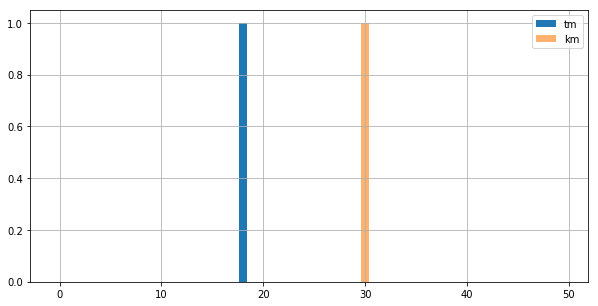


system(fpc)
#class(tm)	 13
	 Counter({12.0: 17, 5.0: 12, 25.0: 10, 13.0: 10, 33.0: 8, 30.0: 6, 19.0: 3, 27.0: 3, 21.0: 2, 32.0: 2, 26.0: 1, 7.0: 1, 23.0: 1})
	Entropy:	 2.2151338651633306
#class(km)	 3
	 Counter({30: 67, 24: 7, 7: 2})
	Entropy:	 0.4264955652376231


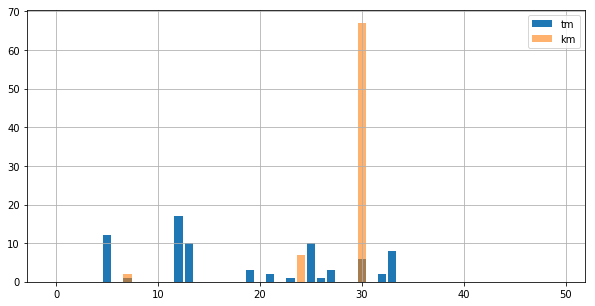


network(arp)
#class(tm)	 2
	 Counter({39.0: 3, 32.0: 3})
	Entropy:	 0.6931471805599453
#class(km)	 1
	 Counter({30: 6})
	Entropy:	 0.0


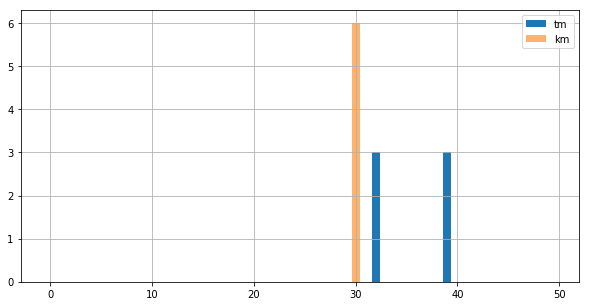


interface(port)
#class(tm)	 1
	 Counter({36.0: 10})
	Entropy:	 0.0
#class(km)	 1
	 Counter({20: 10})
	Entropy:	 0.0


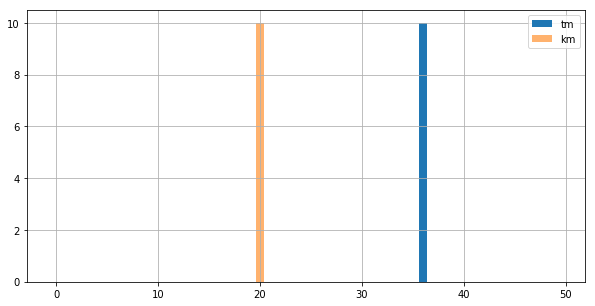


mgmt(config)
#class(tm)	 6
	 Counter({10.0: 254, 4.0: 185, 3.0: 18, 7.0: 15, 21.0: 11, 29.0: 8})
	Entropy:	 1.088687393670115
#class(km)	 6
	 Counter({13: 185, 1: 167, 9: 112, 12: 16, 17: 6, 31: 5})
	Entropy:	 1.2838131016610905


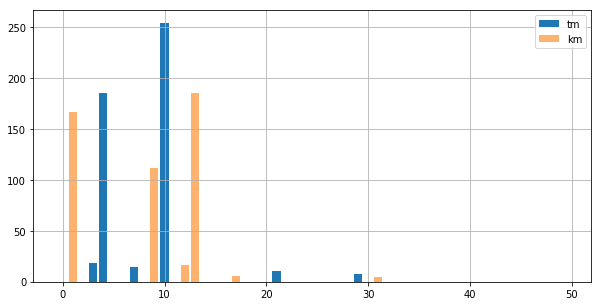


interface(agg)
#class(tm)	 10
	 Counter({11.0: 7, 17.0: 6, 36.0: 6, 26.0: 5, 35.0: 4, 22.0: 2, 32.0: 2, 4.0: 2, 39.0: 1, 6.0: 1})
	Entropy:	 2.1148040838968436
#class(km)	 5
	 Counter({30: 23, 20: 6, 7: 3, 17: 2, 13: 2})
	Entropy:	 1.1130925670676965


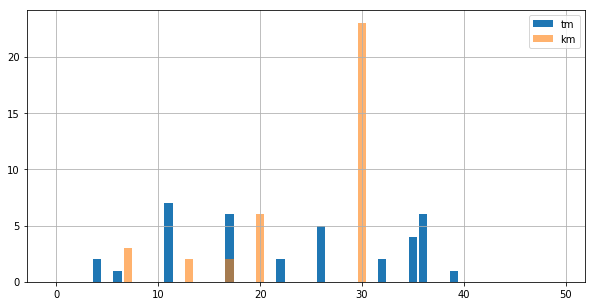


monitor(snmp)
#class(tm)	 7
	 Counter({2.0: 45, 23.0: 9, 39.0: 9, 36.0: 8, 20.0: 7, 34.0: 1, 24.0: 1})
	Entropy:	 1.3681921620671036
#class(km)	 7
	 Counter({30: 27, 0: 23, 29: 12, 11: 7, 7: 5, 28: 4, 4: 2})
	Entropy:	 1.6379907027101255


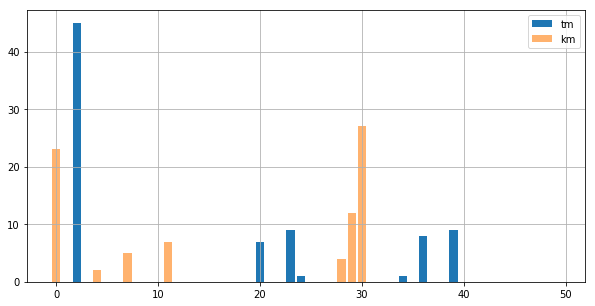


interface(if_event)
#class(tm)	 1
	 Counter({23.0: 133})
	Entropy:	 0.0
#class(km)	 4
	 Counter({4: 44, 11: 34, 38: 34, 36: 21})
	Entropy:	 1.3547714533458561


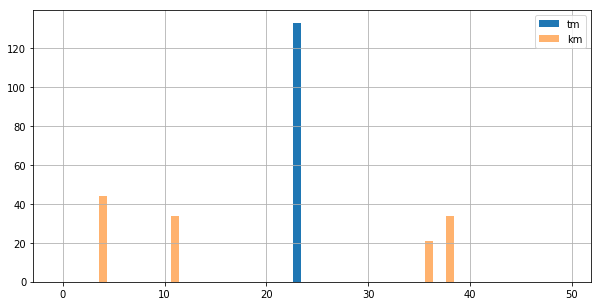


interface(vlan)
#class(tm)	 2
	 Counter({0.0: 4, 4.0: 2})
	Entropy:	 0.6365141682948128
#class(km)	 1
	 Counter({30: 6})
	Entropy:	 0.0


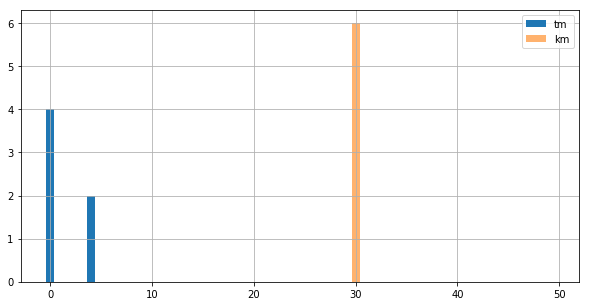


mgmt(enable)
#class(tm)	 2
	 Counter({4.0: 1, 7.0: 1})
	Entropy:	 0.6931471805599453
#class(km)	 1
	 Counter({30: 2})
	Entropy:	 0.0


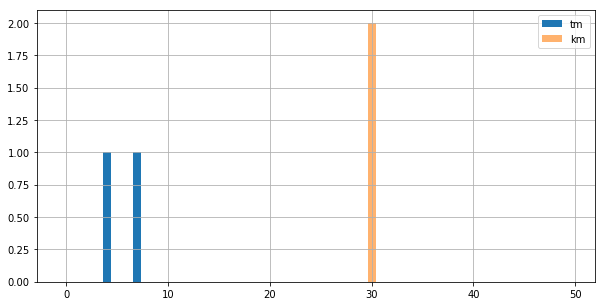


vpn(mpls)
#class(tm)	 1
	 Counter({22.0: 85})
	Entropy:	 0.0
#class(km)	 3
	 Counter({39: 33, 8: 32, 22: 20})
	Entropy:	 1.0755577989719056


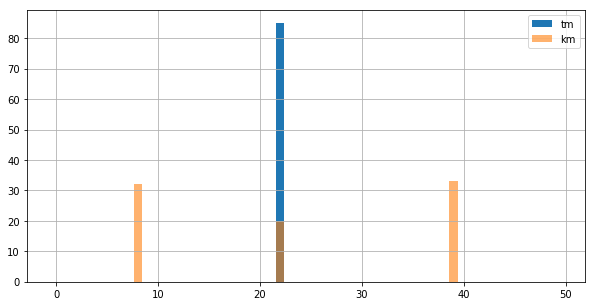


network(stp)
#class(tm)	 4
	 Counter({26.0: 5, 22.0: 5, 23.0: 1, 39.0: 1})
	Entropy:	 1.14370838942625
#class(km)	 2
	 Counter({17: 8, 30: 4})
	Entropy:	 0.6365141682948128


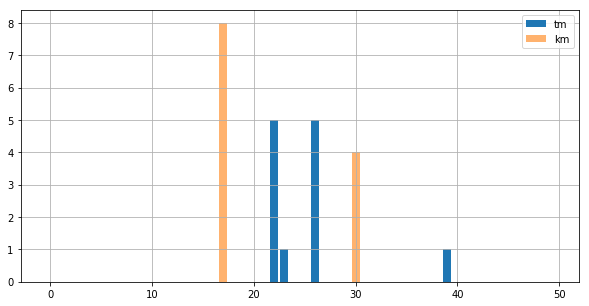


igp(ospf)
#class(tm)	 1
	 Counter({11.0: 15})
	Entropy:	 0.0
#class(km)	 1
	 Counter({6: 15})
	Entropy:	 0.0


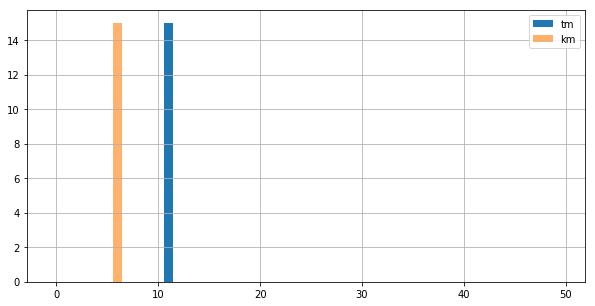


network(rsvp)
#class(tm)	 3
	 Counter({11.0: 8, 22.0: 4, 23.0: 2})
	Entropy:	 0.9556998911125343
#class(km)	 2
	 Counter({37: 10, 17: 4})
	Entropy:	 0.5982695885852573


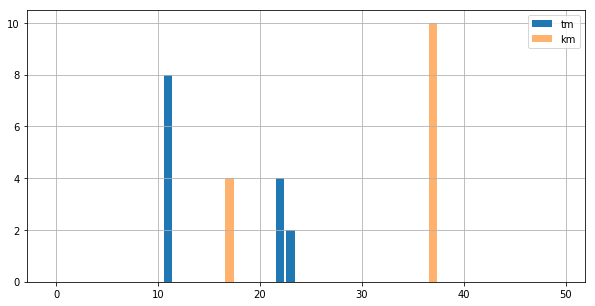


vpn(l2vc)
#class(tm)	 2
	 Counter({26.0: 1, 23.0: 1})
	Entropy:	 0.6931471805599453
#class(km)	 1
	 Counter({17: 2})
	Entropy:	 0.0


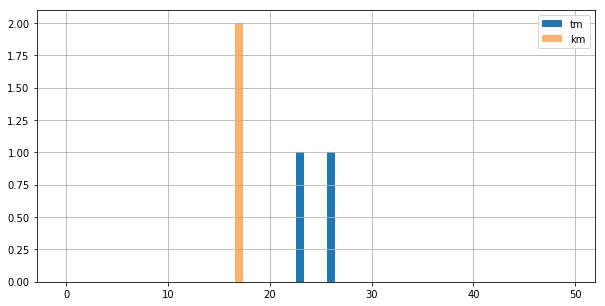


vpn(vpls)
#class(tm)	 2
	 Counter({27.0: 1, 5.0: 1})
	Entropy:	 0.6931471805599453
#class(km)	 1
	 Counter({17: 2})
	Entropy:	 0.0


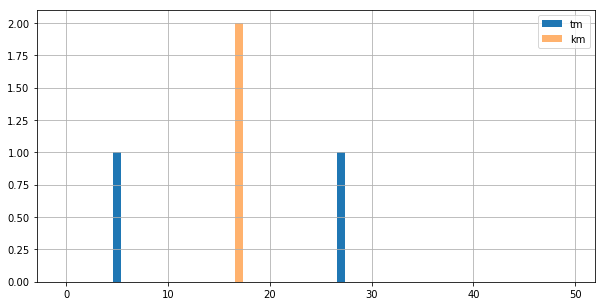


network(tcp)
#class(tm)	 1
	 Counter({17.0: 4})
	Entropy:	 0.0
#class(km)	 1
	 Counter({30: 4})
	Entropy:	 0.0


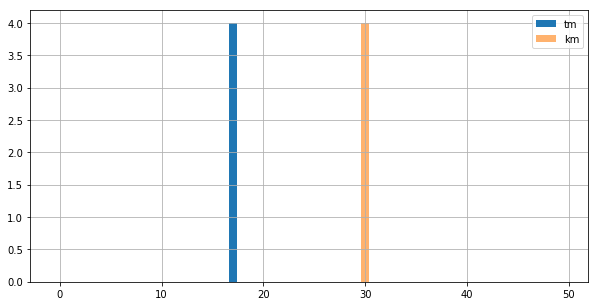


system(fan)
#class(tm)	 1
	 Counter({26.0: 2})
	Entropy:	 0.0
#class(km)	 1
	 Counter({34: 2})
	Entropy:	 0.0


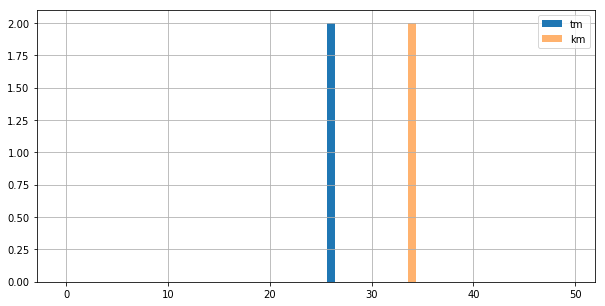


mgmt(ftp)
#class(tm)	 2
	 Counter({17.0: 2, 7.0: 2})
	Entropy:	 0.6931471805599453
#class(km)	 1
	 Counter({30: 4})
	Entropy:	 0.0


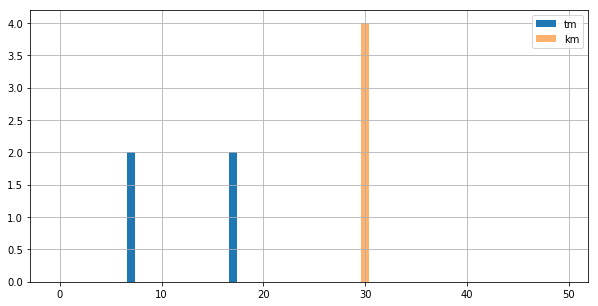


network(sfp)
#class(tm)	 1
	 Counter({11.0: 9})
	Entropy:	 0.0
#class(km)	 1
	 Counter({15: 9})
	Entropy:	 0.0


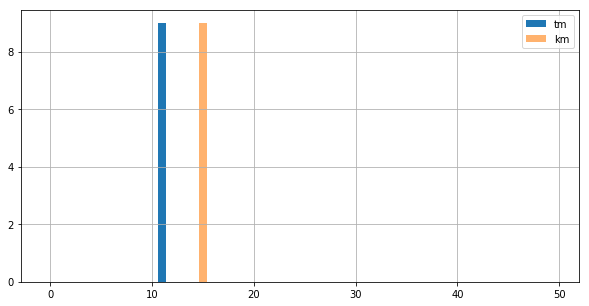


system(power)
#class(tm)	 2
	 Counter({16.0: 6, 32.0: 2})
	Entropy:	 0.5623351446188083
#class(km)	 2
	 Counter({30: 6, 34: 2})
	Entropy:	 0.5623351446188083


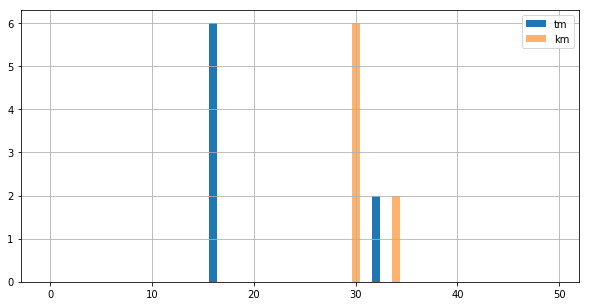


system(system_conf)
#class(tm)	 1
	 Counter({32.0: 1})
	Entropy:	 0.0
#class(km)	 1
	 Counter({34: 1})
	Entropy:	 0.0


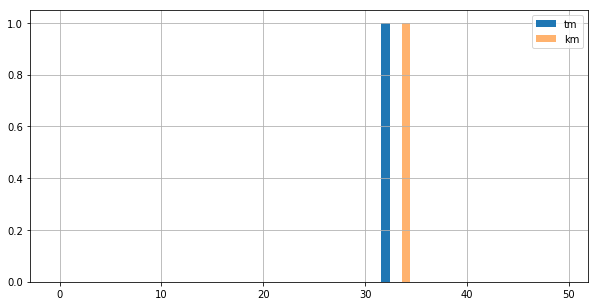


network(socket)
#class(tm)	 5
	 Counter({0.0: 2, 16.0: 1, 26.0: 1, 18.0: 1, 6.0: 1})
	Entropy:	 1.5607104090414063
#class(km)	 3
	 Counter({30: 3, 24: 2, 2: 1})
	Entropy:	 1.0114042647073516


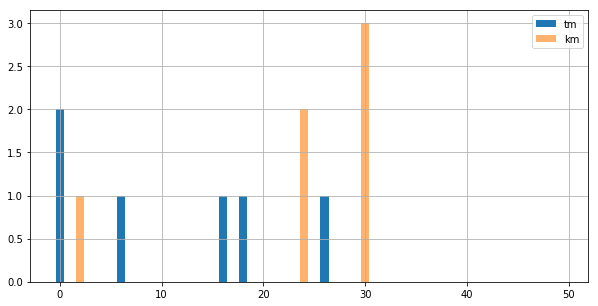


system(tnp)
#class(tm)	 2
	 Counter({17.0: 5, 37.0: 1})
	Entropy:	 0.45056120886630463
#class(km)	 2
	 Counter({30: 3, 7: 3})
	Entropy:	 0.6931471805599453


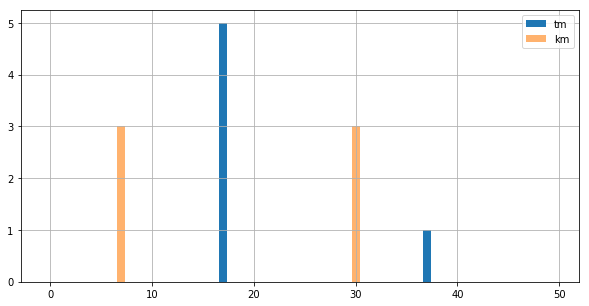


system(alarm)
#class(tm)	 1
	 Counter({34.0: 45})
	Entropy:	 0.0
#class(km)	 4
	 Counter({26: 21, 18: 10, 33: 10, 30: 4})
	Entropy:	 1.2392880342913786


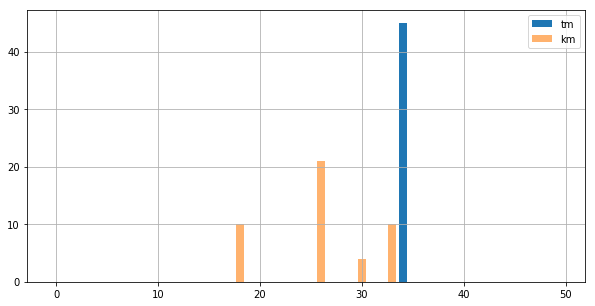


system(gres)
#class(tm)	 2
	 Counter({16.0: 4, 38.0: 3})
	Entropy:	 0.6829081047004717
#class(km)	 1
	 Counter({30: 7})
	Entropy:	 0.0


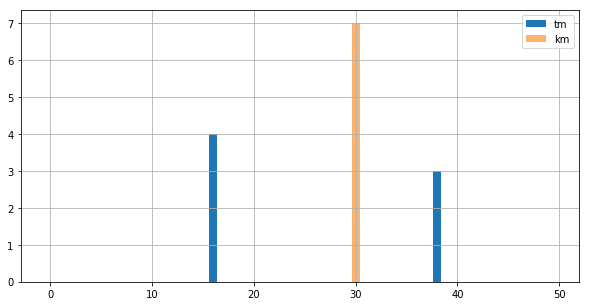


network(pim)
#class(tm)	 1
	 Counter({22.0: 4})
	Entropy:	 0.0
#class(km)	 1
	 Counter({17: 4})
	Entropy:	 0.0


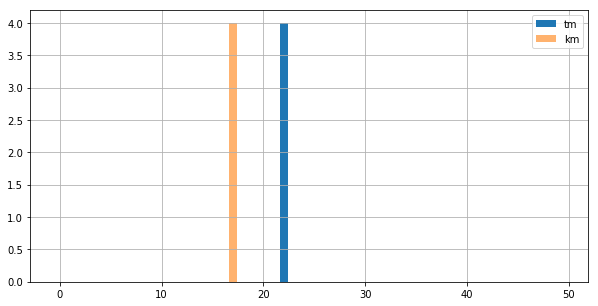


egp(msdp)
#class(tm)	 1
	 Counter({22.0: 10})
	Entropy:	 0.0
#class(km)	 1
	 Counter({17: 10})
	Entropy:	 0.0


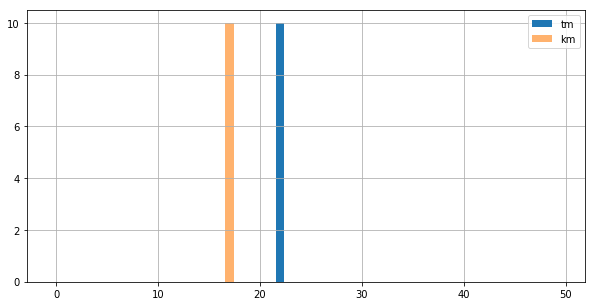


interface(interface)
#class(tm)	 3
	 Counter({24.0: 3, 4.0: 1, 19.0: 1})
	Entropy:	 0.9502705392332347
#class(km)	 1
	 Counter({30: 5})
	Entropy:	 0.0


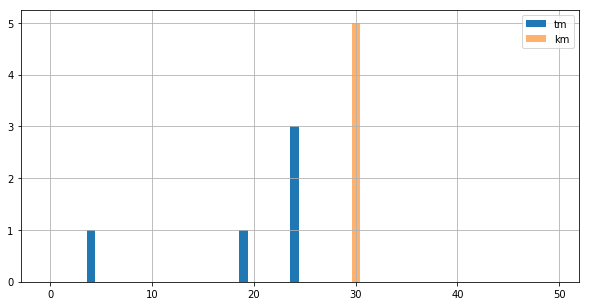


system(others)
#class(tm)	 2
	 Counter({1.0: 4, 6.0: 2})
	Entropy:	 0.6365141682948128
#class(km)	 2
	 Counter({30: 4, 17: 2})
	Entropy:	 0.6365141682948128


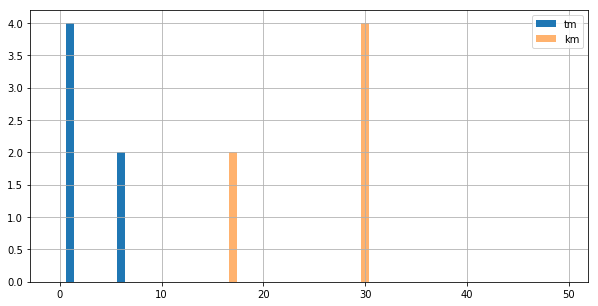


system(config_apply)
#class(tm)	 1
	 Counter({3.0: 2})
	Entropy:	 0.0
#class(km)	 1
	 Counter({17: 2})
	Entropy:	 0.0


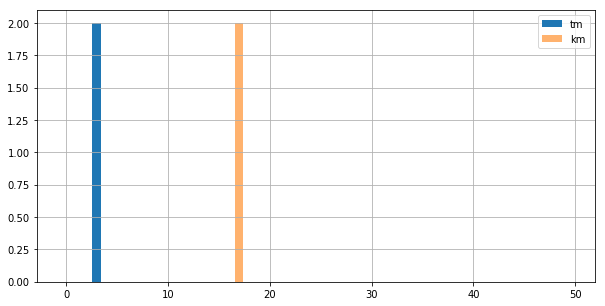


mgmt(config_process)
#class(tm)	 1
	 Counter({7.0: 1})
	Entropy:	 0.0
#class(km)	 1
	 Counter({7: 1})
	Entropy:	 0.0


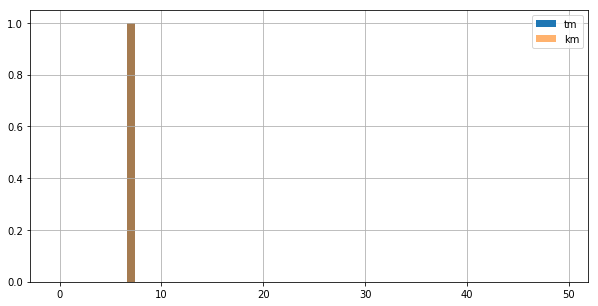


network(routing)
#class(tm)	 1
	 Counter({22.0: 4})
	Entropy:	 0.0
#class(km)	 1
	 Counter({17: 4})
	Entropy:	 0.0


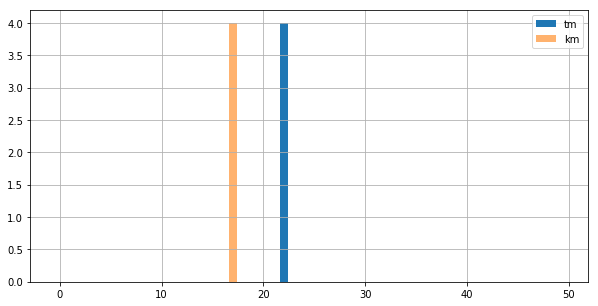


mgmt(ui_error)
#class(tm)	 3
	 Counter({33.0: 2, 36.0: 2, 22.0: 1})
	Entropy:	 1.0549201679861442
#class(km)	 2
	 Counter({30: 4, 17: 1})
	Entropy:	 0.5004024235381879


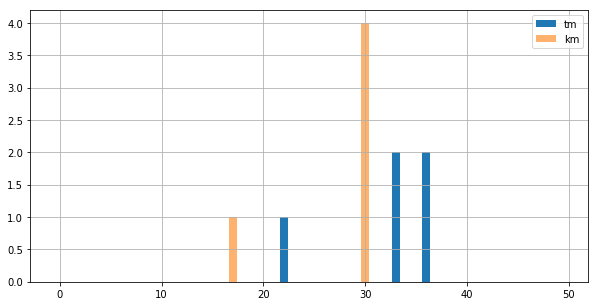


system(None)
#class(tm)	 37
	 Counter({4.0: 20, 5.0: 14, 36.0: 13, 21.0: 12, 32.0: 12, 1.0: 12, 14.0: 11, 18.0: 11, 6.0: 9, 11.0: 8, 17.0: 8, 27.0: 7, 22.0: 7, 16.0: 7, 7.0: 6, 35.0: 6, 39.0: 6, 31.0: 5, 30.0: 5, 10.0: 5, 26.0: 4, 25.0: 4, 15.0: 4, 13.0: 4, 0.0: 3, 9.0: 3, 34.0: 3, 20.0: 3, 12.0: 3, 24.0: 2, 37.0: 2, 38.0: 2, 19.0: 2, 3.0: 2, 29.0: 1, 23.0: 1, 8.0: 1})
	Entropy:	 3.3753503255954644
#class(km)	 9
	 Counter({30: 168, 7: 17, 17: 16, 34: 10, 24: 6, 14: 4, 20: 4, 16: 2, 15: 1})
	Entropy:	 1.0451129450073904


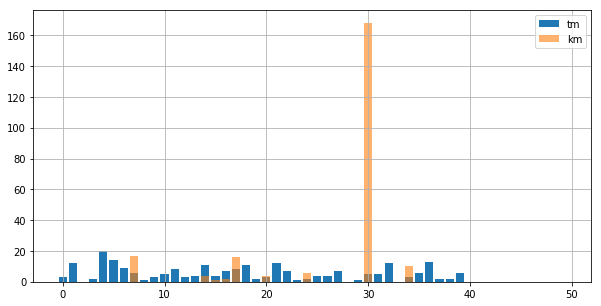


system(cos)
#class(tm)	 4
	 Counter({14.0: 4, 16.0: 2, 26.0: 2, 19.0: 2})
	Entropy:	 1.3321790402101223
#class(km)	 1
	 Counter({30: 10})
	Entropy:	 0.0


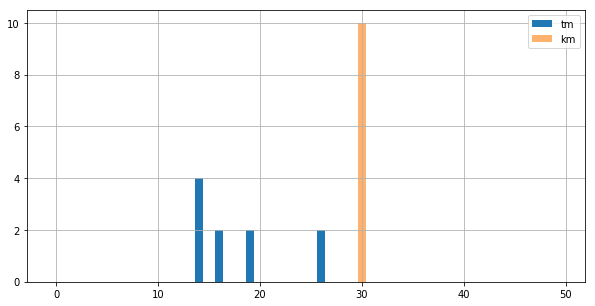


system(ppm)
#class(tm)	 1
	 Counter({36.0: 3})
	Entropy:	 0.0
#class(km)	 2
	 Counter({7: 2, 30: 1})
	Entropy:	 0.6365141682948128


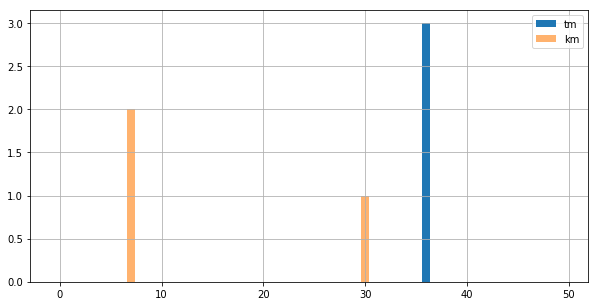


monitor(bfd)
#class(tm)	 1
	 Counter({39.0: 3})
	Entropy:	 0.0
#class(km)	 1
	 Counter({30: 3})
	Entropy:	 0.0


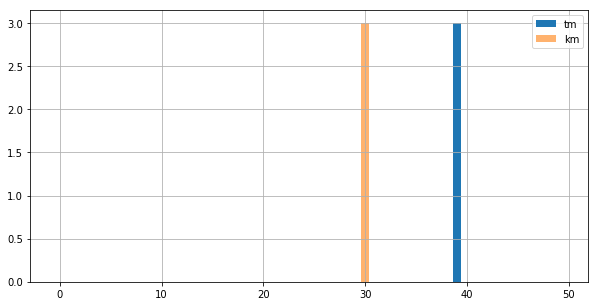


system(lisence)
#class(tm)	 3
	 Counter({8.0: 2, 1.0: 1, 17.0: 1})
	Entropy:	 1.0397207708399179
#class(km)	 3
	 Counter({7: 2, 24: 1, 30: 1})
	Entropy:	 1.0397207708399179


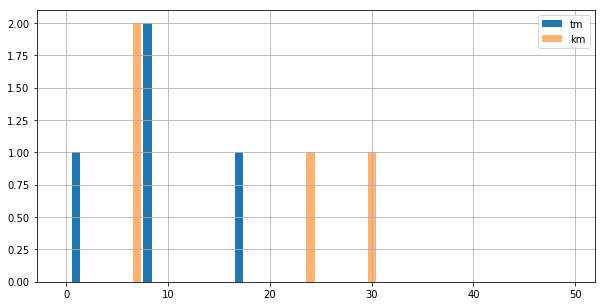


network(icmp)
#class(tm)	 1
	 Counter({34.0: 2})
	Entropy:	 0.0
#class(km)	 1
	 Counter({7: 2})
	Entropy:	 0.0


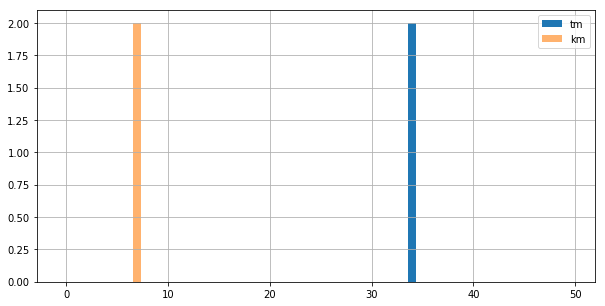


system(csu)
#class(tm)	 3
	 Counter({16.0: 3, 20.0: 2, 0.0: 1})
	Entropy:	 1.0114042647073516
#class(km)	 2
	 Counter({30: 5, 24: 1})
	Entropy:	 0.45056120886630463


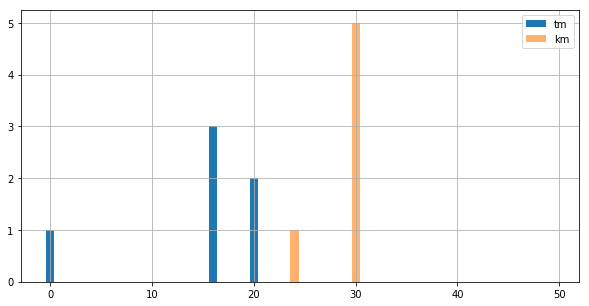


system(boot)
#class(tm)	 2
	 Counter({10.0: 2, 17.0: 2})
	Entropy:	 0.6931471805599453
#class(km)	 2
	 Counter({31: 2, 30: 2})
	Entropy:	 0.6931471805599453


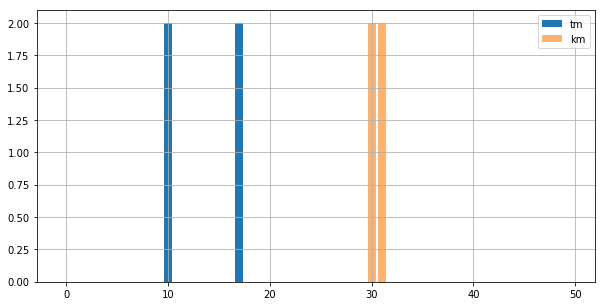


system(pci)
#class(tm)	 2
	 Counter({0.0: 12, 39.0: 5})
	Entropy:	 0.605797499372304
#class(km)	 2
	 Counter({24: 12, 19: 5})
	Entropy:	 0.605797499372304


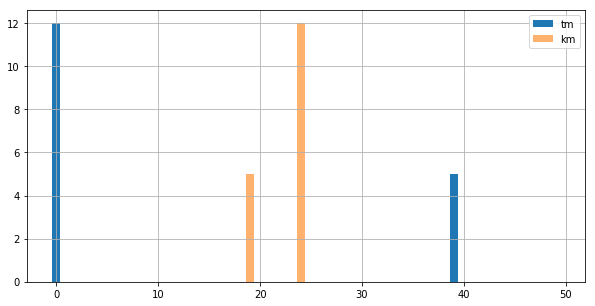


interface(inet6)
#class(tm)	 1
	 Counter({31.0: 1})
	Entropy:	 0.0
#class(km)	 1
	 Counter({30: 1})
	Entropy:	 0.0


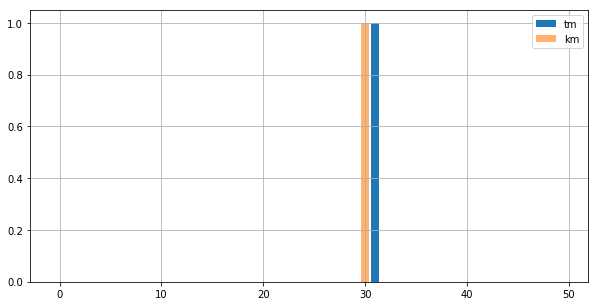


network(lldp)
#class(tm)	 1
	 Counter({3.0: 2})
	Entropy:	 0.0
#class(km)	 1
	 Counter({12: 2})
	Entropy:	 0.0


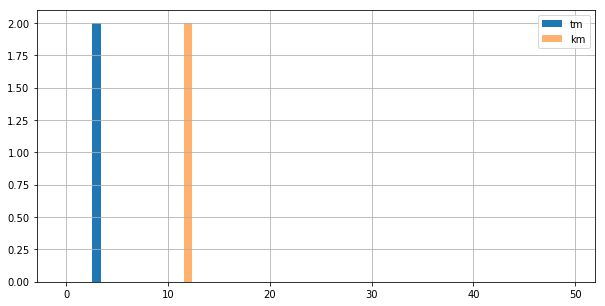


network(mcsnoop)
#class(tm)	 1
	 Counter({3.0: 2})
	Entropy:	 0.0
#class(km)	 1
	 Counter({12: 2})
	Entropy:	 0.0


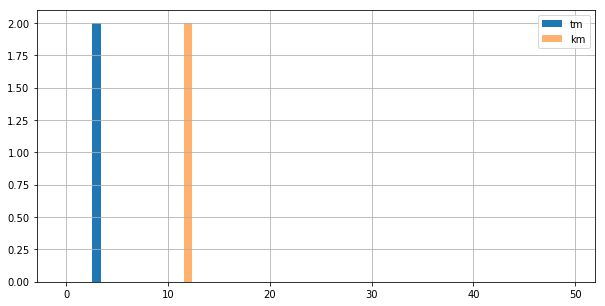

In [334]:
for cat in lt_per_cat.keys():
    print(cat)

    rows = vecs_df[vecs_df['gt']==cat]
    print("#class(tm)\t", len(set(rows['tm'])))
    print("\t", collections.Counter(rows['tm']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['tm']).values())))
    
    print("#class(km)\t", len(set(rows['km'])))
    print("\t", collections.Counter(rows['km']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['km']).values())))

    tm_y = np.zeros(50)
    km_y = np.zeros(50)
    
    for k,v in collections.Counter(rows['tm']).items():
        tm_y[int(k)] = v
    for k,v in collections.Counter(rows['km']).items():
        km_y[k] = v
    
    plt.figure(figsize=(10, 5))
    plt.bar(np.arange(50), tm_y, label="tm")
    plt.bar(np.arange(50), km_y, label="km", alpha=0.6)
    plt.legend()
    plt.grid()
    plt.show()

    print()

In [364]:
import matplotlib as mpl
mpl.rcParams['lines.linewidth'] = 2
mpl.rcParams['lines.color'] = 'r'
mpl.rcParams['axes.titlesize'] = 20
mpl.rcParams['font.size'] = 15
mpl.rcParams['axes.labelsize'] = 20
mpl.rcParams['lines.markersize'] = 12
mpl.rcParams['xtick.major.size'] = 15
mpl.rcParams['xtick.minor.size'] = 15
mpl.rcParams['ytick.major.size'] = 15

mpl.rcParams['text.usetex'] = False
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42


In [770]:
gt_ent = {}
for cat in lt_per_cat.keys():
    rows = vecs_df[vecs_df['gt']==cat]
    class_t = len(set(rows['tm']))
    hist = np.array(list(collections.Counter(rows['tm']).values()))
    hist_max = hist.sum()
    ent_t = entropy(hist/hist_max)
    
    class_k = len(set(rows['km']))
    hist = np.array(list(collections.Counter(rows['km']).values()))
    hist_max = hist.sum()
    ent_k = entropy(hist/hist_max)
    
    gt_ent[cat] = ((class_t, ent_t), (class_k, ent_k))

In [821]:
print(np.array(y_tm).mean())
print(np.array(y_tm).std())
print(np.array(y_km).mean())
print(np.array(y_km).std())

0.5871251004572825
0.6039589279807938
0.4036934780945692
0.4758639899948731


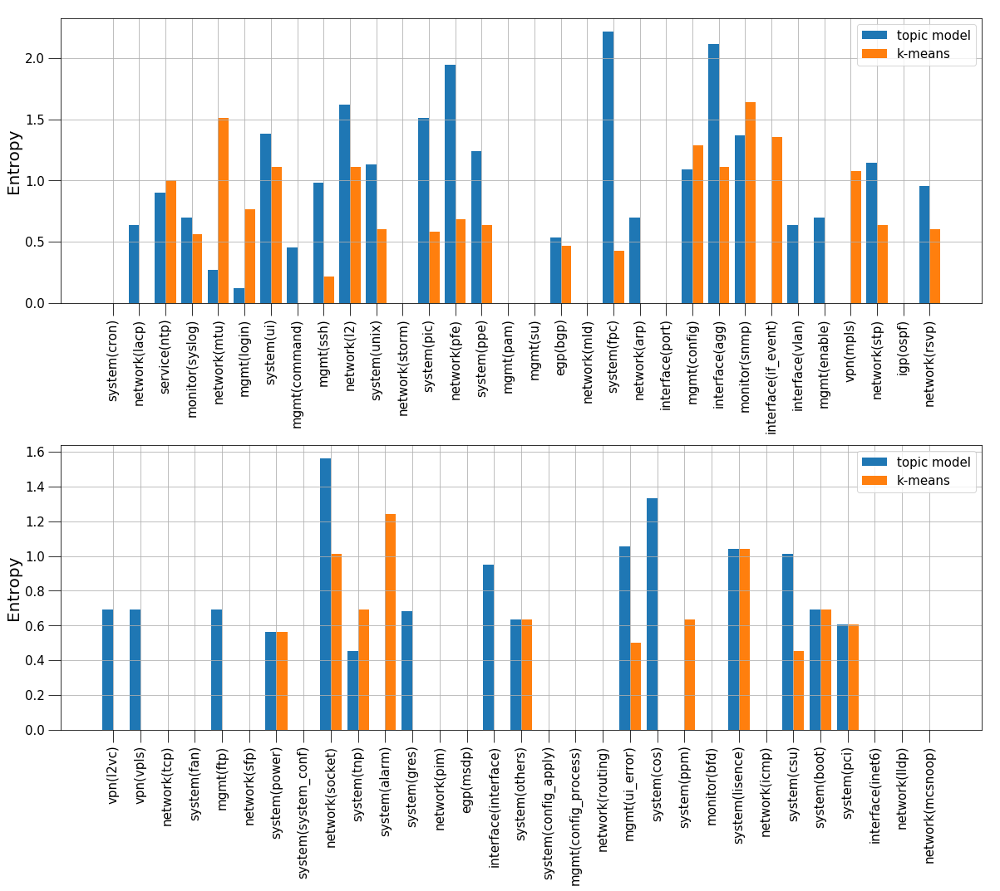

In [822]:
gt_ent_item = [(k,v) for k,v in gt_ent.items()]
x = [k for k,v in gt_ent_item if k!="system(None)"]
y_tm = []
y_km = []

for p, cat in enumerate(x):
    if cat != "system(None)":
        y_tm.append(gt_ent[cat][0][1])
        y_km.append(gt_ent[cat][1][1])

plt.figure(figsize=(20, 14))
plt.subplot(211)
plt.subplots_adjust(top=0.95, bottom=0.1, left=0.18, right=0.95, hspace=0.5)
plt.bar(np.arange(32)-0.2, y_tm[:32], label="topic model", width=0.4)
plt.bar(np.arange(32)+0.2, y_km[:32], label="k-means", width=0.4)
plt.xticks(np.arange(32), x[:32], rotation=90)
plt.legend()
plt.ylabel("Entropy")
plt.grid()

plt.subplot(212)
plt.bar(np.arange(31)-0.2, y_tm[32:], label="topic model", width=0.4)
plt.bar(np.arange(31)+0.2, y_km[32:], label="k-means", width=0.4)
plt.xticks(np.arange(31), x[32:], rotation=90)
plt.legend()
plt.ylabel("Entropy")
plt.grid()


plt.show()

In [823]:
inf_ent = {}
for idx in range(40):
    
    rows = vecs_df[vecs_df['tm']==idx]
    ent_t = entropy(list([v for k,v in collections.Counter(rows['gt']).items() if k != "system(None)"]))
    
    rows = vecs_df[vecs_df['km']==idx]
    ent_k = entropy(list([v for k,v in collections.Counter(rows['gt']).items() if k != "system(None)"]))
    
    inf_ent[idx] = ((ent_t, ent_k))

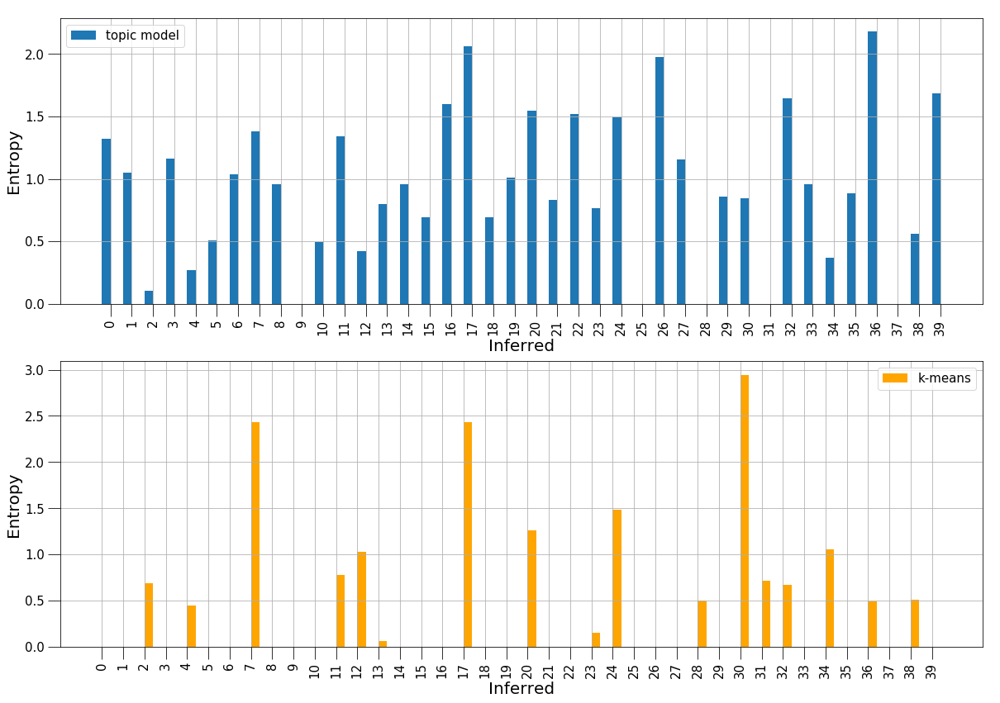

In [859]:
# gt_ent_item = [(k,v) for k,v in gt_ent.items()]
x = np.arange(40)
y_tm = []
y_km = []

for idx in range(40):
    y_tm.append(inf_ent[idx][0])
    y_km.append(inf_ent[idx][1])

plt.figure(figsize=(20, 14))
plt.subplot(211)

plt.bar(np.arange(40)-0.2, y_tm, label="topic model", width=0.4)
plt.xticks(np.arange(40), rotation=90)
plt.legend()
plt.ylabel("Entropy")
plt.xlabel("Inferred")
plt.grid()

plt.subplot(212)
plt.bar(np.arange(40)+0.2, y_km, label="k-means", color="orange",width=0.4)
plt.xticks(np.arange(40), rotation=90)
plt.legend()
plt.ylabel("Entropy")
plt.xlabel("Inferred")
plt.grid()

plt.show()

In [825]:
print(np.array(y_tm).mean())
print(np.array(y_tm).std())
print(np.array(y_km).mean())
print(np.array(y_km).std())

0.928897118552834
0.5889493467170582
0.44131184730897155
0.7367215403006058


In [834]:
type(row[1]['tm'])

float

In [868]:

t = dict()

for row in vecs_df[vecs_df["gt"]=="igp(ospf)"].iterrows():
    if row[1]['tm'] in t:
        t[row[1]['tm']].append(row[1]['lt'] )
    else:
        t[row[1]['tm']] = [row[1]['lt']]

t

{11.0: ['**:rpd[**]: RPD_OSPF_NBRDOWN: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to KillNbr (event reason: interface went down)',
  'rpd[**]: RPD_OSPF_NBRDOWN: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to KillNbr (event reason: interface went down)',
  '**:rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to 2WayRcvd (event reason: neighbor detected this router)',
  'rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to 2WayRcvd (event reason: neighbor detected this router)',
  '**:rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to LoadDone (event reason: OSPF loading completed)',
  'rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to LoadDone (event reason: OSPF loading completed)',
  '**:rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** ar

In [867]:
t = dict()

for row in vecs_df[vecs_df["gt"]=="network(mtu)"].iterrows():
    if row[1]['km'] in t:
        t[row[1]['km']].append(row[1]['lt'] )
    else:
        t[row[1]['km']] = [row[1]['lt']]

t

{4: ['**: rpd[**]: EVENT <MTU> index ** <Broadcast Multicast>',
  'rpd[**]: EVENT <MTU> index ** <Broadcast Multicast>',
  'rpd[**]: EVENT <MTU> ** index ** <Broadcast PointToPoint Multicast>',
  'rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast>'],
 7: ['/kernel: MTU for ** reduced to **',
  '** /kernel: MTU for ** reduced to **'],
 11: ['rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast> address #** **',
  '**: rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast>',
  '**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>',
  'mcsn[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>',
  'rpd[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>',
  'rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Loopback Multicast>'],
 36: ['**: rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast> address #** **',
  'mcsn[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **',
  '**: rpd[**]: EVENT <MTU> index ** <Broadc

In [391]:
print(np.array(y_tm).mean())
print(np.array(y_tm).std())
print()
print(np.array(y_km).mean())
print(np.array(y_km).std())

0.6306911196000665
0.6918387004241149

0.4137156572650821
0.47878626398337043


In [406]:
print(np.array(y_tm).mean())
print(np.array(y_tm).std())
print()
print(np.array(y_km).mean())
print(np.array(y_km).std())

1.129345669747059
0.5577116324738317

0.4664213644894891
0.6991958053264574


0
#class(tm)	 7
	 Counter({'service(ntp)': 26, 'system(pci)': 12, 'system(unix)': 5, 'interface(vlan)': 4, 'system(None)': 3, 'network(socket)': 2, 'system(csu)': 1})
	Entropy:	 1.4645581773296912
#class(km)	 1
	 Counter({'monitor(snmp)': 23})
	Entropy:	 0.0


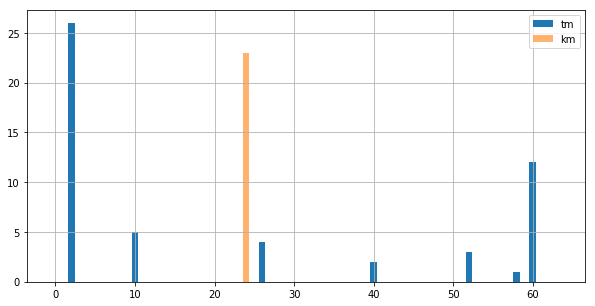


1
#class(tm)	 6
	 Counter({'network(pfe)': 13, 'system(None)': 12, 'system(others)': 4, 'system(pic)': 1, 'egp(bgp)': 1, 'system(lisence)': 1})
	Entropy:	 1.3185984375204909
#class(km)	 1
	 Counter({'mgmt(config)': 167})
	Entropy:	 0.0


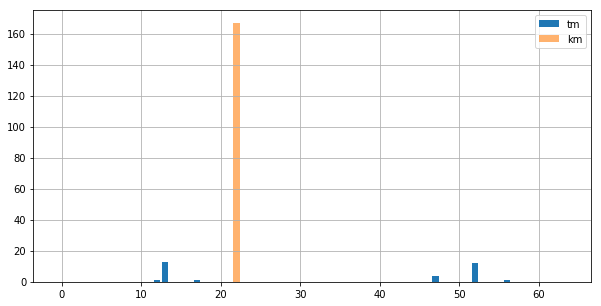


2
#class(tm)	 2
	 Counter({'monitor(snmp)': 45, 'system(unix)': 1})
	Entropy:	 0.10473243910508653
#class(km)	 2
	 Counter({'network(pfe)': 1, 'network(socket)': 1})
	Entropy:	 0.6931471805599453


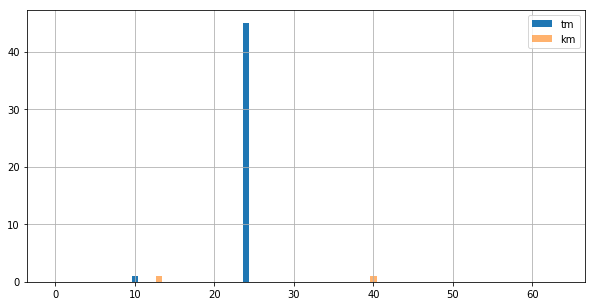


3
#class(tm)	 7
	 Counter({'mgmt(config)': 18, 'network(l2)': 2, 'system(config_apply)': 2, 'system(None)': 2, 'network(lldp)': 2, 'network(mcsnoop)': 2, 'egp(bgp)': 1})
	Entropy:	 1.3342557110992181
#class(km)	 1
	 Counter({'mgmt(ssh)': 17})
	Entropy:	 0.0


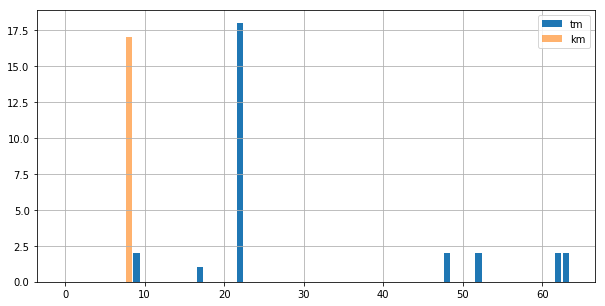


4
#class(tm)	 8
	 Counter({'mgmt(config)': 185, 'system(None)': 20, 'service(ntp)': 2, 'interface(agg)': 2, 'interface(vlan)': 2, 'system(ui)': 1, 'mgmt(enable)': 1, 'interface(interface)': 1})
	Entropy:	 0.5536425748633019
#class(km)	 3
	 Counter({'interface(if_event)': 44, 'network(mtu)': 4, 'monitor(snmp)': 2})
	Entropy:	 0.4433066914680872


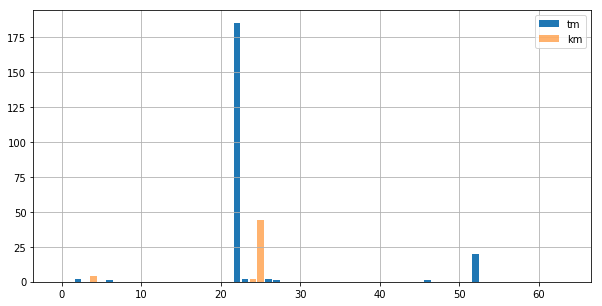


5
#class(tm)	 4
	 Counter({'system(None)': 14, 'system(fpc)': 12, 'system(ppe)': 1, 'vpn(vpls)': 1})
	Entropy:	 0.9477158526012888
#class(km)	 1
	 Counter({'mgmt(command)': 24})
	Entropy:	 0.0


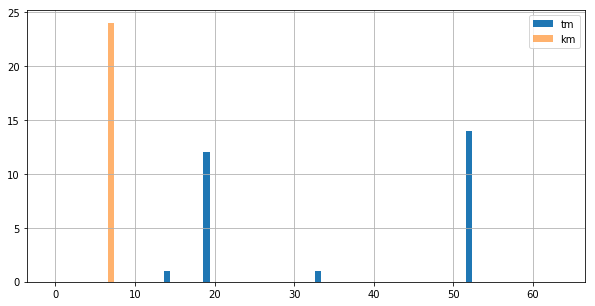


6
#class(tm)	 4
	 Counter({'system(None)': 9, 'system(others)': 2, 'interface(agg)': 1, 'network(socket)': 1})
	Entropy:	 0.9371558530657009
#class(km)	 1
	 Counter({'igp(ospf)': 15})
	Entropy:	 0.0


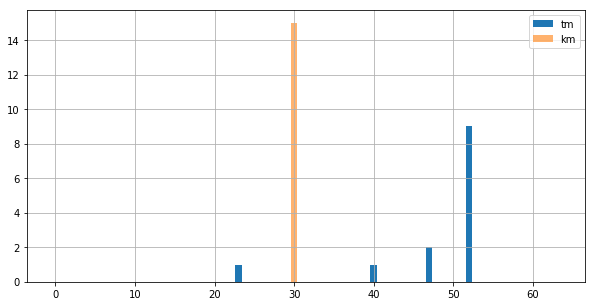


7
#class(tm)	 9
	 Counter({'mgmt(login)': 37, 'mgmt(config)': 15, 'system(ui)': 13, 'system(None)': 6, 'mgmt(pam)': 3, 'mgmt(ftp)': 2, 'system(fpc)': 1, 'mgmt(enable)': 1, 'mgmt(config_process)': 1})
	Entropy:	 1.5466409477345913
#class(km)	 14
	 Counter({'system(None)': 17, 'network(pfe)': 6, 'service(ntp)': 5, 'monitor(snmp)': 5, 'mgmt(su)': 4, 'interface(agg)': 3, 'system(tnp)': 3, 'network(mtu)': 2, 'system(fpc)': 2, 'system(ppm)': 2, 'system(lisence)': 2, 'network(icmp)': 2, 'system(pic)': 1, 'mgmt(config_process)': 1})
	Entropy:	 2.2968261712187856


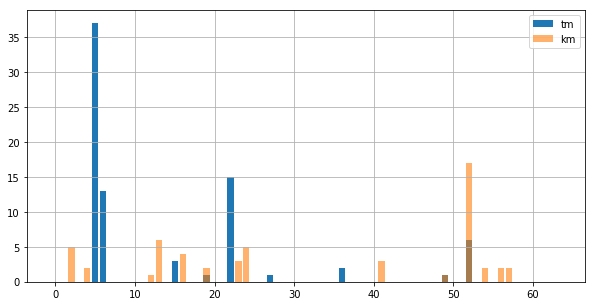


8
#class(tm)	 4
	 Counter({'system(cron)': 8, 'mgmt(command)': 4, 'system(lisence)': 2, 'system(None)': 1})
	Entropy:	 1.1369165918330009
#class(km)	 1
	 Counter({'vpn(mpls)': 32})
	Entropy:	 0.0


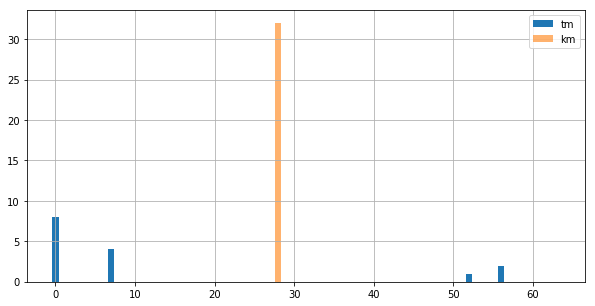


9
#class(tm)	 1
	 Counter({'system(None)': 3})
	Entropy:	 0.0
#class(km)	 1
	 Counter({'mgmt(config)': 112})
	Entropy:	 0.0


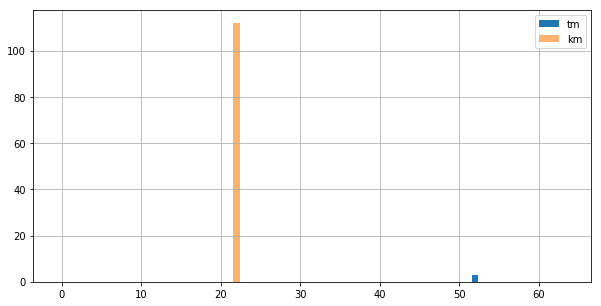


10
#class(tm)	 5
	 Counter({'mgmt(config)': 254, 'mgmt(command)': 20, 'system(ui)': 16, 'system(None)': 5, 'system(boot)': 2})
	Entropy:	 0.5752390318231878
#class(km)	 1
	 Counter({'egp(bgp)': 48})
	Entropy:	 0.0


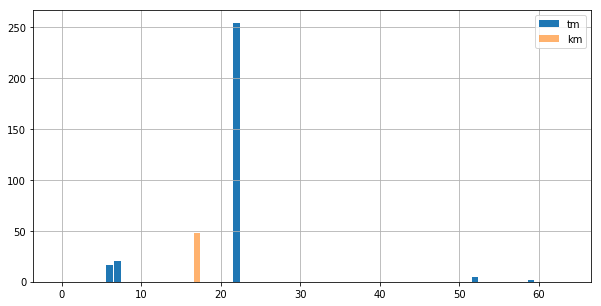


11
#class(tm)	 5
	 Counter({'igp(ospf)': 15, 'network(sfp)': 9, 'network(rsvp)': 8, 'system(None)': 8, 'interface(agg)': 7})
	Entropy:	 1.5674197310116822
#class(km)	 3
	 Counter({'interface(if_event)': 34, 'monitor(snmp)': 7, 'network(mtu)': 6})
	Entropy:	 0.7806117358439946


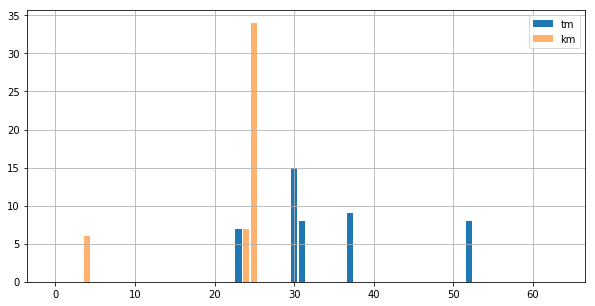


12
#class(tm)	 3
	 Counter({'system(fpc)': 17, 'system(ppe)': 3, 'system(None)': 3})
	Entropy:	 0.7547854950176571
#class(km)	 5
	 Counter({'mgmt(config)': 16, 'network(l2)': 2, 'network(lldp)': 2, 'network(mcsnoop)': 2, 'egp(bgp)': 1})
	Entropy:	 1.0259158403119248


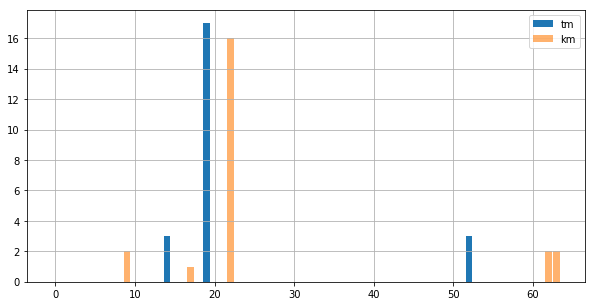


13
#class(tm)	 4
	 Counter({'system(unix)': 23, 'system(fpc)': 10, 'system(None)': 4, 'system(pic)': 2})
	Entropy:	 1.046287551208868
#class(km)	 2
	 Counter({'mgmt(config)': 185, 'interface(agg)': 2})
	Entropy:	 0.05917213556790227


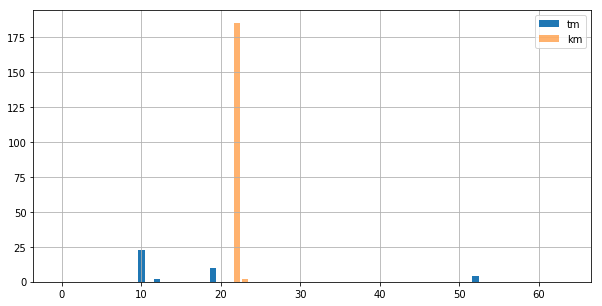


14
#class(tm)	 4
	 Counter({'system(None)': 11, 'network(pfe)': 8, 'system(cos)': 4, 'network(l2)': 2})
	Entropy:	 1.2211217392753921
#class(km)	 2
	 Counter({'system(unix)': 25, 'system(None)': 4})
	Entropy:	 0.40118986218700575


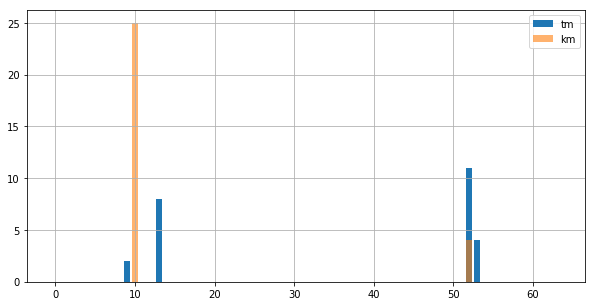


15
#class(tm)	 3
	 Counter({'system(None)': 4, 'service(ntp)': 1, 'network(pfe)': 1})
	Entropy:	 0.8675632284814612
#class(km)	 2
	 Counter({'network(sfp)': 9, 'system(None)': 1})
	Entropy:	 0.3250829733914482


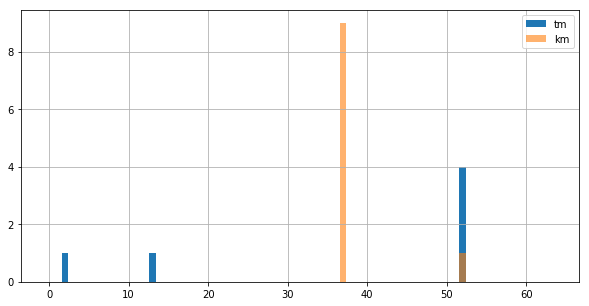


16
#class(tm)	 7
	 Counter({'system(None)': 7, 'system(power)': 6, 'system(gres)': 4, 'system(csu)': 3, 'system(cos)': 2, 'network(pfe)': 1, 'network(socket)': 1})
	Entropy:	 1.736418974916308
#class(km)	 2
	 Counter({'mgmt(login)': 10, 'system(None)': 2})
	Entropy:	 0.45056120886630463


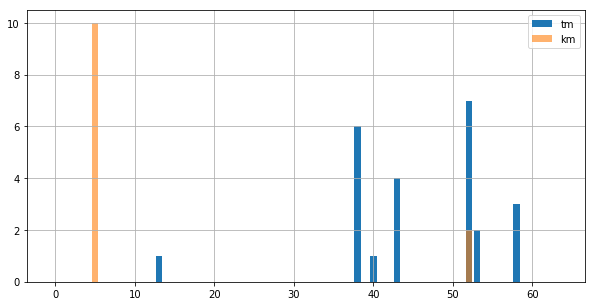


17
#class(tm)	 10
	 Counter({'system(None)': 8, 'interface(agg)': 6, 'mgmt(ssh)': 5, 'system(tnp)': 5, 'network(tcp)': 4, 'network(lacp)': 2, 'network(mtu)': 2, 'mgmt(ftp)': 2, 'system(boot)': 2, 'system(lisence)': 1})
	Entropy:	 2.1360308001548423
#class(km)	 15
	 Counter({'system(None)': 16, 'egp(msdp)': 10, 'network(stp)': 8, 'egp(bgp)': 7, 'mgmt(config)': 6, 'network(rsvp)': 4, 'network(pim)': 4, 'network(routing)': 4, 'network(l2)': 2, 'interface(agg)': 2, 'vpn(l2vc)': 2, 'vpn(vpls)': 2, 'system(others)': 2, 'system(config_apply)': 2, 'mgmt(ui_error)': 1})
	Entropy:	 2.424610158208705


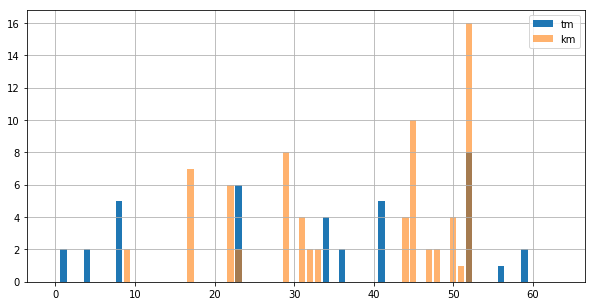


18
#class(tm)	 3
	 Counter({'system(None)': 11, 'network(mld)': 1, 'network(socket)': 1})
	Entropy:	 0.5359610497090694
#class(km)	 1
	 Counter({'system(alarm)': 10})
	Entropy:	 0.0


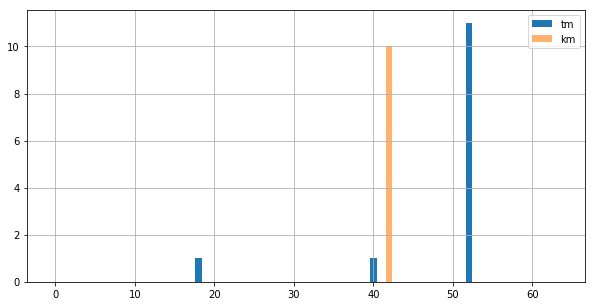


19
#class(tm)	 4
	 Counter({'system(fpc)': 3, 'system(None)': 2, 'system(cos)': 2, 'interface(interface)': 1})
	Entropy:	 1.3208883431493221
#class(km)	 1
	 Counter({'system(pci)': 5})
	Entropy:	 0.0


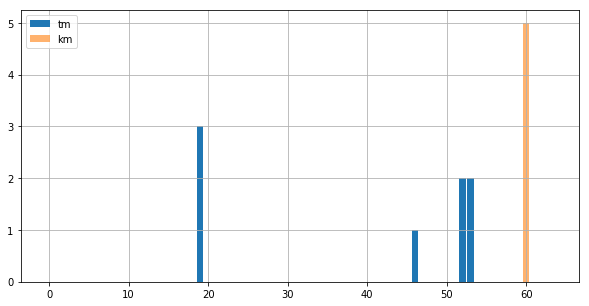


20
#class(tm)	 7
	 Counter({'system(pic)': 12, 'network(pfe)': 9, 'monitor(snmp)': 7, 'system(None)': 3, 'monitor(syslog)': 2, 'egp(bgp)': 2, 'system(csu)': 2})
	Entropy:	 1.7009181292325168
#class(km)	 5
	 Counter({'interface(port)': 10, 'network(storm)': 6, 'interface(agg)': 6, 'system(None)': 4, 'network(l2)': 2})
	Entropy:	 1.494403211379612


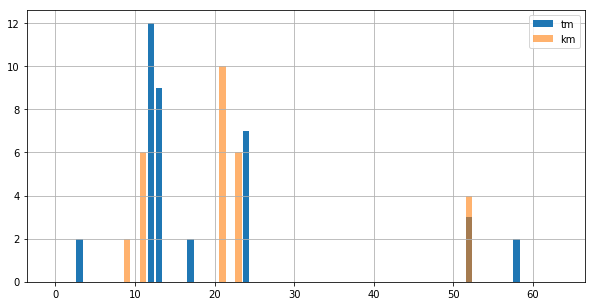


21
#class(tm)	 4
	 Counter({'system(None)': 12, 'mgmt(config)': 11, 'egp(bgp)': 3, 'system(fpc)': 2})
	Entropy:	 1.1579952592694074
#class(km)	 1
	 Counter({'service(ntp)': 14})
	Entropy:	 0.0


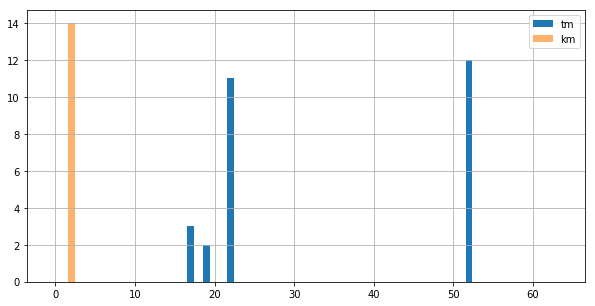


22
#class(tm)	 14
	 Counter({'vpn(mpls)': 85, 'egp(bgp)': 49, 'egp(msdp)': 10, 'system(None)': 7, 'network(stp)': 5, 'network(rsvp)': 4, 'network(pim)': 4, 'network(routing)': 4, 'system(pic)': 3, 'monitor(syslog)': 2, 'network(l2)': 2, 'interface(agg)': 2, 'network(pfe)': 1, 'mgmt(ui_error)': 1})
	Entropy:	 1.6281164470284735
#class(km)	 1
	 Counter({'vpn(mpls)': 20})
	Entropy:	 0.0


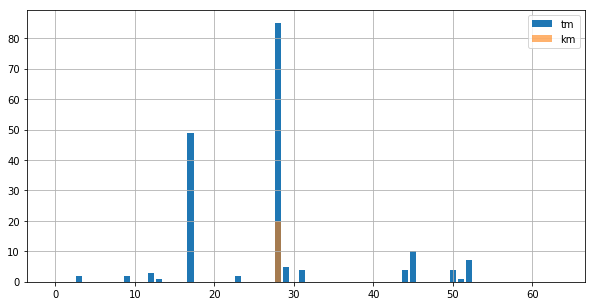


23
#class(tm)	 8
	 Counter({'interface(if_event)': 133, 'network(mtu)': 24, 'monitor(snmp)': 9, 'network(rsvp)': 2, 'system(fpc)': 1, 'network(stp)': 1, 'vpn(l2vc)': 1, 'system(None)': 1})
	Entropy:	 0.7995233050751402
#class(km)	 2
	 Counter({'system(pic)': 28, 'monitor(syslog)': 1})
	Entropy:	 0.14999492361041503


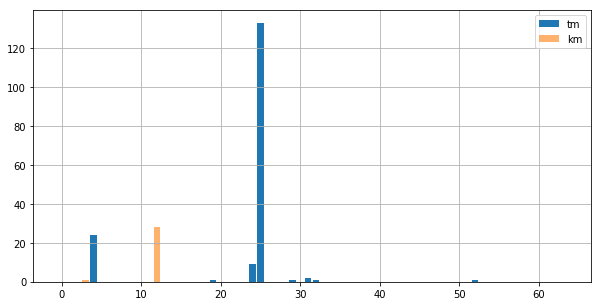


24
#class(tm)	 6
	 Counter({'interface(interface)': 3, 'network(pfe)': 2, 'system(None)': 2, 'system(unix)': 1, 'system(ppe)': 1, 'monitor(snmp)': 1})
	Entropy:	 1.6957425341696346
#class(km)	 8
	 Counter({'system(pci)': 12, 'system(fpc)': 7, 'system(None)': 6, 'system(ppe)': 2, 'network(socket)': 2, 'network(pfe)': 1, 'system(lisence)': 1, 'system(csu)': 1})
	Entropy:	 1.6856297659731232


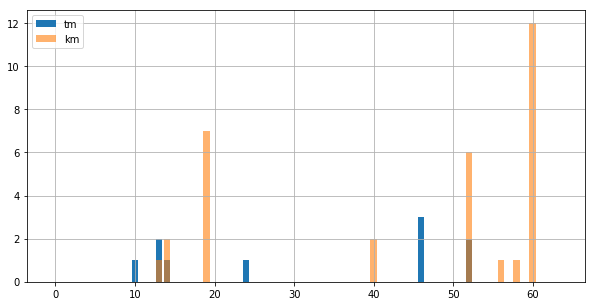


25
#class(tm)	 2
	 Counter({'system(fpc)': 10, 'system(None)': 4})
	Entropy:	 0.5982695885852573
#class(km)	 1
	 Counter({'system(ui)': 10})
	Entropy:	 0.0


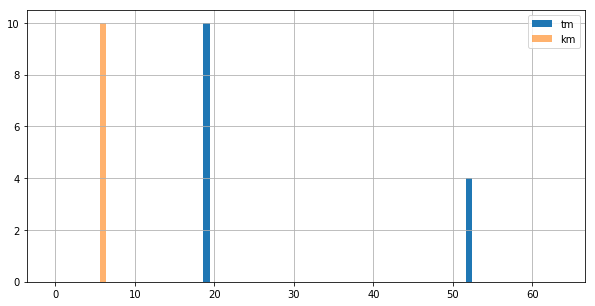


26
#class(tm)	 10
	 Counter({'network(l2)': 6, 'interface(agg)': 5, 'network(stp)': 5, 'system(None)': 4, 'service(ntp)': 2, 'system(fan)': 2, 'system(cos)': 2, 'system(fpc)': 1, 'vpn(l2vc)': 1, 'network(socket)': 1})
	Entropy:	 2.106985606967558
#class(km)	 1
	 Counter({'system(alarm)': 21})
	Entropy:	 0.0


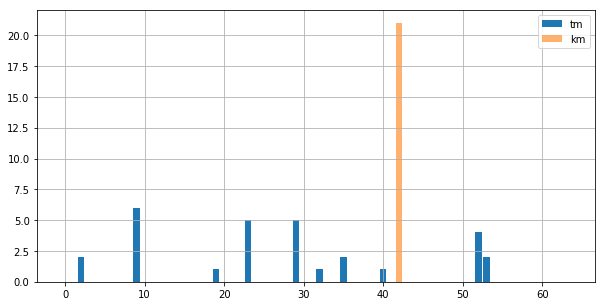


27
#class(tm)	 5
	 Counter({'system(ui)': 8, 'system(None)': 7, 'network(pfe)': 3, 'system(fpc)': 3, 'vpn(vpls)': 1})
	Entropy:	 1.4161071302294734
#class(km)	 1
	 Counter({'mgmt(login)': 26})
	Entropy:	 0.0


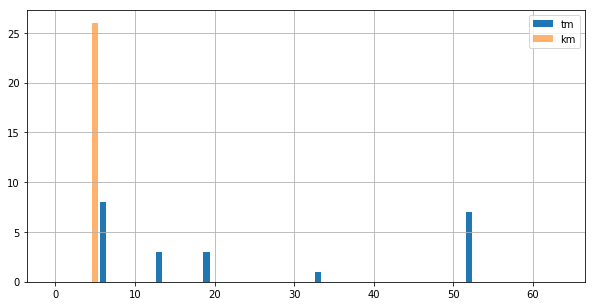


28
#class(tm)	 1
	 Counter({'system(unix)': 3})
	Entropy:	 0.0
#class(km)	 2
	 Counter({'monitor(snmp)': 4, 'network(pfe)': 1})
	Entropy:	 0.5004024235381879


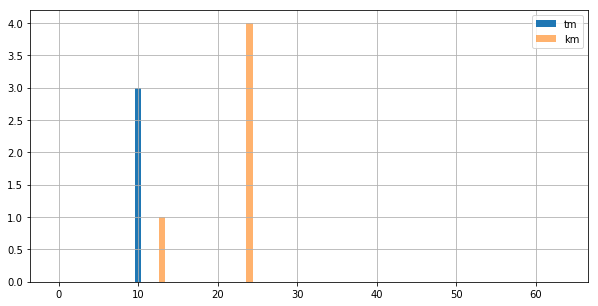


29
#class(tm)	 4
	 Counter({'mgmt(config)': 8, 'service(ntp)': 4, 'network(l2)': 1, 'system(None)': 1})
	Entropy:	 1.0547209169068124
#class(km)	 1
	 Counter({'monitor(snmp)': 12})
	Entropy:	 0.0


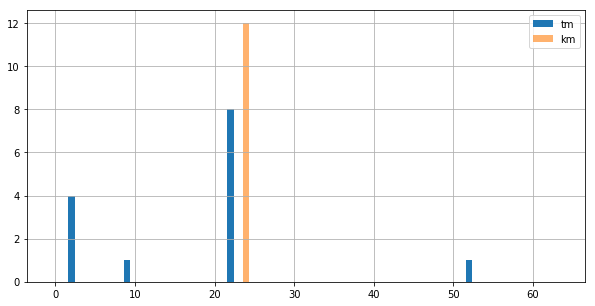


30
#class(tm)	 4
	 Counter({'system(fpc)': 6, 'system(None)': 5, 'system(unix)': 2, 'system(pic)': 1})
	Entropy:	 1.1973401339967782
#class(km)	 37
	 Counter({'system(None)': 168, 'system(fpc)': 67, 'network(pfe)': 38, 'monitor(snmp)': 27, 'interface(agg)': 23, 'service(ntp)': 16, 'system(unix)': 10, 'system(cos)': 10, 'network(l2)': 9, 'system(cron)': 8, 'system(gres)': 7, 'network(lacp)': 6, 'system(pic)': 6, 'network(arp)': 6, 'interface(vlan)': 6, 'system(power)': 6, 'interface(interface)': 5, 'system(csu)': 5, 'system(ppe)': 4, 'network(stp)': 4, 'network(tcp)': 4, 'mgmt(ftp)': 4, 'system(alarm)': 4, 'system(others)': 4, 'mgmt(ui_error)': 4, 'monitor(syslog)': 3, 'network(socket)': 3, 'system(tnp)': 3, 'monitor(bfd)': 3, 'mgmt(enable)': 2, 'system(boot)': 2, 'system(ui)': 1, 'mgmt(ssh)': 1, 'network(mld)': 1, 'system(ppm)': 1, 'system(lisence)': 1, 'interface(inet6)': 1})
	Entropy:	 2.5503491349096956


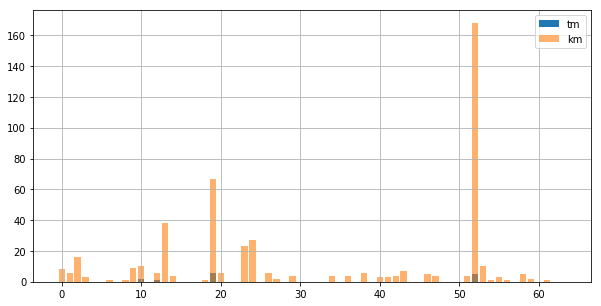


31
#class(tm)	 2
	 Counter({'system(None)': 5, 'interface(inet6)': 1})
	Entropy:	 0.45056120886630463
#class(km)	 3
	 Counter({'system(ui)': 21, 'mgmt(config)': 5, 'system(boot)': 2})
	Entropy:	 0.7119025417651226


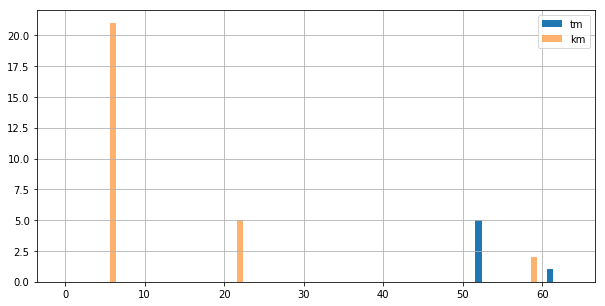


32
#class(tm)	 9
	 Counter({'system(pic)': 14, 'system(None)': 12, 'mgmt(su)': 4, 'network(arp)': 3, 'system(fpc)': 2, 'interface(agg)': 2, 'system(power)': 2, 'mgmt(ssh)': 1, 'system(system_conf)': 1})
	Entropy:	 1.7680701202186202
#class(km)	 2
	 Counter({'mgmt(pam)': 3, 'mgmt(login)': 2})
	Entropy:	 0.6730116670092565


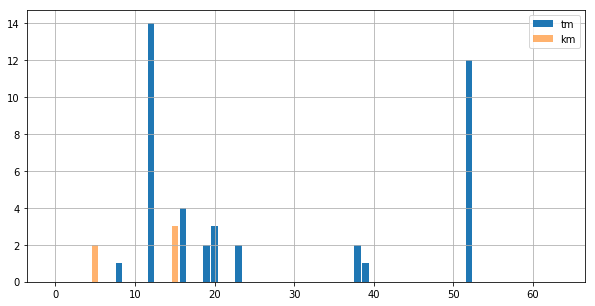


33
#class(tm)	 3
	 Counter({'system(fpc)': 8, 'network(lacp)': 4, 'mgmt(ui_error)': 2})
	Entropy:	 0.9556998911125343
#class(km)	 1
	 Counter({'system(alarm)': 10})
	Entropy:	 0.0


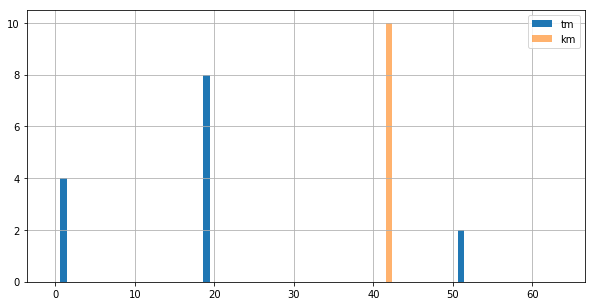


34
#class(tm)	 5
	 Counter({'system(alarm)': 45, 'system(None)': 3, 'network(icmp)': 2, 'system(pic)': 1, 'monitor(snmp)': 1})
	Entropy:	 0.5669755788354925
#class(km)	 4
	 Counter({'system(None)': 10, 'system(fan)': 2, 'system(power)': 2, 'system(system_conf)': 1})
	Entropy:	 0.9881542242901942


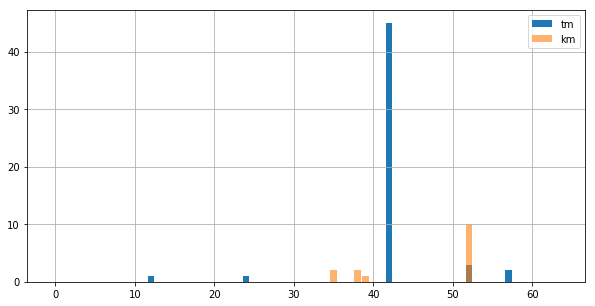


35
#class(tm)	 4
	 Counter({'network(pfe)': 7, 'system(None)': 6, 'interface(agg)': 4, 'mgmt(ssh)': 1})
	Entropy:	 1.2283103521608822
#class(km)	 1
	 Counter({'system(ui)': 9})
	Entropy:	 0.0


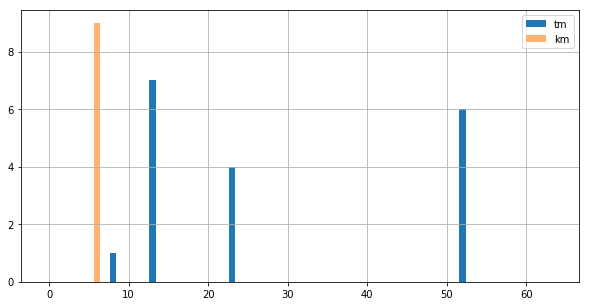


36
#class(tm)	 13
	 Counter({'system(None)': 13, 'mgmt(ssh)': 11, 'interface(port)': 10, 'monitor(snmp)': 8, 'network(storm)': 6, 'interface(agg)': 6, 'system(ppm)': 3, 'system(ui)': 2, 'network(l2)': 2, 'mgmt(ui_error)': 2, 'mgmt(login)': 1, 'system(pic)': 1, 'system(ppe)': 1})
	Entropy:	 2.245133431552761
#class(km)	 2
	 Counter({'interface(if_event)': 21, 'network(mtu)': 5})
	Entropy:	 0.4895518936229288


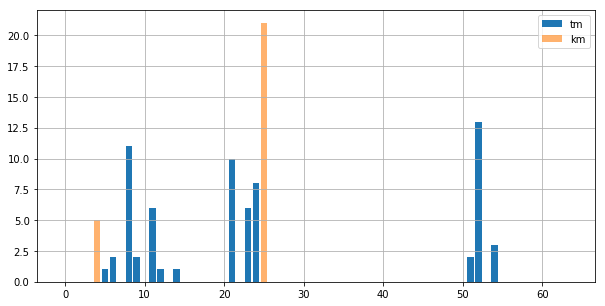


37
#class(tm)	 2
	 Counter({'system(None)': 2, 'system(tnp)': 1})
	Entropy:	 0.6365141682948128
#class(km)	 1
	 Counter({'network(rsvp)': 10})
	Entropy:	 0.0


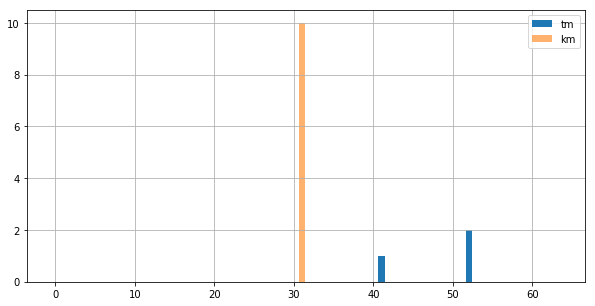


38
#class(tm)	 3
	 Counter({'system(gres)': 3, 'system(None)': 2, 'system(ui)': 1})
	Entropy:	 1.0114042647073518
#class(km)	 2
	 Counter({'interface(if_event)': 34, 'network(mtu)': 9})
	Entropy:	 0.5130308358569238


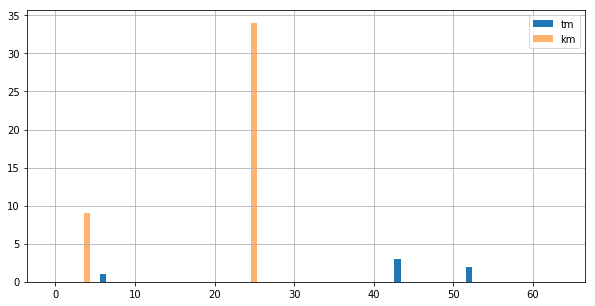


39
#class(tm)	 8
	 Counter({'monitor(snmp)': 9, 'system(None)': 6, 'system(pci)': 5, 'network(arp)': 3, 'monitor(bfd)': 3, 'network(pfe)': 2, 'interface(agg)': 1, 'network(stp)': 1})
	Entropy:	 1.8495061927723768
#class(km)	 1
	 Counter({'vpn(mpls)': 33})
	Entropy:	 0.0


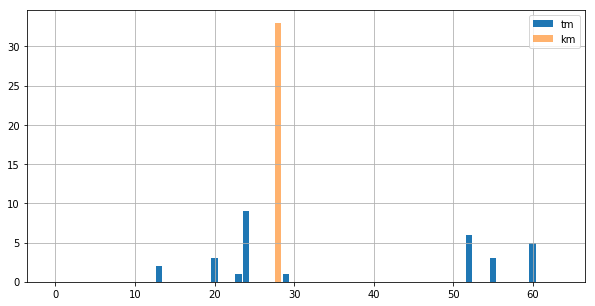

In [339]:
## 逆
cats = lt_per_cat.keys()
cats_idx = {i:e for e,i in enumerate(cats)}

for idx in range(40):
    print(idx)
    
    tm_y = np.zeros(len(cats))
    km_y = np.zeros(len(cats))
    
    rows = vecs_df[vecs_df['tm']==idx]
    print("#class(tm)\t", len(set(rows['gt'])))
    print("\t", collections.Counter(rows['gt']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['gt']).values())))
    for k,v in collections.Counter(rows['gt']).items():
        tm_y[cats_idx[k]] = v

    rows = vecs_df[vecs_df['km']==idx]
    print("#class(km)\t", len(set(rows['gt'])))
    print("\t", collections.Counter(rows['gt']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['gt']).values())))
    for k,v in collections.Counter(rows['gt']).items():
        km_y[cats_idx[k]] = v
    
    plt.figure(figsize=(10, 5))
    plt.bar(np.arange(len(cats)), tm_y, label="tm")
    plt.bar(np.arange(len(cats)), km_y, label="km", alpha=0.6)
    plt.legend()
    plt.grid()
    plt.show()

    print()

In [462]:
with open("lda_result", "w") as f:
    for i in range(40):
        f.write(str(i))
        f.write("\n")
        for j in vecs_df[vecs_df["tm"]==i]["lt"].values:
            f.write("\t"+j)
            f.write("\n")

In [463]:
with open("km_result", "w") as f:
    for i in range(40):
        f.write(str(i))
        f.write("\n")
        for j in vecs_df[vecs_df["km"]==i]["lt"].values:
            f.write(j)
            f.write("\n")

In [ ]:
for cat in lt_per_cat.keys():
    print(cat)
    
    rows = vecs_df[vecs_df['gt']==cat]
#     print(rows[['lt', 'gt', 'tm', 'km']])
    print("#class(tm)\t", len(set(rows['tm'])))
    print("\t", collections.Counter(rows['tm']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['tm']).values())))
    
    print("#class(km)\t", len(set(rows['km'])))
    print("\t", collections.Counter(rows['km']))
    print("\tEntropy:\t", entropy(list(collections.Counter(rows['km']).values())))

    print()

### LTの距離について

In [579]:
t = []
for a,b in lt_per_cat.items():
    t.append((a, len(b)))
    
print(sorted(t, key=lambda x: x[1]))

[('network(mld)', 1), ('system(system_conf)', 1), ('mgmt(config_process)', 1), ('interface(inet6)', 1), ('mgmt(enable)', 2), ('vpn(l2vc)', 2), ('vpn(vpls)', 2), ('system(fan)', 2), ('system(config_apply)', 2), ('network(icmp)', 2), ('network(lldp)', 2), ('network(mcsnoop)', 2), ('mgmt(pam)', 3), ('system(ppm)', 3), ('monitor(bfd)', 3), ('monitor(syslog)', 4), ('mgmt(su)', 4), ('network(tcp)', 4), ('mgmt(ftp)', 4), ('network(pim)', 4), ('network(routing)', 4), ('system(lisence)', 4), ('system(boot)', 4), ('interface(interface)', 5), ('mgmt(ui_error)', 5), ('network(lacp)', 6), ('network(storm)', 6), ('system(ppe)', 6), ('network(arp)', 6), ('interface(vlan)', 6), ('network(socket)', 6), ('system(tnp)', 6), ('system(others)', 6), ('system(csu)', 6), ('system(gres)', 7), ('system(cron)', 8), ('system(power)', 8), ('network(sfp)', 9), ('interface(port)', 10), ('egp(msdp)', 10), ('system(cos)', 10), ('network(stp)', 12), ('network(rsvp)', 14), ('network(l2)', 15), ('igp(ospf)', 15), ('syste

In [587]:
km.cluster_centers_

array([[ 0.00000000e+00,  0.00000000e+00, -1.08420217e-19, ...,
         0.00000000e+00,  0.00000000e+00, -4.33680869e-19],
       [-2.60208521e-18, -6.50521303e-19, -2.16840434e-19, ...,
         0.00000000e+00,  0.00000000e+00, -8.67361738e-19],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [-8.67361738e-19, -2.16840434e-19, -1.08420217e-19, ...,
         0.00000000e+00,  0.00000000e+00, -4.33680869e-19],
       [ 5.20417043e-18,  1.30104261e-18, -1.08420217e-19, ...,
         0.00000000e+00,  0.00000000e+00, -4.33680869e-19],
       [ 3.46944695e-18,  8.67361738e-19, -1.08420217e-19, ...,
         0.00000000e+00,  0.00000000e+00, -4.33680869e-19]])

In [588]:
tsne2d = TSNE(
    n_components=2, #ここが削減後の次元数です．
    init='random',
    random_state=101,
    method='barnes_hut',
    n_iter=500,
    verbose=2
).fit_transform(km.cluster_centers_)

[t-SNE] Computing 39 nearest neighbors...
[t-SNE] Indexed 40 samples in 0.000s...
[t-SNE] Computed neighbors for 40 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 40 / 40
[t-SNE] Mean sigma: 2.063140
[t-SNE] Computed conditional probabilities in 0.002s
[t-SNE] Iteration 50: error = 52.3673553, gradient norm = 0.5093507 (50 iterations in 0.019s)
[t-SNE] Iteration 100: error = 47.4518585, gradient norm = 0.4861155 (50 iterations in 0.019s)
[t-SNE] Iteration 150: error = 47.1493492, gradient norm = 0.6010708 (50 iterations in 0.019s)
[t-SNE] Iteration 200: error = 56.8805962, gradient norm = 0.5512908 (50 iterations in 0.019s)
[t-SNE] Iteration 250: error = 54.2066536, gradient norm = 0.3962999 (50 iterations in 0.019s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.206654
[t-SNE] Iteration 300: error = 0.6981563, gradient norm = 0.0011964 (50 iterations in 0.019s)
[t-SNE] Iteration 350: error = 0.5332870, gradient norm = 0.0004998 (50 i

In [599]:
t = []
for a,b in lt_per_cat.items():
    t.append((a, len(b)))
    
print(sorted(t, key=lambda x: x[1]))

t = [i[0] for i in sorted(t, key=lambda x:x[1])[::-1][2:26]]

[('network(mld)', 1), ('system(system_conf)', 1), ('mgmt(config_process)', 1), ('interface(inet6)', 1), ('mgmt(enable)', 2), ('vpn(l2vc)', 2), ('vpn(vpls)', 2), ('system(fan)', 2), ('system(config_apply)', 2), ('network(icmp)', 2), ('network(lldp)', 2), ('network(mcsnoop)', 2), ('mgmt(pam)', 3), ('system(ppm)', 3), ('monitor(bfd)', 3), ('monitor(syslog)', 4), ('mgmt(su)', 4), ('network(tcp)', 4), ('mgmt(ftp)', 4), ('network(pim)', 4), ('network(routing)', 4), ('system(lisence)', 4), ('system(boot)', 4), ('interface(interface)', 5), ('mgmt(ui_error)', 5), ('network(lacp)', 6), ('network(storm)', 6), ('system(ppe)', 6), ('network(arp)', 6), ('interface(vlan)', 6), ('network(socket)', 6), ('system(tnp)', 6), ('system(others)', 6), ('system(csu)', 6), ('system(gres)', 7), ('system(cron)', 8), ('system(power)', 8), ('network(sfp)', 9), ('interface(port)', 10), ('egp(msdp)', 10), ('system(cos)', 10), ('network(stp)', 12), ('network(rsvp)', 14), ('network(l2)', 15), ('igp(ospf)', 15), ('syste

In [600]:
t

['interface(if_event)',
 'vpn(mpls)',
 'monitor(snmp)',
 'system(fpc)',
 'egp(bgp)',
 'network(pfe)',
 'system(alarm)',
 'system(ui)',
 'mgmt(login)',
 'interface(agg)',
 'system(pic)',
 'system(unix)',
 'service(ntp)',
 'network(mtu)',
 'mgmt(command)',
 'mgmt(ssh)',
 'system(pci)',
 'igp(ospf)',
 'network(l2)',
 'network(rsvp)',
 'network(stp)',
 'system(cos)',
 'egp(msdp)',
 'interface(port)']

In [937]:
t = ["igp(ospf)","egp(bgp)"]

In [938]:
bool_idx = [False]*len(vecs_df)
for i in t:
    bool_idx = bool_idx | (vecs_df["gt"]==i)

cat_names = vecs_df[bool_idx]["gt"]

In [939]:
z = np.array([np.array(i) for i in vecs_df[bool_idx]["v"].values])
z_keys = vecs_df[bool_idx]["lt"].values

In [ ]:
["mgmt(login)", "system(ui)","mgmt(command)","mgmt(ssh)","monitor(snmp)","system(alarm)"]

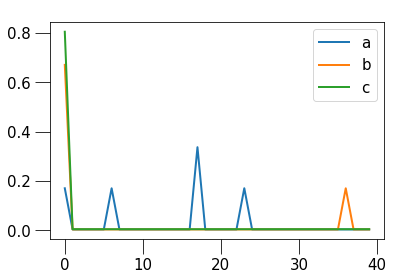

In [759]:
a = "/kernel: setting server address to **"
b = "xntpd[**]: kernel time sync enabled **"
c = "xntpd[**]: NTP Server Unreachable"

bow_a = bow_vecs[vecs_df["lt"]==a][0]
bow_b = bow_vecs[vecs_df["lt"]==b][0]
bow_c = bow_vecs[vecs_df["lt"]==c][0]

d1 = np.sqrt(sum([i**2 for i in bow_a - bow_b]))
d2 = np.sqrt(sum([i**2 for i in bow_a - bow_c]))
d3 = np.sqrt(sum([i**2 for i in bow_b - bow_c]))

v_a = np.array(vecs_df[vecs_df["lt"]==a]["v"].values[0])
v_b = np.array(vecs_df[vecs_df["lt"]==b]["v"].values[0])
v_c = np.array(vecs_df[vecs_df["lt"]==c]["v"].values[0])

d4 = np.sqrt(sum([i**2 for i in v_a - v_b]))
d5 = np.sqrt(sum([i**2 for i in v_a - v_c]))
d6 = np.sqrt(sum([i**2 for i in v_b - v_c]))

plt.figure()
plt.plot(v_a, label="a")
plt.plot(v_b, label="b")
plt.plot(v_c, label="c")
plt.legend()
plt.show()

In [760]:
print(d1, d2, d3)
print(d4, d5, d6)

3.1622776601683795 2.6457513110645907 2.6457513110645907
0.6666116563315506 0.7534431924172666 0.2133723912591459


**:rpd[**]: RPD_OSPF_NBRDOWN: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to KillNbr (event reason: interface went down) [ 0 21 23 24 25 26 27 28 20 29 31 32 33 34 35 36 37 30 38 19 17  1  2  3
  4  5  6  7  8  9 10 12 13 14 15 16 18 39 22 11]
rpd[**]: RPD_OSPF_NBRDOWN: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to KillNbr (event reason: interface went down) [ 0 21 23 24 25 26 27 28 20 29 31 32 33 34 35 36 37 30 38 19 17  1  2  3
  4  5  6  7  8  9 10 12 13 14 15 16 18 39 22 11]
**:rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to 2WayRcvd (event reason: neighbor detected this router) [ 0 21 23 24 25 26 27 28 20 29 31 32 33 34 35 36 37 30 38 19 17  1  2  3
  4  5  6  7  8  9 10 12 13 14 15 16 18 39 22 11]
rpd[**]: RPD_OSPF_NBRUP: OSPF neighbor ** (realm ** ** area **) state changed from ** to ** due to 2WayRcvd (event reason: neighbor detected this router) [ 0 21 23 24 25 26 27 28 20

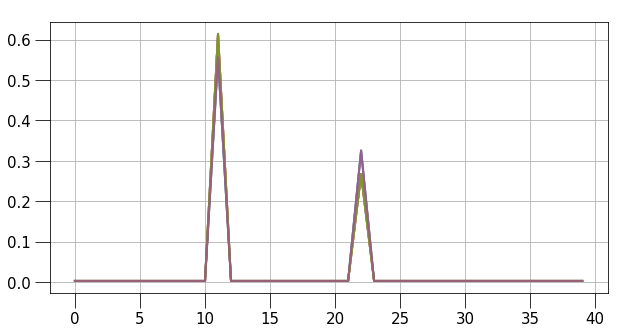

In [869]:
plt.figure(figsize=(10, 5))

for i  in vecs_df[vecs_df['gt']=="igp(ospf)"].iterrows():
    print(i[1]['lt'], np.argsort(i[1]['v']))
    
    plt.plot(i[1]['v'], alpha=0.5)
#     if "mgd" in i[1]['lt']:
#         plt.plot(i[1]['v'], color="red", alpha=0.5)
#     elif "file" in i[1]['lt']:
#     else:
#         plt.plot(i[1]['v'], color="blue", alpha=0.5)
        
# for i  in vecs_df[vecs_df['gt']=="system(cron)"].iterrows():
#     print(i[1]['lt'], np.argsort(i[1]['v']))
    
#     plt.plot(i[1]['v'], alpha=0.5)
#     if "mgd" in i[1]['lt']:
#     plt.plot(i[1]['v'], color="green", alpha=0.5)
#     elif "file" in i[1]['lt']:
#     else:
#         plt.plot(i[1]['v'], color="blue", alpha=0.5)
        
plt.grid()
plt.show()

In [811]:
vecs_df[vecs_df['gt']=="monitor(snmp)"]['lt'].values

array(['mib2d[**]: SNMP_TRAP_LINK_DOWN: ifIndex **, ifAdminStatus **(**), ifOperStatus **(**), ifName **',
       'mib2d[**]: SNMP_TRAP_LINK_UP: ifIndex **, ifAdminStatus **(**), ifOperStatus **(**), ifName **',
       'rpd[**]: EVENT <SNMP Index> ** index ** <Up Broadcast Multicast> address #** **',
       '**: rpd[**]: EVENT <SNMP Index> ** index ** <Up Broadcast PointToPoint Multicast>',
       'snmpd[**]: SNMPD_TRAP_QUEUED: Adding trap to ** to ** queue, ** traps in queue',
       'snmpd[**]: SNMPD_TRAP_QUEUE_DRAINED: trap_dq_send_traps: traps queued to ** sent successfully',
       'BULKGET: Master socket closed', 'bulkget_stop_pfeman_transaction',
       'BULKGET disconnected: BULKGET socket closed abruptly',
       'BULKGET: re-connecting to serverRouter',
       'Bulkget manager reconnection succeeded after ** tries',
       'BULKGET master RE reconnection made',
       'bulkget_start_pfeman_transaction',
       'mib2d[**]: MIB2D_RTSLIB_READ_FAILURE: check_rtsock_rc: failed in 

In [920]:
sum(vecs_df["gt"]=="system(cron)")

8

In [900]:
cosine_similarity(z)[:56, 56:]

array([[0.46374565, 0.462127  , 0.36787686, 0.36811575, 0.36804926,
        0.36781508, 0.3681073 , 0.3681044 , 0.36794192, 0.462765  ,
        0.46307647, 0.36793366, 0.36788687, 0.46282506, 0.46242827],
       [0.4719674 , 0.47031772, 0.37426406, 0.37450752, 0.37443975,
        0.37420112, 0.37449893, 0.37449598, 0.3743304 , 0.47096744,
        0.4712849 , 0.37432194, 0.37427413, 0.47102886, 0.4706247 ],
       [0.4928476 , 0.49111465, 0.39023563, 0.39049125, 0.3904201 ,
        0.39016953, 0.39048225, 0.39047915, 0.39030528, 0.49179763,
        0.4921311 , 0.39029643, 0.39024618, 0.49186197, 0.4914372 ],
       [0.5037635 , 0.50198555, 0.39847463, 0.3987369 , 0.3986639 ,
        0.39840683, 0.39872766, 0.39872447, 0.3985461 , 0.502686  ,
        0.5030283 , 0.39853698, 0.39848557, 0.50275177, 0.5023161 ],
       [0.23323411, 0.23244219, 0.18627992, 0.18639702, 0.18636443,
        0.18624967, 0.18639287, 0.18639147, 0.18631183, 0.2327541 ,
        0.23290671, 0.18630777, 0.1862848 , 

In [925]:
vecs_df[vecs_df["gt"]=="mgmt(command)"]["lt"]

158    mgd[**]: UI_JUNOSCRIPT_CMD: User '(unauthentic...
159    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
160    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
161    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
162    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
163    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
164    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
165    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
166    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
167    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
168    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
169    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
170    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
171    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
172    mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used JUN...
173    ** mgd[**]: UI_JUNOSCRIPT_CMD: User '(unauthen...
174    ** mgd[**]: UI_JUNOSCRIPT_CMD: User '**' used ...
175    file[**]: UI_JUNOSCRIPT_

In [926]:
vecs_df[vecs_df["gt"]=="system(cron)"]["lt"]

0           /usr/sbin/cron[**]: (root) CMD (newsyslog)
1          /usr/sbin/cron[**]: (**) CMD (adjkerntz -a)
2    /usr/sbin/cron[**]: (**) CMD (/usr/sbin/check-...
3          ** /usr/sbin/cron[**]: (**) CMD (newsyslog)
4       ** /usr/sbin/cron[**]: (**) CMD (adjkerntz -a)
5    ** /usr/sbin/cron[**]: (**) CMD (/usr/sbin/che...
6    /usr/sbin/cron[**]: (root) CMD ( /usr/libexec/...
7    /usr/sbin/cron[**]: (*system*) RELOAD (/etc/cr...
Name: lt, dtype: object

In [940]:
z.shape

(71, 40)

In [969]:
vecs_df[vecs_df["gt"]=="igp(ospf)"].shape

(15, 5)

In [961]:
z[:15].shape

(15, 40)

In [963]:
np.sum(z[:15], axis=0).shape

(40,)

In [973]:
a = np.array(list(vecs_df[vecs_df["gt"]=="igp(ospf)"]["v"].values))
b = np.array(list(vecs_df[vecs_df["gt"]=="egp(bgp)"]["v"].values))

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(np.sum( a  , axis=0)/15, color="red", alpha=1.)
plt.plot(np.sum( b , axis=0)/56, color="blue", alpha=0.5)
plt.grid()
plt.show()

/kernel: MTU for ** reduced to **


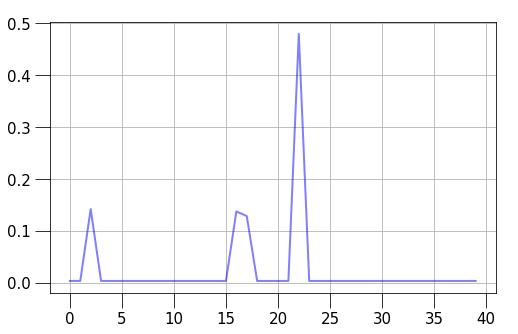

rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast> address #** **


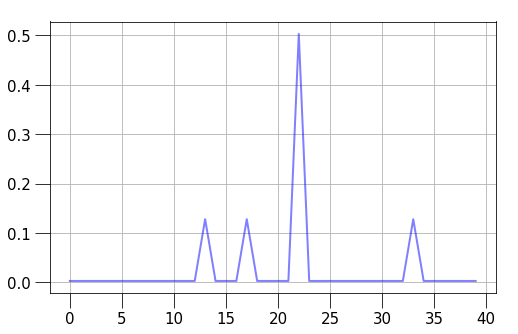

rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Multicast> address #** **


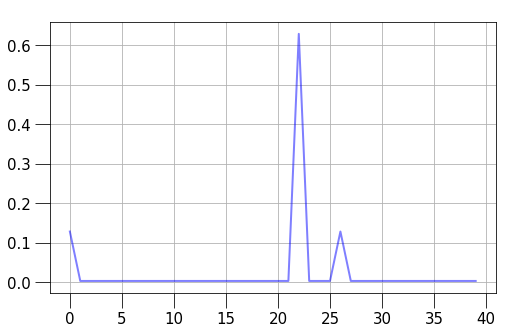

**: rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast>


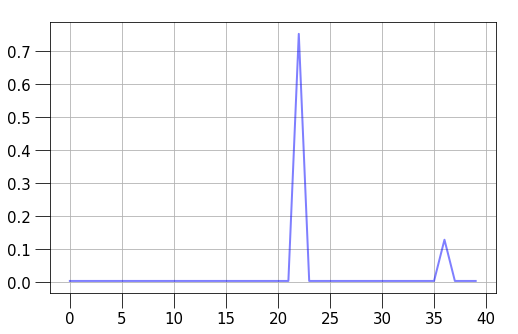

**: rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast> address #** **


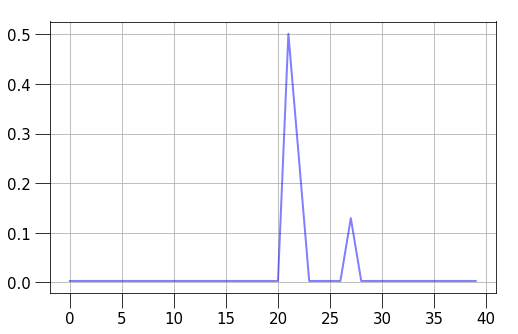

mcsn[**]: EVENT <MTU> index ** <Broadcast Multicast>


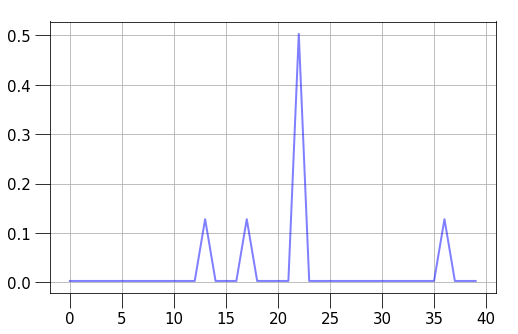

**: rpd[**]: EVENT <MTU> index ** <Broadcast Multicast>


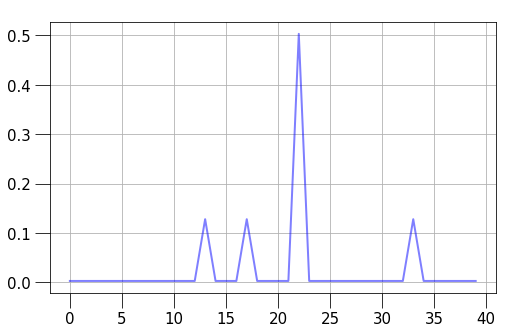

mcsn[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **


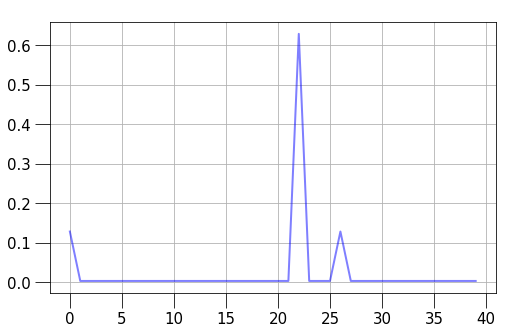

**: rpd[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **


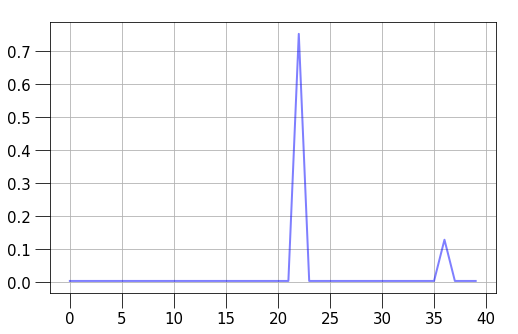

rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast> address #** **


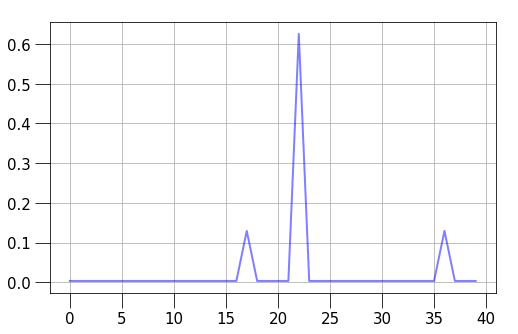

rpd[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **


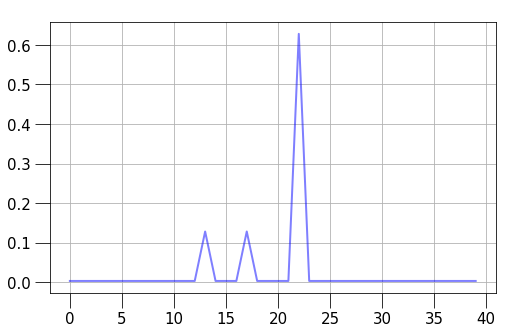

**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast>


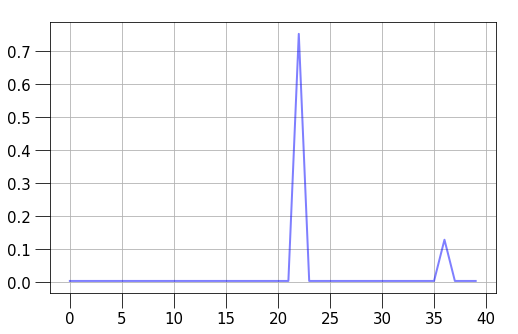

mcsn[**]: EVENT <MTU> index ** <Up Broadcast Multicast>


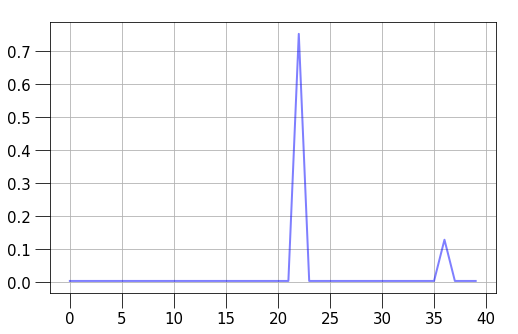

**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **


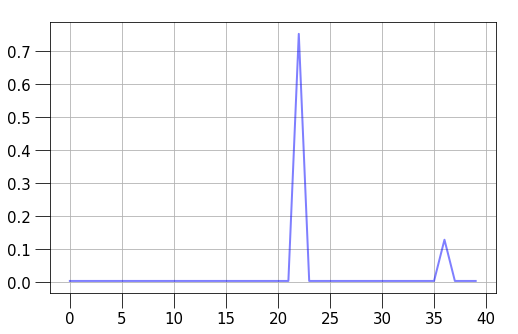

mcsn[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **


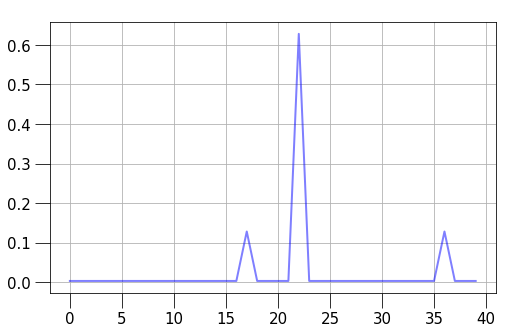

rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast>


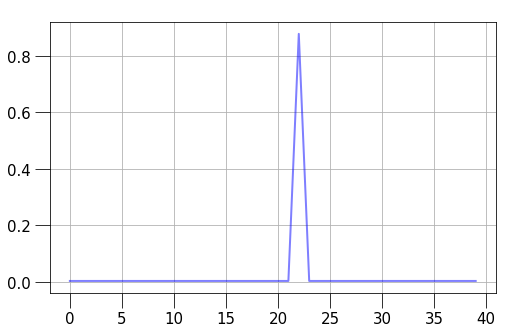

rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **


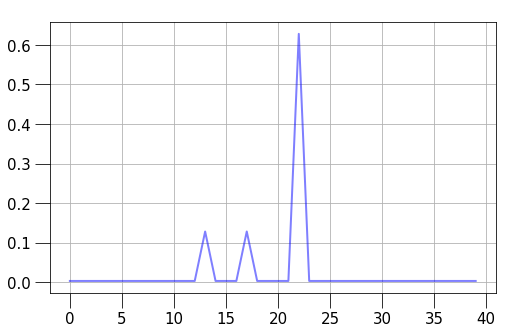

**: rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Multicast> address #** **


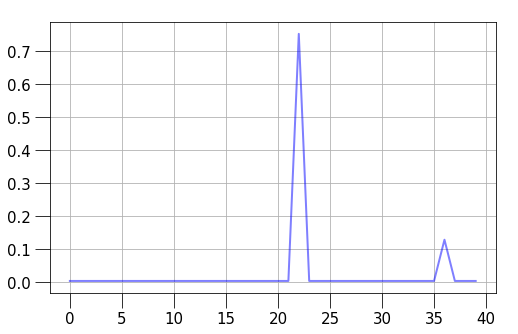

rpd[**]: EVENT <MTU> index ** <Broadcast Multicast>


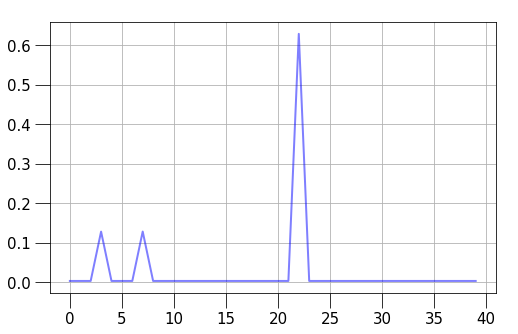

rpd[**]: EVENT <MTU> ** index ** <Broadcast PointToPoint Multicast>


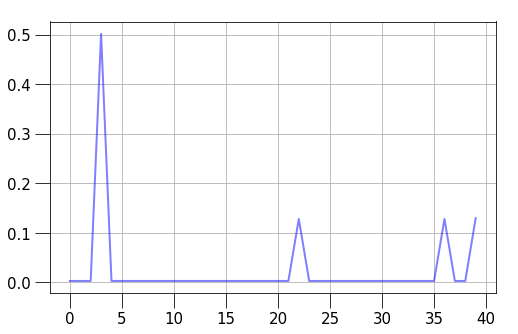

**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>


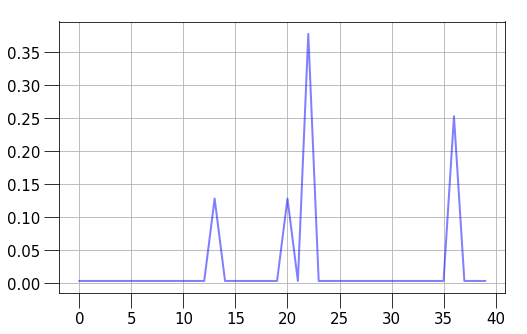

mcsn[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>


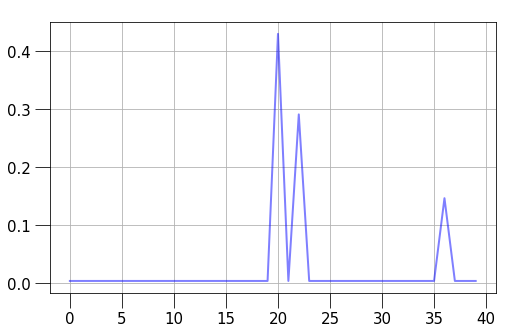

rpd[**]: EVENT <MTU> index ** <Up Broadcast Loopback Multicast>


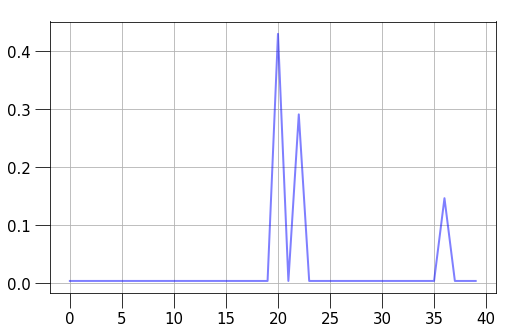

rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast>


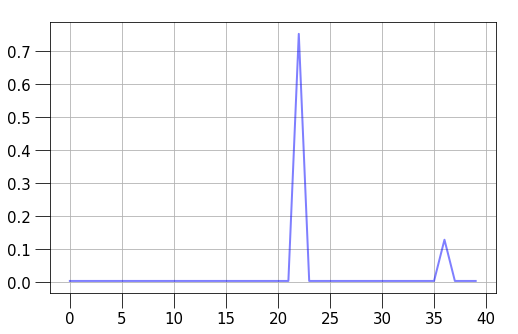

** /kernel: MTU for ** reduced to **


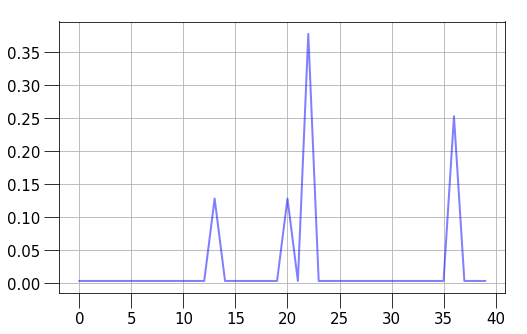

rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Loopback Multicast>


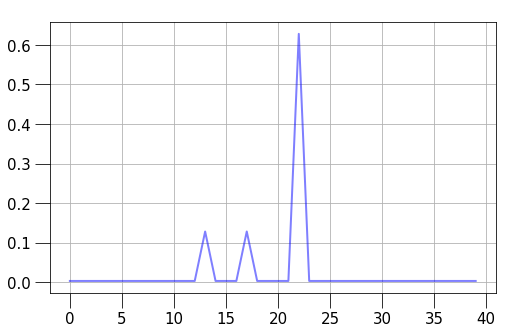

In [979]:
b_name = np.array(list(vecs_df[vecs_df["gt"]=="network(mtu)"]["lt"].values))

for bb, n in zip(b, b_name):
    print(n)
    plt.figure(figsize=(8, 5))
    plt.plot(bb, color="blue", alpha=0.5)
    plt.grid()
    plt.show()

In [932]:
cosine_similarity(z)[:8, 8:]

array([[0.4438215 , 0.45272967, 0.45345154, 0.45134187, 0.45083824,
        0.45228288, 0.45120168, 0.45184493, 0.45386657, 0.45209754,
        0.4515594 , 0.45353273, 0.45242196, 0.45170474, 0.45149866,
        0.4433509 , 0.45197618, 0.8398809 , 0.83968186, 0.8395219 ,
        0.83950144, 0.45103288, 0.45188054, 0.45297718],
       [0.4438215 , 0.45272967, 0.45345154, 0.45134187, 0.45083824,
        0.45228288, 0.45120168, 0.45184493, 0.45386657, 0.45209754,
        0.4515594 , 0.45353273, 0.45242196, 0.45170474, 0.45149866,
        0.4433509 , 0.45197618, 0.8398809 , 0.83968186, 0.8395219 ,
        0.83950144, 0.45103288, 0.45188054, 0.45297718],
       [0.4438215 , 0.45272967, 0.45345154, 0.45134187, 0.45083824,
        0.45228288, 0.45120168, 0.45184493, 0.45386657, 0.45209754,
        0.4515594 , 0.45353273, 0.45242196, 0.45170474, 0.45149866,
        0.4433509 , 0.45197618, 0.8398809 , 0.83968186, 0.8395219 ,
        0.83950144, 0.45103288, 0.45188054, 0.45297718],
       [0.446

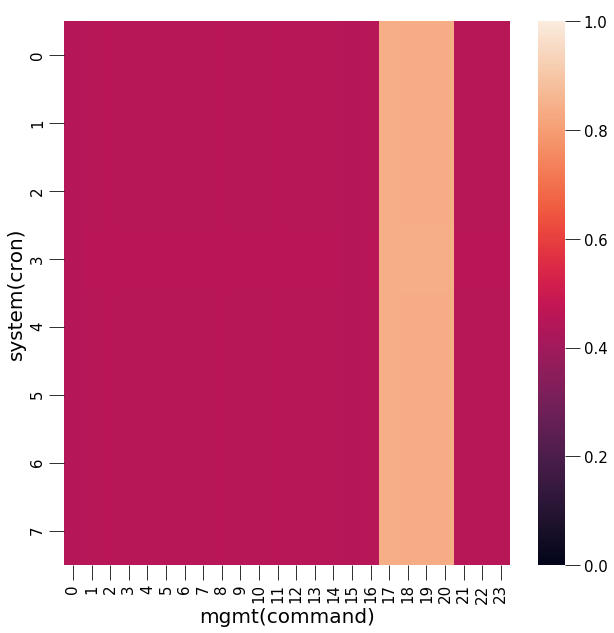

In [934]:
import seaborn as sns
tmp_df = pd.DataFrame(cosine_similarity(z)[:8, 8:])#, columns=cat_names, index=cat_names)

plt.figure(figsize=(10, 10))
sns.heatmap(tmp_df,vmin=0, vmax=1.0)
plt.ylabel("system(cron)")
plt.xlabel("mgmt(command)")
plt.show()

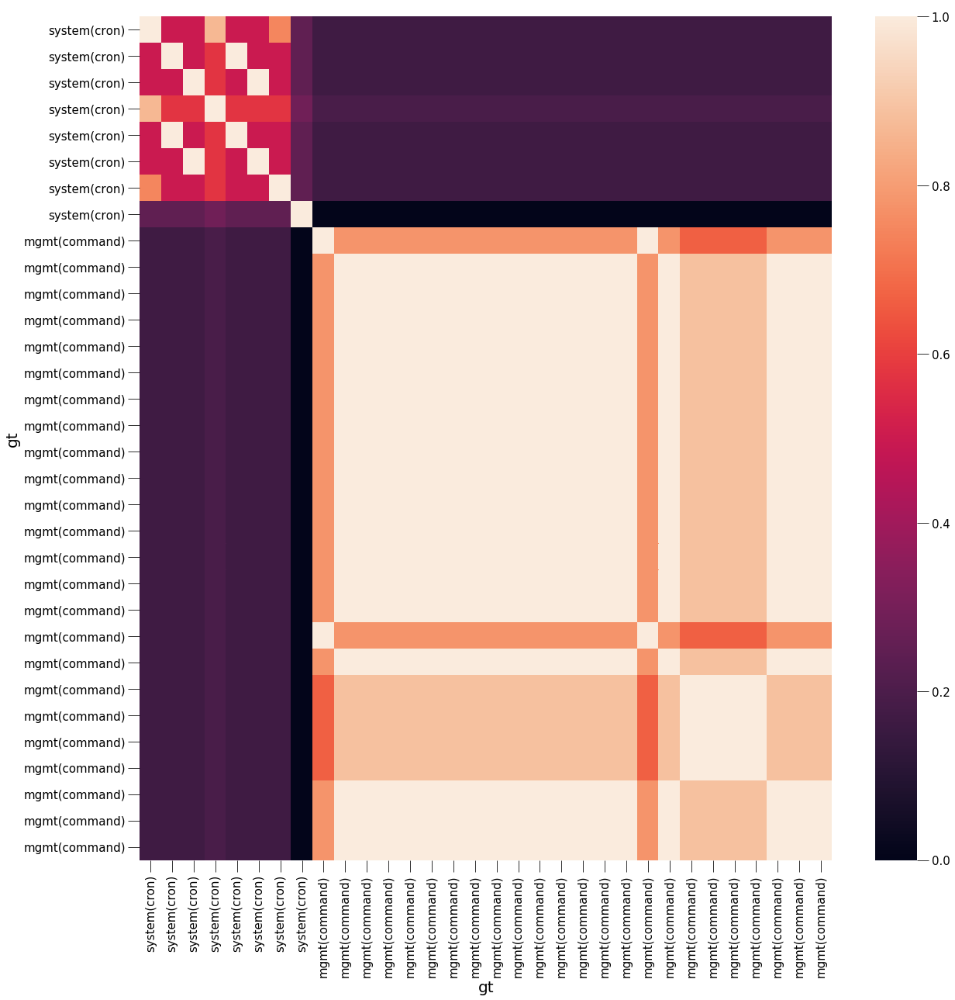

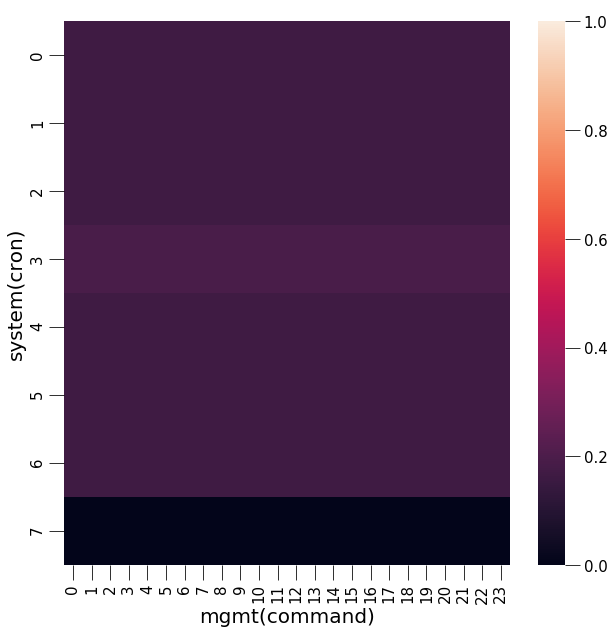

In [936]:
tmp_df = pd.DataFrame(cosine_similarity(bow_vecs[bool_idx]), columns=cat_names, index=cat_names)

plt.figure(figsize=(20, 20))
sns.heatmap(tmp_df)
plt.show()

tmp_df = pd.DataFrame(cosine_similarity(bow_vecs[bool_idx])[:8, 8:])#, columns=cat_names, index=cat_names)

plt.figure(figsize=(10, 10))
sns.heatmap(tmp_df, vmin=0, vmax=1.0)
plt.ylabel("system(cron)")
plt.xlabel("mgmt(command)")
plt.show()

In [603]:
tsne2d = TSNE(
    n_components=2, #ここが削減後の次元数です．
    init='random',
    random_state=101,
    method='barnes_hut',
    n_iter=500,
    verbose=2
).fit_transform(z)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 913 samples in 0.001s...
[t-SNE] Computed neighbors for 913 samples in 0.108s...
[t-SNE] Computed conditional probabilities for sample 913 / 913
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.134s
[t-SNE] Iteration 50: error = 60.0765915, gradient norm = 0.2708662 (50 iterations in 0.814s)
[t-SNE] Iteration 100: error = 56.3270836, gradient norm = 0.2236489 (50 iterations in 0.676s)
[t-SNE] Iteration 150: error = 55.5085449, gradient norm = 0.2010257 (50 iterations in 0.660s)
[t-SNE] Iteration 200: error = 55.3123703, gradient norm = 0.2162853 (50 iterations in 0.657s)
[t-SNE] Iteration 250: error = 55.1720276, gradient norm = 0.2265889 (50 iterations in 0.658s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.172028
[t-SNE] Iteration 300: error = 0.3706913, gradient norm = 0.0006216 (50 iterations in 0.627s)
[t-SNE] Iteration 350: error = 0.3180157, gradient norm = 0.0002801 (

In [608]:
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()

le = preprocessing.LabelEncoder()
colors = le.fit_transform(cat_names)

trace2 = go.Scatter(
    x=tsne2d[:,0],
    y=tsne2d[:,1],
    mode='markers',
    text=[i[:50] for i in z_keys],
    marker=dict(
        sizemode='diameter',
        color = colors,
        colorscale = 'Portland',
        colorbar=dict(
            title='Colorbar',
            tickvals = np.arange(len(le.classes_)),
            ticktext = le.classes_
        ),
        line=dict(color='rgb(255, 255, 255)'),
        opacity=0.9,
        size=5
    )
)

data=[trace2]
layout=dict(height=800, width=800, title='Log Template Vectors')
fig=dict(data=data, layout=layout)
offline.iplot(fig, filename='tsne_example')

In [581]:
z = np.array([np.array(i) for i in vecs_df[bool_idx]["v"].values])
z_keys = vecs_df[bool_idx]["lt"].values

In [582]:
tsne2d = TSNE(
    n_components=2, #ここが削減後の次元数です．
    init='random',
    random_state=101,
    method='barnes_hut',
    n_iter=500,
    verbose=2
).fit_transform(z)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 572 samples in 0.002s...
[t-SNE] Computed neighbors for 572 samples in 0.062s...
[t-SNE] Computed conditional probabilities for sample 572 / 572
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.100s
[t-SNE] Iteration 50: error = 56.5946884, gradient norm = 0.4845808 (50 iterations in 0.472s)
[t-SNE] Iteration 100: error = 54.3942261, gradient norm = 0.4679197 (50 iterations in 0.455s)
[t-SNE] Iteration 150: error = 54.4054794, gradient norm = 0.4483896 (50 iterations in 0.454s)
[t-SNE] Iteration 200: error = 53.5180359, gradient norm = 0.4539770 (50 iterations in 0.454s)
[t-SNE] Iteration 250: error = 53.9110298, gradient norm = 0.4644148 (50 iterations in 0.446s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.911030
[t-SNE] Iteration 300: error = 0.2686163, gradient norm = 0.0011224 (50 iterations in 0.396s)
[t-SNE] Iteration 350: error = 0.2333063, gradient norm = 0.0003763 (

In [590]:
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()

le = preprocessing.LabelEncoder()
colors = le.fit_transform(cat_name)

trace2 = go.Scatter(
    x=tsne2d[:,0],
    y=tsne2d[:,1],
    mode='markers',
    text=[i[:50] for i in z_keys],
    marker=dict(
        sizemode='diameter',
        color = colors,
        colorscale = 'Portland',
        colorbar=dict(
            title='Colorbar',
            tickvals = np.arange(len(le.classes_)),
            ticktext = le.classes_
        ),
        line=dict(color='rgb(255, 255, 255)'),
        opacity=0.9,
        size=5
    )
)

data=[trace2]
layout=dict(height=800, width=800, title='Log Template Vectors')
fig=dict(data=data, layout=layout)
offline.iplot(fig, filename='tsne_example')

In [479]:
vecs_df[vecs_df["gt"]=="vpn(mpls)"]

,lt,v,gt,tm,km
1248,**:rpd[**]: RPD_MPLS_PATH_DOWN: MPLS path ** d...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1249,**:rpd[**]: RPD_MPLS_LSP_DOWN: MPLS LSP ** dow...,"[0.0031250003, 0.0031250003, 0.0031250003, 0.0...",vpn(mpls),22.0,8
1250,**:rpd[**]: RPD_MPLS_PATH_UP: MPLS path ** up ...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1251,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1252,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1253,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1254,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1255,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.003125, 0.003125, 0.003125, 0.003125, 0.003...",vpn(mpls),22.0,8
1256,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.0031249996, 0.0031249996, 0.0031249996, 0.0...",vpn(mpls),22.0,8
1257,**:rpd[**]: RPD_MPLS_LSP_UP: MPLS LSP ** up on...,"[0.0031250003, 0.0031250003, 0.0031250003, 0.0...",vpn(mpls),22.0,8


### 単純な手法と比較して見る-2
- 編集距離

In [477]:
inf_topic_words[23]

['index',
 'event',
 'broadcast',
 'rpd',
 'multicast',
 'up',
 'mcsn',
 'address',
 'updown',
 'mtu']

In [658]:
import Levenshtein

string1 = "井上泰治"
string2 = "井上泰次"

print(Levenshtein.distance(string1, string2))

1


In [ ]:
KMeans()

In [659]:
for i in vecs_df["lt"].values:
    print(i)
    print(string_to_corpus(i))
    
    
    break

/usr/sbin/cron[**]: (root) CMD (newsyslog)
['/usr/sbin/cron', 'root', 'cmd', 'newsyslog']


mcsn[**]: EVENT <UpDown> index ** <Up Broadcast Multicast>
(array([23]),)


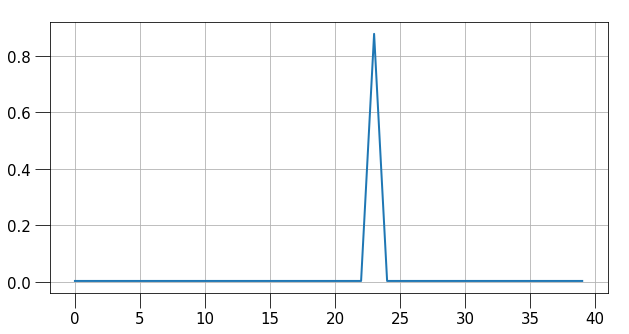

**: rpd[**]: EVENT <UpDown> index ** <Up Broadcast Multicast>
(array([23]),)


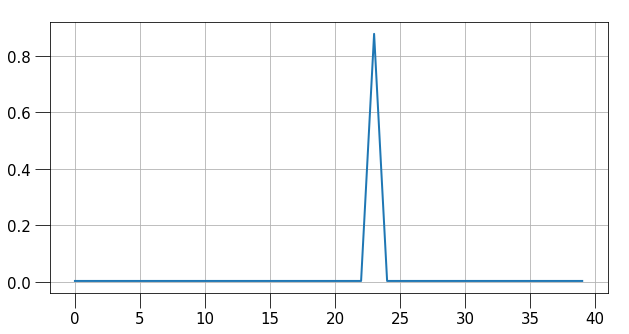

**: rpd[**]: EVENT <Instance> ** index ** <Up Broadcast Multicast> address #** **
(array([23]),)


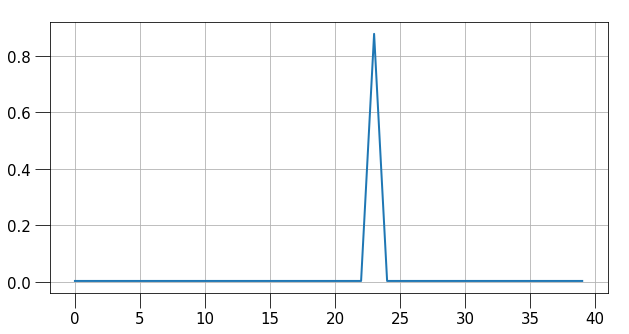

**: rpd[**]: EVENT <Delete UpDown> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


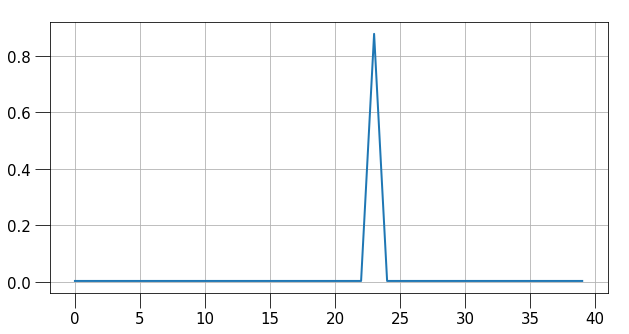

rpd[**]: EVENT <Delete UpDown> ** index ** <Broadcast PointToPoint Multicast> address #** **
(array([23]),)


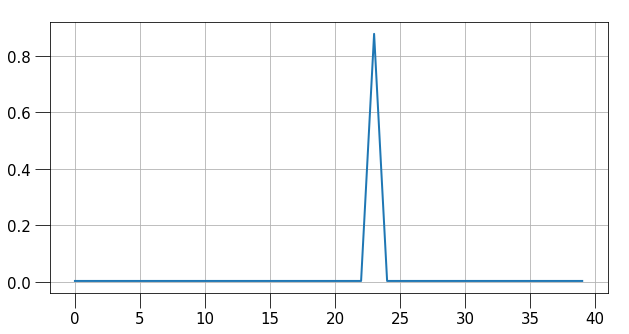

rpd[1896]: EVENT Delete UpDown ** index ** <Broadcast PointToPoint Multicast Localup>
(array([23]),)


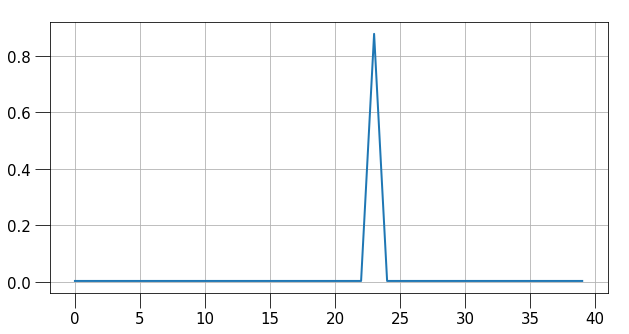

rpd[**]: EVENT <Instance> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


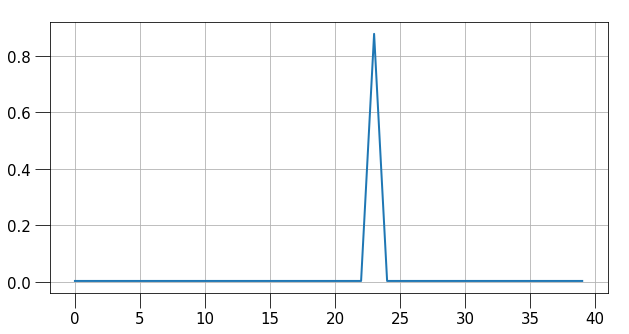

rpd[**]: EVENT <Add> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


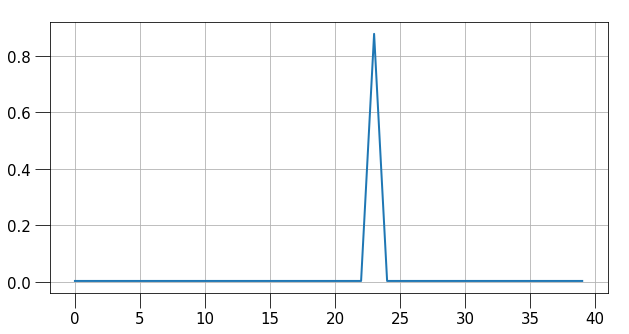

rpd[**]: EVENT Delete ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


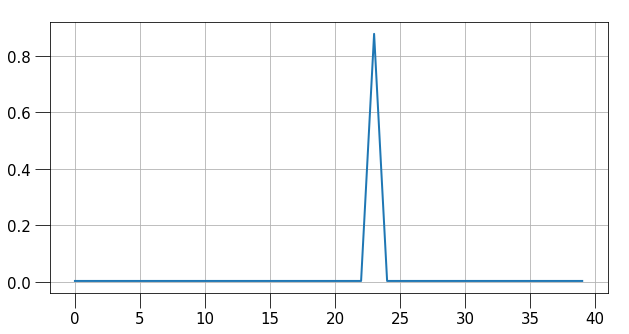

rpd[**]: EVENT <Flags> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


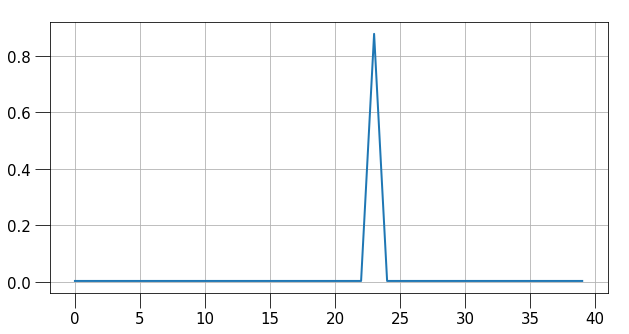

rpd[**]: EVENT <UpDown> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


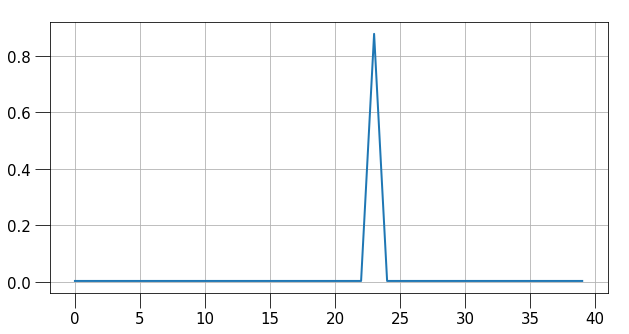

rpd[**]: EVENT <UpDown MTU> index ** <Broadcast Multicast>
(array([23]),)


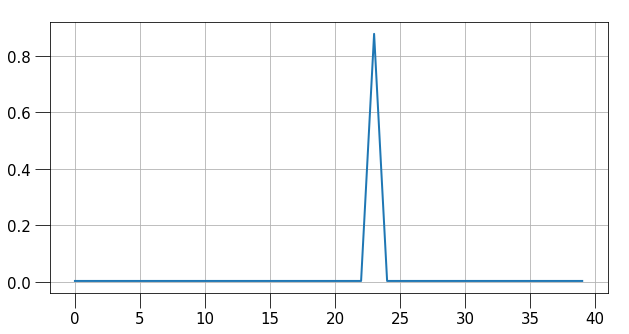

mcsn[**]: EVENT <UpDown MTU> index ** <Broadcast Multicast>
(array([23]),)


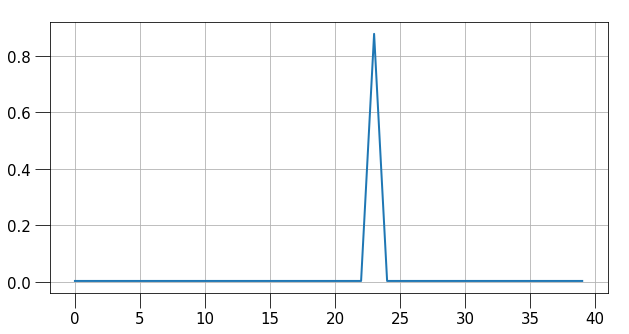

**: rpd[**]: EVENT <UpDown MTU> index ** <Broadcast Multicast>
(array([23]),)


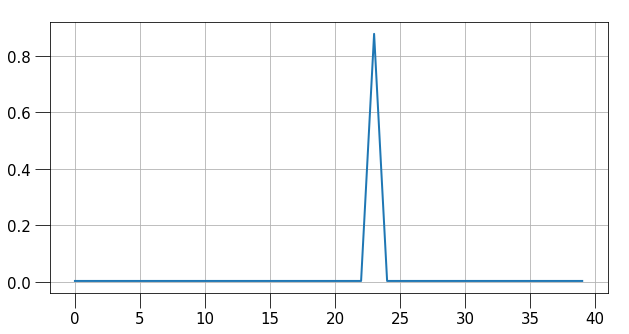

rpd[**]: EVENT <UpDown> index ** <Up Broadcast Multicast>
(array([23]),)


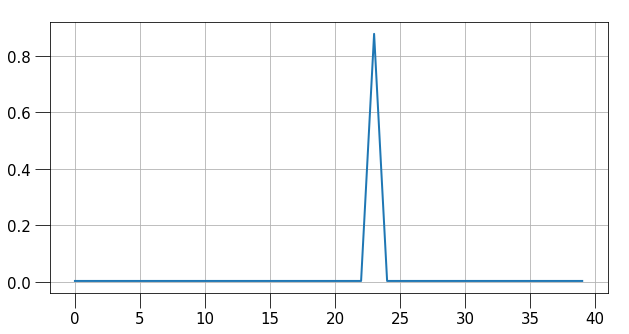

**: rpd[**]: EVENT Delete UpDown ** index ** <Broadcast Multicast Localup>
(array([23]),)


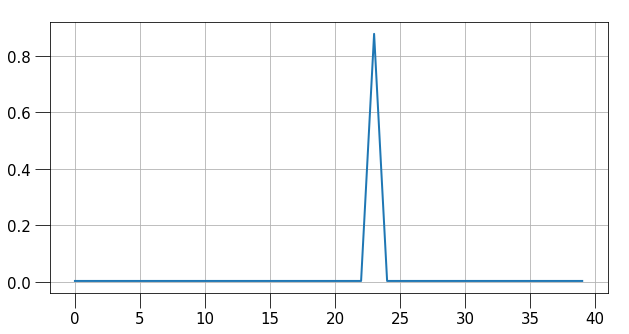

rpd[**]: EVENT <Add Bandwidth MTU> index ** <Broadcast Multicast>
(array([23]),)


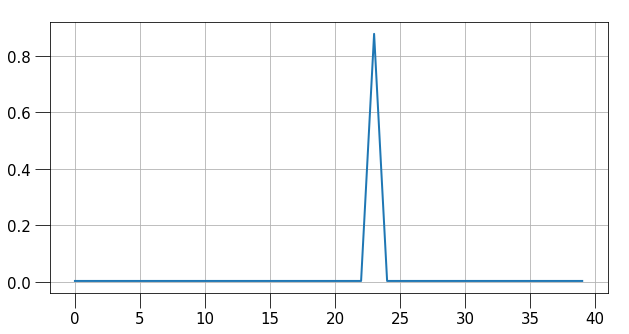

rpd[**]: EVENT <Delete> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


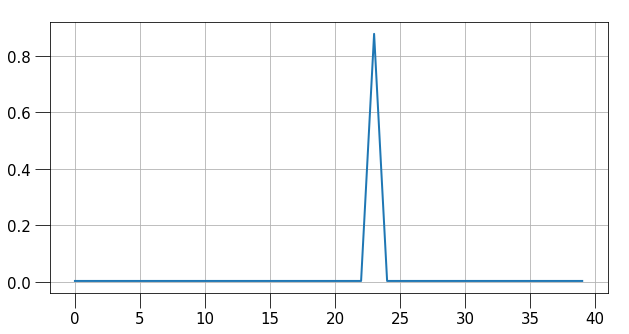

**: rpd[**]: EVENT Add ** index ** <Up Broadcast Multicast Localup>
(array([23]),)


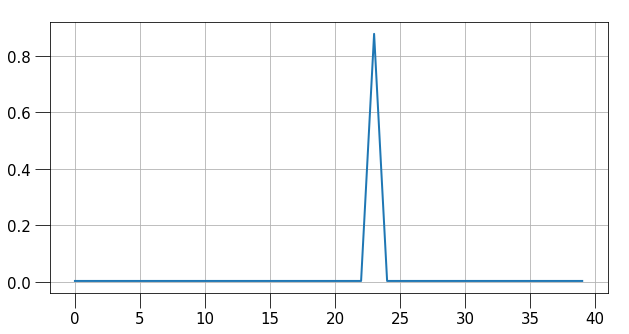

**: rpd[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **
(array([23]),)


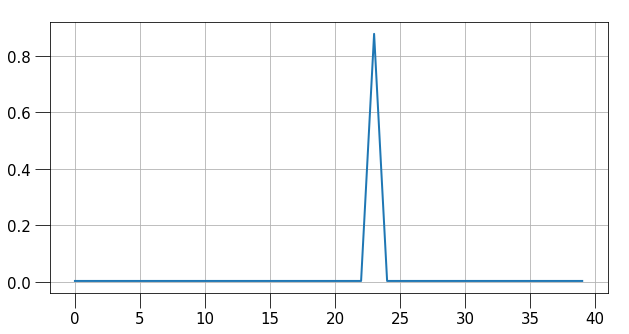

**: rpd[**]: EVENT <Add> ** index ** <Up Broadcast Multicast> address #** **
(array([23]),)


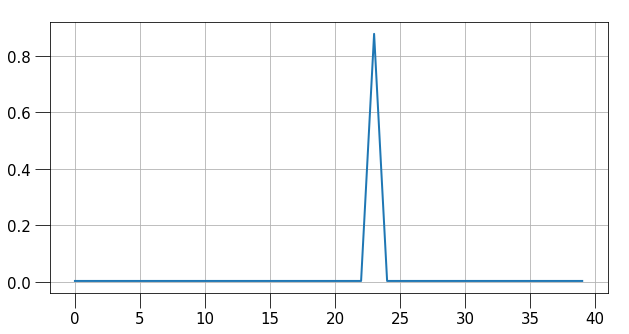

rpd[**]: EVENT <Address> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


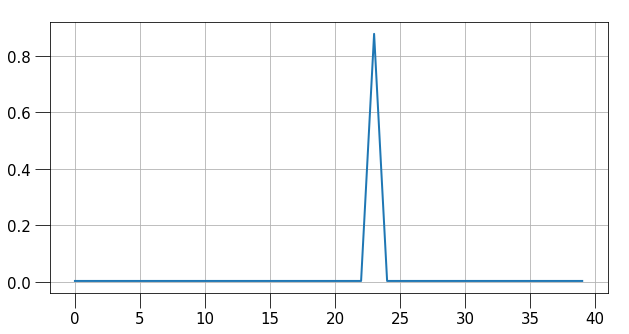

rpd[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **
(array([23]),)


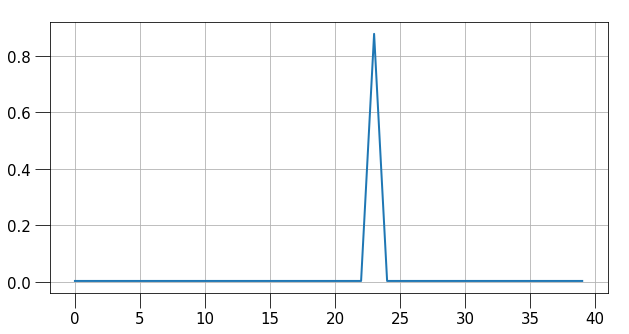

mcsn[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **
(array([23]),)


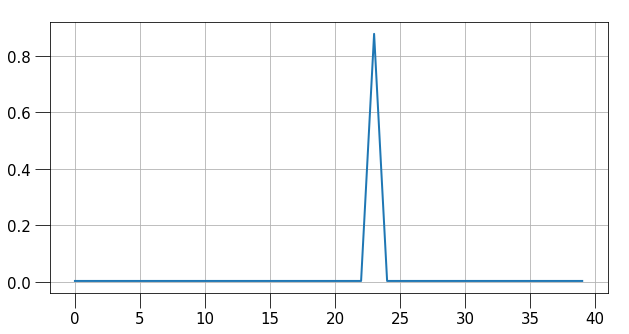

**: rpd[**]: EVENT <Add MTU Encapsulation> index ** <Broadcast Multicast> address #** **
(array([23]),)


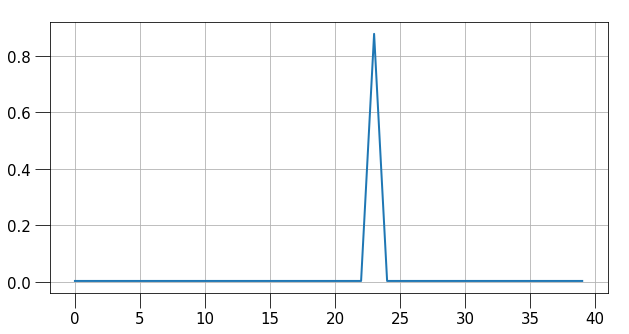

rpd[**]: EVENT <Flags> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


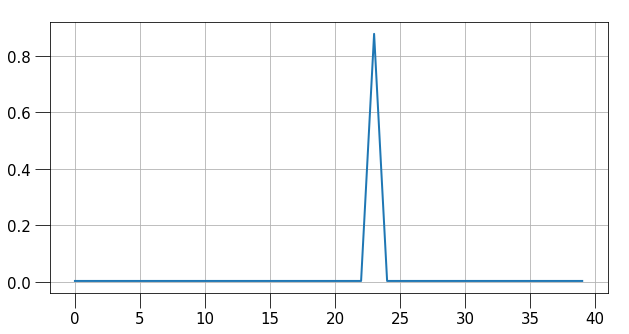

rpd[**]: EVENT <Add> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


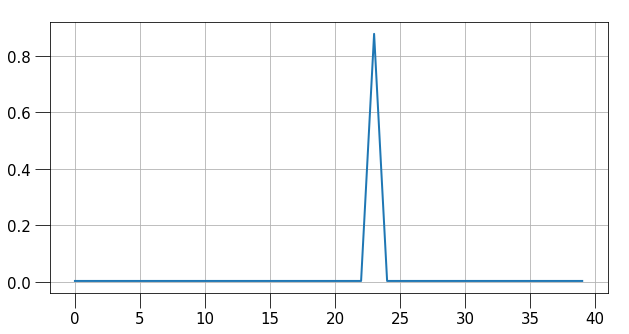

rpd[**]: EVENT <UpDown MTU> index ** <Up Broadcast Multicast>
(array([23]),)


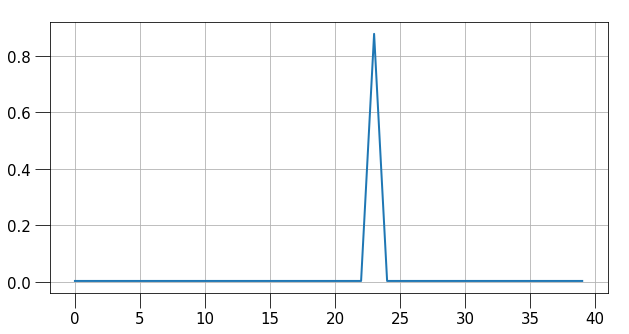

mcsn[**]: EVENT <UpDown MTU> index ** <Up Broadcast Multicast> address #** **
(array([23]),)


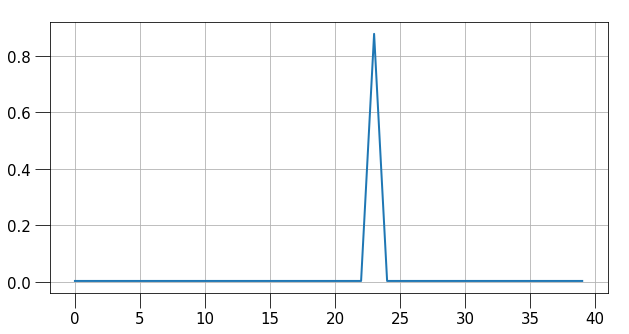

mcsn[**]: EVENT <UpDown MTU> index ** <Up Broadcast Multicast>
(array([23]),)


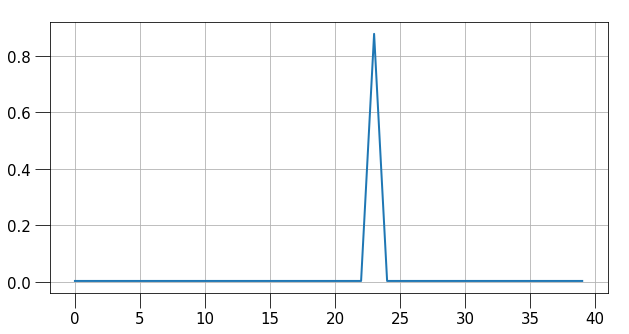

rpd[**]: EVENT <Add> ** index ** <Up Broadcast PointToPoint Multicast> address #** **
(array([23]),)


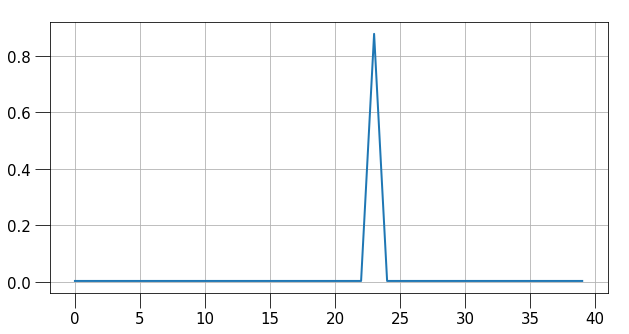

rpd[**]: EVENT <Flags> ** index ** <Up Broadcast PointToPoint Multicast> address #** **
(array([23]),)


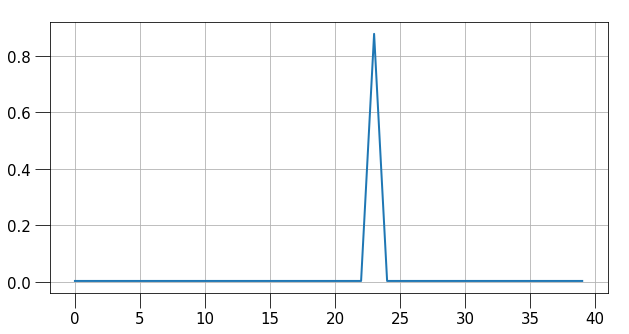

rpd[**]: EVENT Add ** index ** <Up Broadcast PointToPoint Multicast Localup>
(array([23]),)


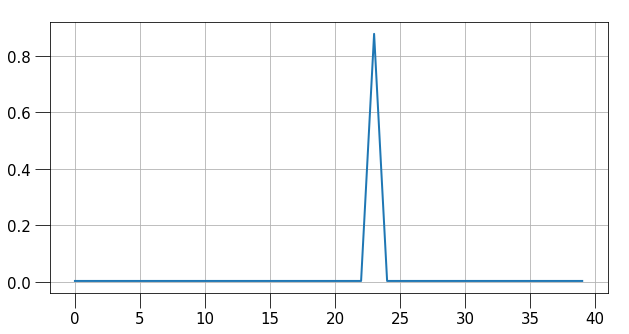

**: rpd[**]: EVENT <Bandwidth> index ** <Broadcast Multicast> address #** **
(array([23]),)


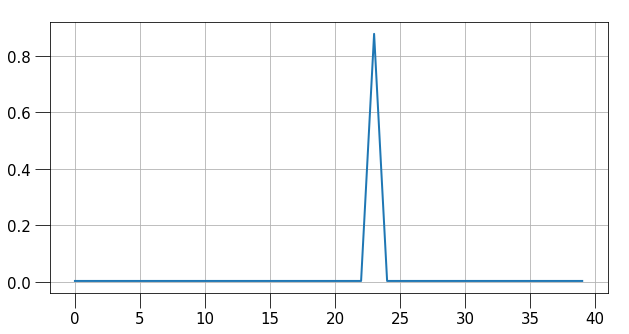

mcsn[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **
(array([23]),)


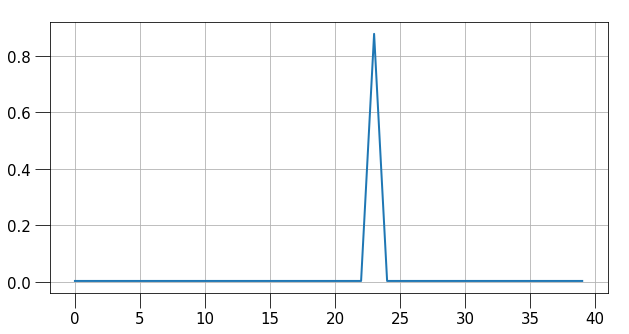

rpd[**]: EVENT <MTU> index ** <Broadcast Multicast> address #** **
(array([23]),)


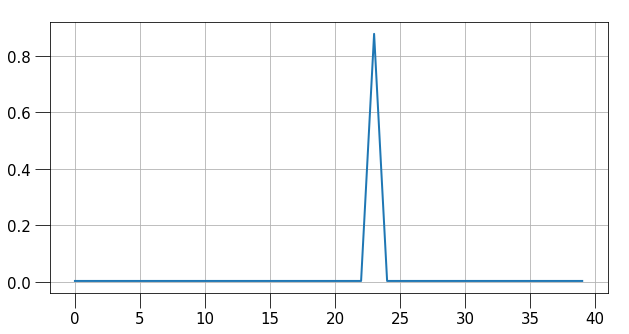

**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast>
(array([23]),)


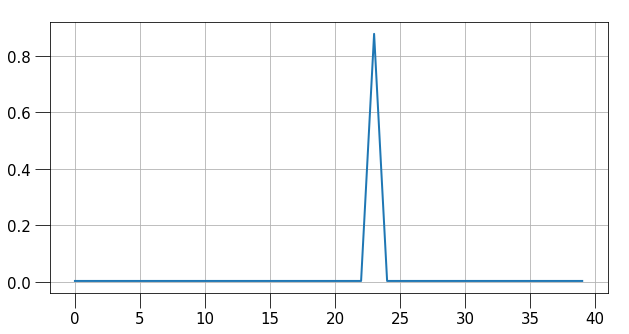

mcsn[**]: EVENT <MTU> index ** <Up Broadcast Multicast>
(array([23]),)


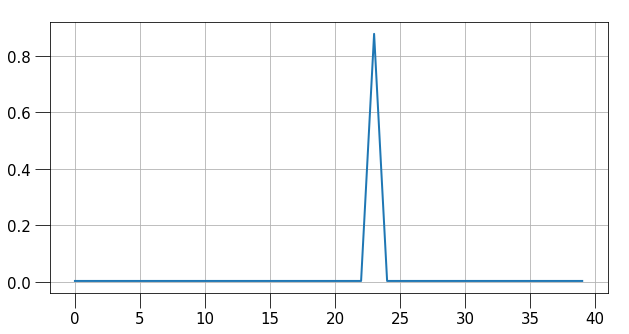

**: rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **
(array([23]),)


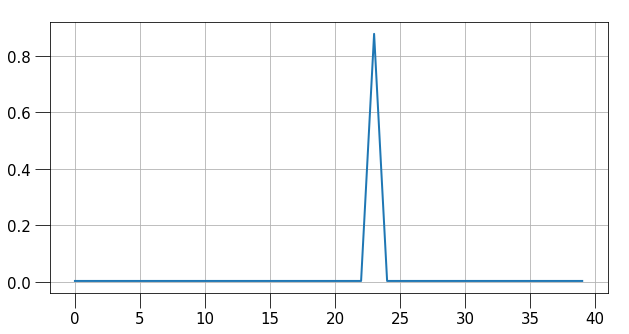

mcsn[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **
(array([23]),)


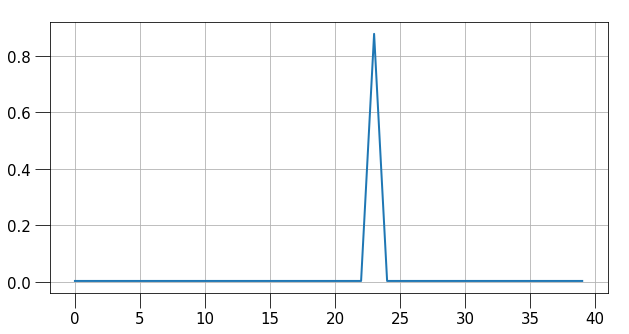

rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast>
(array([23]),)


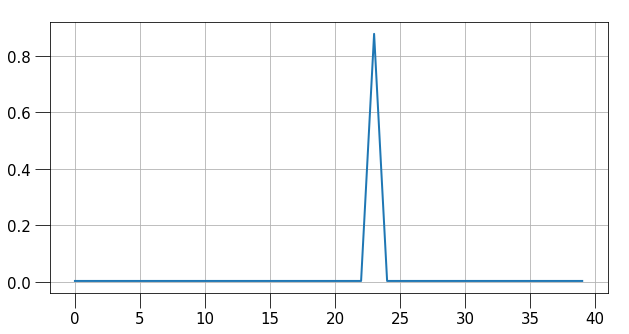

rpd[**]: EVENT <MTU> index ** <Up Broadcast Multicast> address #** **
(array([23]),)


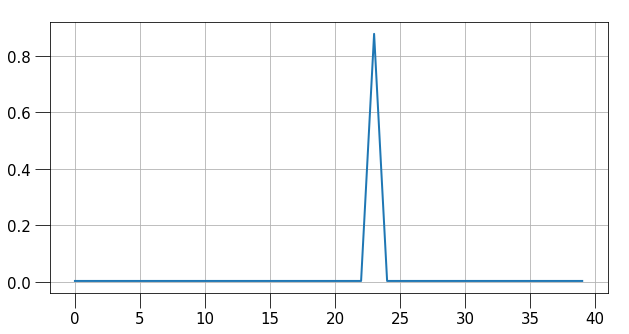

**: rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Multicast> address #** **
(array([23]),)


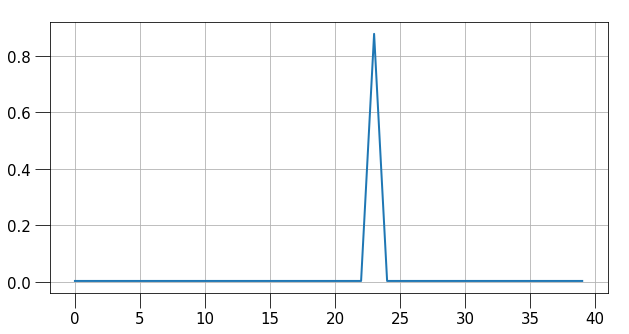

**: rpd[**]: EVENT <MTU> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


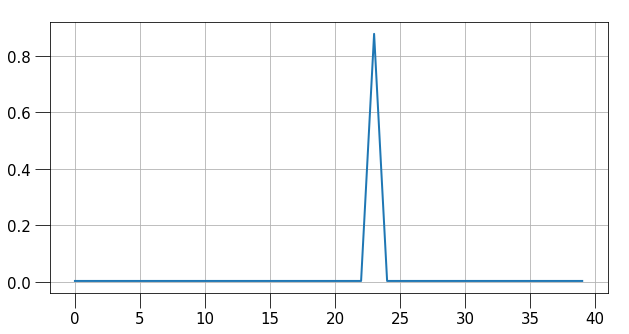

**: rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast>
(array([23]),)


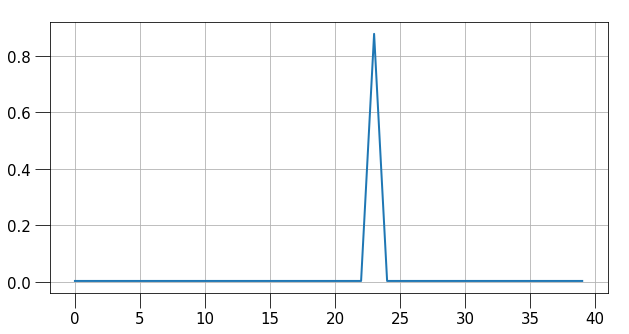

rpd[**]: EVENT <MTU> ** index ** <Up Broadcast Multicast> address #** **
(array([23]),)


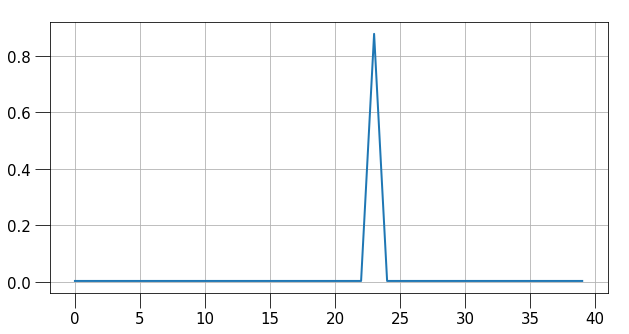

rpd[**]: EVENT <MTU> ** index ** <Up Broadcast PointToPoint Multicast> address #** **
(array([23]),)


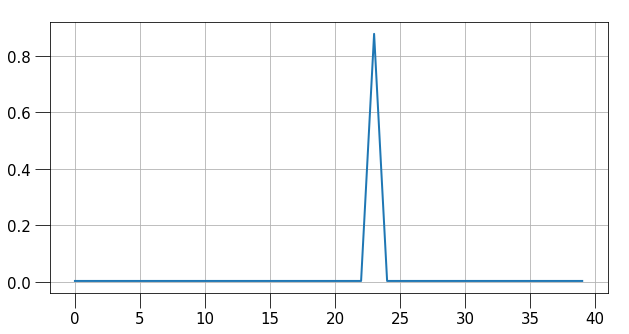

rpd[**]: EVENT <MTU> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


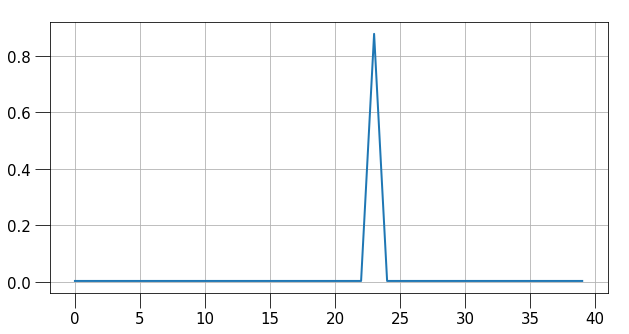

rpd[**]: EVENT <Instance> ** index ** <Up Broadcast Multicast> address #** **
(array([23]),)


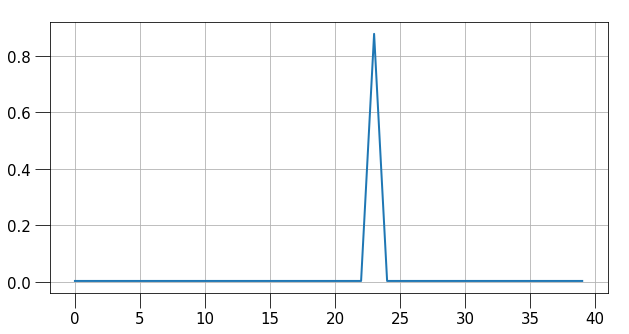

**: rpd[**]: EVENT Delete ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


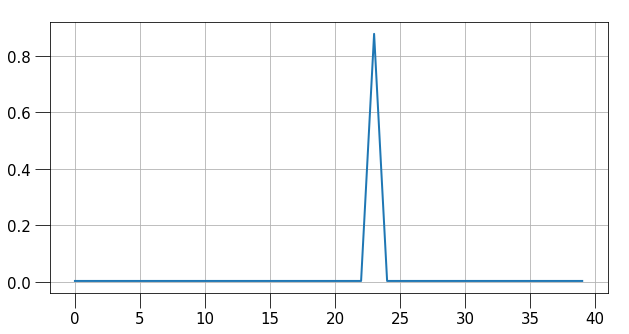

**: rpd[**]: EVENT <Flags> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


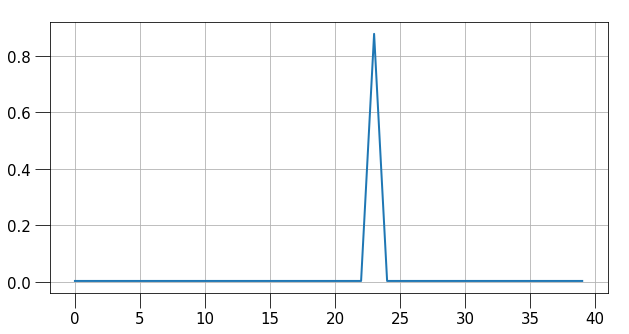

mcsn[**]: EVENT <UpDown MTU> index ** <Broadcast Multicast> address #** **
(array([23]),)


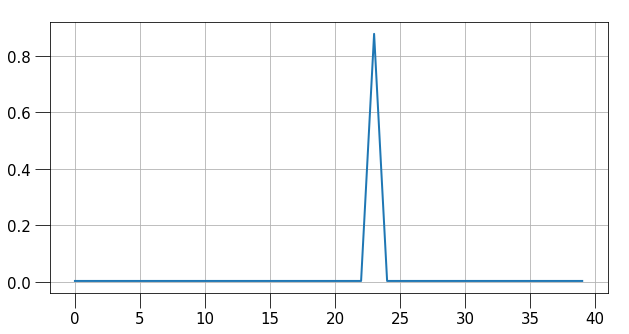

**: rpd[**]: EVENT UpDown ** index ** <Broadcast PointToPoint Multicast Localup>
(array([23]),)


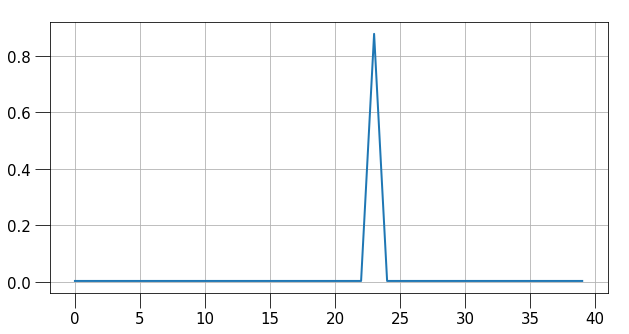

**: rpd[**]: EVENT <UpDown> ** index ** <Broadcast PointToPoint Multicast>
(array([23]),)


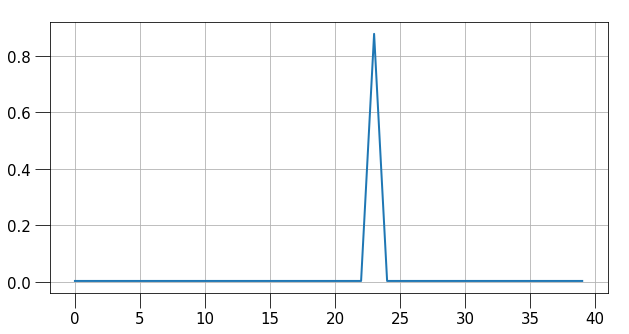

rpd[**]: EVENT <Delete> ** index ** <Broadcast PointToPoint Multicast> address #** **
(array([23]),)


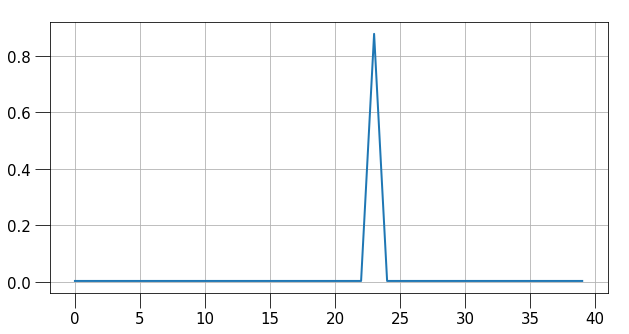

**: rpd[**]: EVENT <Delete> ** index ** <Broadcast Multicast> address #** **
(array([23]),)


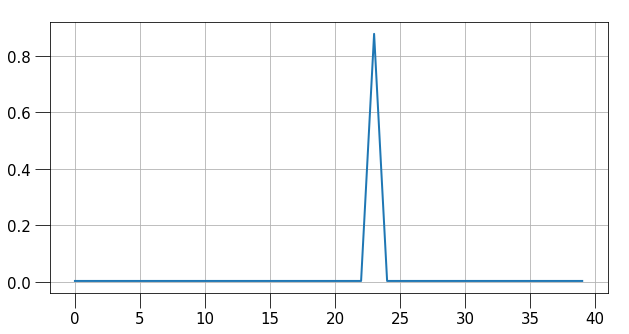

rpd[**]: EVENT <Delete> index ** <Broadcast Multicast> address #** **
(array([23]),)


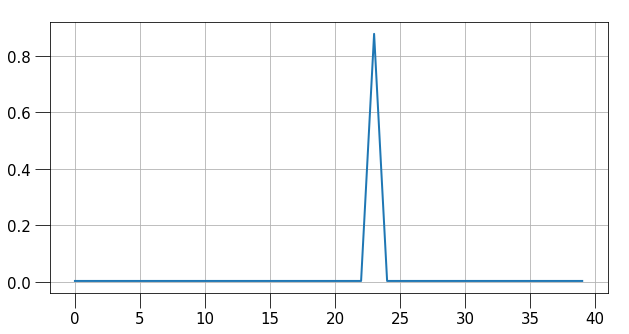

**: rpd[**]: EVENT <Delete> index ** <Broadcast Multicast> address #** **
(array([23]),)


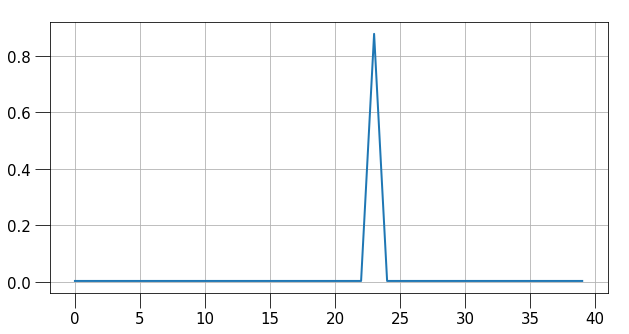

mcsn[**]: EVENT <Delete> index ** <Broadcast Multicast> address #** **
(array([23]),)


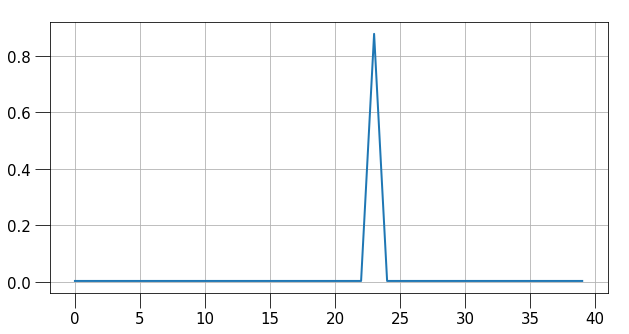

rpd[**]: EVENT <Bandwidth> index ** <Broadcast Multicast> address #** **
(array([23]),)


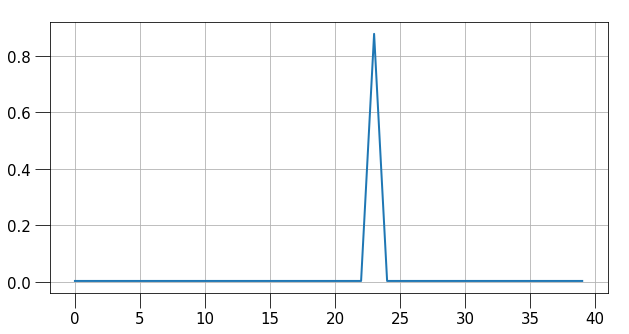

In [478]:
idxs = np.argsort(cos_mat[72])[::-1][:60]

for idx in idxs:
    print(vecs_df["lt"][idx])

    v = np.array([i for i in vecs_df["v"][idx]])
    print(np.where(v>0.08))
    
    plt.figure(figsize=(10,5))
    plt.plot(v)
    plt.grid()
    plt.show()


In [ ]:
plt.style.use('seaborn-colorblind')
plt.style.use('seaborn-whitegrid')
cvs = []

for cat, res in inf_per_cat.items():
    plt.figure(figsize=(15, 5))
    plt.title(cat)
    y = collections.Counter(res)
    y = [y[i] if i in y else 0 for i in range(40)]
    plt.bar(np.arange(40), y, color="#85C1E9")
    plt.xticks(np.arange(40))
    minY = 5 if max(y) < 5 else max(y)+1
    plt.ylim(0, minY)
    plt.show()

    print(np.array(y).std())
    cvs.append((cat, np.array(y).std()/np.array(y).mean()))

- ppe, snmp, l2, ui, pfe, fpc, agg, None

In [ ]:
sorted_t = sorted(cvs, key=lambda x: x[1], reverse=True)

plt.figure(figsize=(15, 5))
plt.title('cv')
plt.bar(np.arange(len(sorted_t)), [i[1] for i in sorted_t], color="#85C1E9")
plt.xticks(np.arange(len(sorted_t)), [i[0] for i in sorted_t],rotation=90)
plt.hlines(3.5, xmin=0, xmax=len(sorted_t), color='red',linestyles='dotted', lw=3)
plt.show()


In [ ]:
cat_per_inf

In [ ]:
y = collections.Counter(res)
y = [y[i] if i in y else 0 for i in inf_per_cat.keys()]
y = np.array(y) / total_per_cat

In [ ]:
## 逆変換

total_per_cat = np.array([len(lt_per_cat[i]) for i in inf_per_cat.keys()])

cat_per_inf = dict()
for i in range(40):
    cat_per_inf[i] = []

for cat, res in inf_per_cat.items():
    for r in res:
        cat_per_inf[r].append(cat)
    
for cat, res in cat_per_inf.items():
    plt.figure(figsize=(15, 5))
    plt.title(cat)
    y = collections.Counter(res)
    y = [y[i] if i in y else 0 for i in inf_per_cat.keys()]
    y = np.array(y) / total_per_cat
    plt.bar(np.arange(len(inf_per_cat)), y, color="#85C1E9")
    plt.xticks(np.arange(len(inf_per_cat)), inf_per_cat.keys(), rotation=90)
    plt.ylabel("#LT/#LT in the cat")
#     minY = 5 if max(y) < 5 else max(y)+1
#     plt.ylim(0, minY)
    plt.ylim(0, 1)
    plt.show()

In [ ]:
lt_per_inf_topic = {}
for i in range(40):
    lt_per_inf_topic[i] = []
    
for ltid, data in raw_lt.items():
    lt = data['lt']
        
    c = list(collections.Counter([word_dict[w] for w in string_to_corpus(lt, max_len=7)]).items())
    topic_dist, word_topic, word_topic_dist = lda[c]
    inf_topic = np.argmax(np.array([t[1] for t in topic_dist]))
    
    lt_per_inf_topic[inf_topic].append((lt, string_to_corpus(lt, max_len=7)))

In [ ]:
for inf_topic, lts in lt_per_inf_topic.items():
    print(inf_topic, inf_topic_words[inf_topic])
    
    for lt in lts:
        print("\t", lt[0], "\t",  lt[1])
    print()

### グラフ生成

- エッジの重みは，GTノードから出ているエッジの，それぞれの発生回数の割合

In [ ]:
inf_per_cat

In [ ]:
G = nx.DiGraph()
nx.set_node_attributes

pos = {}
for i,k in enumerate(inf_per_cat.keys()):
    if 'None' in k:
        pos[k] = (2,i)
    else:
        pos[k] = (0, i)
for i in range(40):
    pos[i] = (1, len(inf_per_cat)/40*i)

for cat, res in inf_per_cat.items():
    if cat not in G.nodes:
        G.add_node(cat)
        
    col = collections.Counter(res) # dstの集計
    total = sum(col.values())
    for dst, weight in col.items():
        if dst not in G.nodes:
            G.add_node(dst)
        G.add_edge(cat, dst, weight=weight/total)
        
for n, p in pos.items():
    G.node[n]['pos'] = p

In [ ]:
for a in G.edges(data=True):
    print(a)

In [ ]:
inf_node_edge_weight = dict()
for a,b in G.edges.items():
    if 'None'  in a[0]:
            if a[1] in inf_node_edge_weight:
                inf_node_edge_weight[a[1]] += 0
            else:
                inf_node_edge_weight[a[1]] = 0
        
    if a[1] in inf_node_edge_weight:
        inf_node_edge_weight[a[1]] += b['weight']
    else:
        inf_node_edge_weight[a[1]] = b['weight']
        
        
# edge_size = [i[2]['weight']*2 for i in G.edges(data=True)]
# edge_size = [1 if i[2]['weight']==1.0  else 0 for i in G.edges(data=True)]
# edge_size = [i[2]['weight'] if i[2]['weight']>0.55 else 0  for i in G.edges(data=True)]
edge_size = [i[2]['weight'] if "None" not in i[0] else -1 for i in G.edges(data=True)]

In [ ]:
x = collections.Counter([int(e*1000)/10 for e in edge_size])
plt.figure(figsize=(10, 5))
plt.bar(x.keys(), x.values())
plt.title("Edge weights distribution")
plt.xlabel("%")
plt.ylabel("#edges")
plt.xticks([i for i in range(0, 100, 10)])
plt.show()

In [ ]:
x = collections.Counter([int(e*1000)/10 for e in edge_size])

# remove -100% data
x = sorted(x.items(), key=lambda x:x[0])
x[0] = (0., 0)

plt.figure(figsize=(10, 5))
plt.bar([i[0] for i in x], [i[1] for i in x])
plt.title("Edge weights distribution (without 'None')")
plt.xlabel("%")
plt.ylabel("#edges")
plt.xticks([i for i in range(0, 100, 10)])
plt.ylim(0, 30)
plt.show()

In [ ]:
print('All edges:', len(G.edges()))

print('Without None:', len([(k,v) for k,v in G.edges.items() if 'None' not in k[0]]))

In [ ]:
# エッジ1本のみ
for i in np.where(np.array(edge_size)==1)[0]:
    print(list(G.edges())[i], "\t", edge_size[i])
    
print()
for i in np.where(np.array(edge_size)>0.55)[0]:
    print(list(G.edges())[i], "\n\t", edge_size[i], len(lt_per_cat[list(G.edges())[i][0]]))

In [ ]:
plt.figure(figsize=(20, 30))
node_size = [20 if type(g) == str else inf_node_edge_weight[g]*500 for g in G.nodes]
nx.draw_networkx(G, pos, node_color='b', alpha=0.6, node_size=node_size, width=edge_size, edge_color='g')

plt.show()

# nx.draw_networkx_labels(G, pos, fontsize=14, font_family="Yu Gothic", font_weight="bold")

# edge_width = [ d['weight']*0.2 for (u,v,d) in G.edges(data=True)]
# nx.draw_networkx_edges(G, pos, alpha=0.4, edge_color='C', width=edge_width)

# plt.axis('off')
# plt.savefig("g2.png")
# plt.show()

### 集計結果

- gtのカテゴリごとに，どのトピックが振られたかを確認
    - カテゴリとトピックのそれらしい対応をつけて見た
    - 複数マージされるものと，対応づけられなかったものが存在
- 訓練じはUIの単語を含むものは除外したが，評価じは全て含めた
- gt通りにうまくいったものは存在

## VyOS

In [ ]:
with open("./vyos_logs/tpl_all_uniq", "r") as f:
    raw_vyos = f.readlines()

In [ ]:
corpus = []
for lt in raw_vyos:
    words = [remove_symbols(t) for t in lt.split()]
    split_words = []
    for w in words:
        if len(w.split()) > 1: # さらに分割できる場合
            split_words.extend(w.split())
        else:
            split_words.append(w)
    split_words = [t.lower() for t in split_words if t != '']
    corpus.append(split_words)

In [ ]:
all_words = list(set([word for words in corpus for word in words]))
word_dict = {w:i for i, w in enumerate(all_words)}
inv_word_dict = {v:k for k,v in word_dict.items()}

corpus = []
for lt in raw_vyos:
    words = [remove_symbols(t) for t in lt.split()]
    split_words = []
    for w in words:
        if len(w.split()) > 1: # さらに分割できる場合
            split_words.extend(w.split())
        else:
            split_words.append(w)
    split_words = [t.lower() for t in split_words if t != '']
    
    split_words = [w for w in split_words]

    split_words = split_words[:7] # 前方のみ残す

    lt_word_id_cnt = collections.Counter([word_dict[w] for w in split_words])

    corpus.append([(tid, cnt) for tid, cnt in lt_word_id_cnt.items()])

In [ ]:
# 単語のカウント
word_cnt = {}
for wid, cnt in sorted(collections.Counter([c[0] for s in corpus for c in s]).items(), key= lambda x: x[1])[::-1]:
    print(inv_word_dict[wid], cnt)
    word_cnt[inv_word_dict[wid]] = cnt

In [ ]:
# LTレベルの共起
cor_df = pd.DataFrame(index=np.arange(len(word_dict)), columns=np.arange(len(word_dict)), dtype=int)
cor_df = cor_df.fillna(0)

for s in corpus:
    for a,b in itertools.combinations(s, 2):
        ida = int(a[0])
        idb = int(b[0])
        cor_df[ida][idb] += 1
        cor_df[idb][ida] += 1

cor_list = []
for a,b in itertools.combinations(np.arange(len(word_dict)), 2):
    if cor_df[a][b] != 0 :
        cor_list.append([(a, b) , cor_df[a][b]])
        
# for i in tqdm.tqdm(sorted(cor_list, key=lambda x:x[1], reverse=True)):
#     a,b = i[0]
#     print(inv_word_dict[a], inv_word_dict[b], i[1])
#     print("\t simpson:", i[1]/min(word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]]))
#     print("\t jaccard:", i[1]/(word_cnt[inv_word_dict[a]] + word_cnt[inv_word_dict[b]] - i[1]))
#     print()

In [ ]:
word_dict['failed']

In [ ]:
cor_df[315].sum()

In [ ]:
plot_data = [i[1] for i in sorted(cor_list, key=lambda x:x[1], reverse=True)][1000:2000]
plt.figure(figsize=(15, 15))
plt.bar(np.arange(len(plot_data)), plot_data)
plt.grid()
plt.show()

In [ ]:
G = nx.DiGraph()
nx.set_node_attributes

for i in sorted(cor_list, key=lambda x:x[1], reverse=True):
    if i[1] > 50: # 共起がn回以上
        a,b = i[0]
        
        if inv_word_dict[a] == 'failed' or inv_word_dict[a] == 'cant' or inv_word_dict[b] == 'failed' or inv_word_dict[b] == 'cant':
            continue
            
        simpson = i[1]/min(word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]])
        jaccard = i[1]/(word_cnt[inv_word_dict[a]] + word_cnt[inv_word_dict[b]] - i[1])
        
        print(simpson)
        if simpson > 0.95:
            if a not in G.nodes:
                G.add_node(inv_word_dict[a])

            if b not in G.nodes:
                G.add_node(inv_word_dict[b])

            src = inv_word_dict[a] if np.argmin([word_cnt[inv_word_dict[a]], word_cnt[inv_word_dict[b]]]) == 0 else inv_word_dict[b]
            dst = inv_word_dict[a] if src == inv_word_dict[b] else inv_word_dict[b]
            G.add_edge(src, dst, weight=jaccard)

In [ ]:
json_data = nx.node_link_data(G)
f = open("./d3_test/vyos_nx.json", "w")
json.dump(json_data, f, ensure_ascii=False, indent=4, sort_keys=True, separators=(',', ': '))
f.close()

In [ ]:
plt.figure(figsize=(13, 13))
nx.draw_networkx(G, pos=nx.shell_layout(G))
plt.show()

## LDA

### full length

In [ ]:
for cat, lts in lt_per_cat.items():
    print(cat)

In [ ]:
tmp = []
eval_corpus = []
eval_corpus_ltids = []
for ltid, i in enumerate(corpus):
    if word_dict['ui'] not in [j[0] for j in i]: # uiを弾く(550番)
        tmp.append(tuple(sorted(i)))
        eval_corpus.append(i)
        eval_corpus_ltids.append(ltid)
    
print(len(tmp))
set_corpus = list(set(tmp))

In [ ]:
corpus

In [ ]:
lda = gensim.models.ldamodel.LdaModel(
                                      #corpus=corpus, 
                                      corpus=set_corpus,
                                      chunksize=10,
                                      num_topics=40, 
                                      id2word=inv_word_dict, 
                                      minimum_probability=1e-8, 
                                      #gamma_threshold=1e-5,
                                      #eval_every=10,
                                      iterations=100,
#                                       alpha='auto', 
#                                       eta='auto', 
                                      decay=1.0,
                                      passes=1,
                                      per_word_topics=True)

In [ ]:
results =  [np.argmax(l) for l in lda.inference(eval_corpus)[0]]

inference_results = {}
for a,b in zip(eval_corpus, results):
    if b in inference_results:
        inference_results[b].append([inv_word_dict[c[0]] for c in a])
    else:
        inference_results[b] = [[inv_word_dict[c[0]] for c in a]]

In [ ]:
for topic in range(lda.num_topics):
    print(topic, [inv_word_dict[i[0]] for i in lda.get_topic_terms(topic)])
# print('1', [inv_word_dict[i[0]] for i in lda.get_topic_terms(1)])

In [ ]:
inf_ltids = {}
for ltid, inf_cat in results.items():
    if inf_cat in inf_ltids:
        inf_ltids[inf_cat].append(ltid)
    else:
        inf_ltids[inf_cat] = [ltid]

In [ ]:
for inf_cat, ltids in inf_ltids.items():
    print("topic:", inf_cat)
    for i in ltids:
        print(raw_lt[str(i)]['lt'])
    print()

### eval

- 外れたやつについて，調査

In [ ]:
compared_results = {}
for inf_cat, ltids in inf_ltids.items():
    for ltid in ltids:
        true_cat = raw_lt[str(ltid)]['cat']
        if true_cat in compared_results:
            compared_results[true_cat].append((ltid, inf_cat))
        else:
            compared_results[true_cat] = [(ltid, inf_cat)]

In [ ]:
for cat, res in compared_results.items():
    plt.figure(figsize=(15, 5))
    plt.title(cat)
    y = collections.Counter([r[1] for r in res])
    y = [y[i] if i in y else 0 for i in range(40)]
#     print(collections.Counter([r[1] for r in res]), y)
    plt.bar(np.arange(40), y)
    plt.show()